In [218]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from torchvision import datasets
from scipy.stats import gaussian_kde

## Generator

#### Original VAE

In [221]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class VAE(nn.Module):
    def __init__(self, z_dim=256, im_chan=2, mu_h=None, std_h=None):
        super(VAE, self).__init__()
        self.z_dim = z_dim
        self.hidden_dim = int(z_dim // 8)
        self.mu_h = mu_h
        self.std_h = std_h

        # Encoder
        self.encoder = nn.Sequential(
            self.make_encoder_block(im_chan, self.hidden_dim * 2, kernel_size=4, stride=2, padding=1),  # (2, 8, 32) -> (hidden * 2, 4, 16)
            self.make_encoder_block(self.hidden_dim * 2, self.hidden_dim * 4, kernel_size=4, stride=2, padding=1),  # (hidden * 2, 4, 16) -> (hidden * 4, 2, 8)
            self.make_encoder_block(self.hidden_dim * 4, self.hidden_dim * 8, kernel_size=4, stride=2, padding=1),  # (hidden * 4, 2, 8) -> (hidden * 4, 1, 4)
            self.make_encoder_block(self.hidden_dim * 8, self.hidden_dim * 16, kernel_size=4, stride=2, padding=1),  # (hidden * 4, 2, 8) -> (hidden * 4, 1, 4)
        )

        # Decoder
        self.decoder = nn.Sequential(
            self.make_decoder_block(self.hidden_dim * 16, self.hidden_dim * 8, kernel_size=4, stride=2, padding=1),
            self.make_decoder_block(self.hidden_dim * 8, self.hidden_dim * 4, kernel_size=4, stride=2, padding=1),  # (hidden * 4, 1, 4) -> (hidden * 4, 2, 8)
            self.make_decoder_block(self.hidden_dim * 4, self.hidden_dim * 2, kernel_size=4, stride=2, padding=1),  # (hidden * 4, 2, 8) -> (hidden * 2, 4, 16)
            self.make_decoder_block(self.hidden_dim * 2, im_chan, kernel_size=4, stride=2, padding=1, final_layer=True),  # (hidden * 2, 4, 16) -> (2, 8, 32)
        )

    def make_encoder_block(self, input_channels, output_channels, kernel_size=4, stride=2, padding=1, final_layer=False):
        return nn.Sequential(
            nn.Conv2d(input_channels, output_channels, kernel_size, stride, padding),
            nn.BatchNorm2d(output_channels),
            nn.LeakyReLU(0.2, inplace=True),
        )

    def make_decoder_block(self, input_channels, output_channels, kernel_size=4, stride=2, padding=1, final_layer=False):
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride, padding),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride, padding),
                nn.Tanh(),  # Output in the range [-1, 1]
            )

    def encode(self, x):
        output_encoder = self.encoder(x)
        output_encoder = output_encoder.view(output_encoder.size(0), -1)
        return output_encoder

    def reparameterize(self, output_encoder):
        
        if isinstance(self.mu_h, torch.Tensor) and isinstance(self.std_h, torch.Tensor):
            z_latent = self.mu_h + output_encoder * self.std_h
        else:
            z_latent = output_encoder
        return z_latent


    def decode(self, z):
        h = z.view(z.size(0), -1, 2, 2)
        return self.decoder(h)

    def forward(self, x, *args):
        output_encoder = self.encode(x)

        z = self.reparameterize(output_encoder)

        return self.decode(z), z, z, (z, output_encoder)


In [222]:
from torchsummary import summary

vae = VAE(z_dim=256).cuda()

summary(vae, (2, 32, 32))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 16, 16]           2,112
       BatchNorm2d-2           [-1, 64, 16, 16]             128
         LeakyReLU-3           [-1, 64, 16, 16]               0
            Conv2d-4            [-1, 128, 8, 8]         131,200
       BatchNorm2d-5            [-1, 128, 8, 8]             256
         LeakyReLU-6            [-1, 128, 8, 8]               0
            Conv2d-7            [-1, 256, 4, 4]         524,544
       BatchNorm2d-8            [-1, 256, 4, 4]             512
         LeakyReLU-9            [-1, 256, 4, 4]               0
           Conv2d-10            [-1, 512, 2, 2]       2,097,664
      BatchNorm2d-11            [-1, 512, 2, 2]           1,024
        LeakyReLU-12            [-1, 512, 2, 2]               0
  ConvTranspose2d-13            [-1, 256, 4, 4]       2,097,408
      BatchNorm2d-14            [-1, 25

## Discriminator

In [223]:
import torch
import torch.nn as nn

class Critic(nn.Module):
    def __init__(self, im_chan=2, hidden_dim=64):
        super(Critic, self).__init__()
        self.critic = nn.Sequential(
            self.make_critic_block(im_chan, hidden_dim, kernel_size=4, stride=2, padding=1),     # 2x32x32 -> 64x16x16
            self.make_critic_block(hidden_dim, hidden_dim * 2, kernel_size=4, stride=2, padding=1), # 64x16x16 -> 128x8x8
            self.make_critic_block(hidden_dim * 2, hidden_dim * 4, kernel_size=4, stride=2, padding=1),  # 128x8x8 -> 256x4x4
        )
        self.avg_pool = nn.AdaptiveAvgPool2d((1, 1))
        self.fc = nn.Linear(hidden_dim * 4, 1)

    def make_critic_block(self, input_channels, output_channels, kernel_size=4, stride=2, padding=1):
        return nn.Sequential(
            nn.Conv2d(input_channels, output_channels, kernel_size, stride, padding),
            nn.BatchNorm2d(output_channels),
            nn.LeakyReLU(0.2, inplace=True),
        )

    def forward(self, image):
        critic_pred = self.critic(image)
        critic_pred = self.avg_pool(critic_pred)
        critic_pred = critic_pred.view(critic_pred.size(0), -1)
        critic_pred = self.fc(critic_pred)
        return critic_pred

In [224]:
from torchsummary import summary

d_1 = Critic().cuda()
summary(d_1, (2, 32, 32))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 16, 16]           2,112
       BatchNorm2d-2           [-1, 64, 16, 16]             128
         LeakyReLU-3           [-1, 64, 16, 16]               0
            Conv2d-4            [-1, 128, 8, 8]         131,200
       BatchNorm2d-5            [-1, 128, 8, 8]             256
         LeakyReLU-6            [-1, 128, 8, 8]               0
            Conv2d-7            [-1, 256, 4, 4]         524,544
       BatchNorm2d-8            [-1, 256, 4, 4]             512
         LeakyReLU-9            [-1, 256, 4, 4]               0
AdaptiveAvgPool2d-10            [-1, 256, 1, 1]               0
           Linear-11                    [-1, 1]             257
Total params: 659,009
Trainable params: 659,009
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.01
Forward/

## Loss function


In [225]:
def l2_loss(fake, real):
    return torch.norm(fake - real, p=2)

In [226]:
# Assuming the VAE loss function is defined as follows:
def vae_loss(recon_x, x, latent_vector, *args):
    recon_loss = l2_loss(recon_x, x)

    # KL divergence formula between two Gaussians
    var_l = latent_vector.var(axis=0)
    mu_l = latent_vector.mean(axis=0)
    var_h = STD_H ** 2
    mu_h = MU_H
    kl_div = 0.5 * torch.sum(
        torch.log(var_h / var_l) + (var_l + (mu_l - mu_h).pow(2)) / var_h - 1
    )
    return recon_loss + 0.1 * kl_div, recon_loss, kl_div



## Initial Process

### Hyperarameters

In [227]:
n_epochs = 100
z_dim = 256
batch_size = 256
lr = 0.002
betas = (0.5, 0.999)
c_lambda = 10
critic_repeats = 3
device = 'cuda'
n_workers = 4

### Dataset

In [229]:
import gdown
import pickle

def download_and_load_pkl(url, output='output.pkl'):
    # Download the pickle file from Google Drive
    gdown.download(url, output, quiet=False)

    # Load the pickle file
    with open(output, 'rb') as f:
        data = pickle.load(f)

    return data

In [231]:
# channel sionna, pilot sionna 20000 samples with the same topology 4 ant
channels = download_and_load_pkl('https://drive.google.com/uc?export=download&id=1OwPoI-pQjuNvDmxhGHkBAweRnR73zwcv', output='channels_res.pkl')
responses = download_and_load_pkl('https://drive.google.com/uc?export=download&id=1lMpM8LJldgIDlXwqaPyg_YFte_bIs80x', output='y_res.pkl')

Downloading...
From (original): https://drive.google.com/uc?export=download&id=1OwPoI-pQjuNvDmxhGHkBAweRnR73zwcv
From (redirected): https://drive.google.com/uc?export=download&id=1OwPoI-pQjuNvDmxhGHkBAweRnR73zwcv&confirm=t&uuid=fe344e99-7dfa-459f-8fd7-7f1d7c9f6094
To: /kaggle/working/channels_res.pkl
100%|██████████| 328M/328M [00:01<00:00, 226MB/s] 
Downloading...
From (original): https://drive.google.com/uc?export=download&id=1lMpM8LJldgIDlXwqaPyg_YFte_bIs80x
From (redirected): https://drive.google.com/uc?export=download&id=1lMpM8LJldgIDlXwqaPyg_YFte_bIs80x&confirm=t&uuid=b8c28b62-1aa5-461c-b432-34a6cbca3392
To: /kaggle/working/y_res.pkl
100%|██████████| 328M/328M [00:01<00:00, 231MB/s] 


In [234]:
channels.shape

(20000, 4, 8, 32, 2)

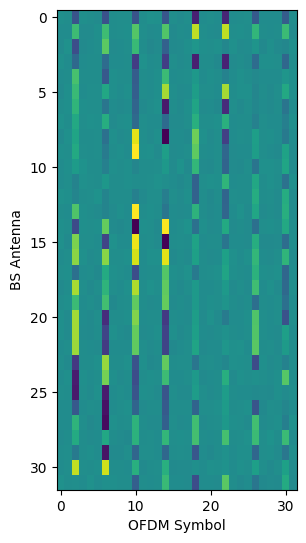

In [235]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(3, 6))  # Adjust the figsize to make the plot height much greater than the width

# Assuming x_signal is a 2D array
# Display the array as an image
plt.imshow(responses[0].reshape(-1, 32, 2).transpose(1,0,2)[:,:,0], cmap='viridis', aspect='auto')
# Set labels for the axes
plt.xlabel('OFDM Symbol')
plt.ylabel('BS Antenna')
# Adjust subplot parameters to fit the figure area
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

# Show the plot
plt.show()

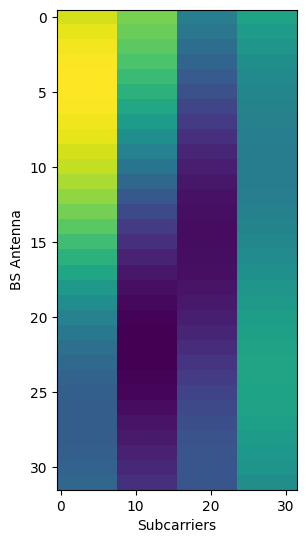

In [236]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(3, 6))  # Adjust the figsize to make the plot height much greater than the width

# Assuming x_signal is a 2D array
# Display the array as an image
plt.imshow(channels[1].reshape(-1, 32, 2).transpose(1,0,2)[:,:,0], cmap='viridis', aspect='auto')
# Set labels for the axes
plt.xlabel('Subcarriers')
plt.ylabel('BS Antenna')
# Adjust subplot parameters to fit the figure area
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

# Show the plot
plt.show()

In [237]:
import torch
import torchvision.transforms as transforms
from torch.utils.data.dataloader import DataLoader
import numpy as np


class ChannelsData(torch.utils.data.Dataset):
    def __init__(
        self, channels_res: np.ndarray, y_res: np.ndarray, type_data: str = "train"
    ):
        self.len_dataset = channels_res.shape[0]

        self.transform_channel = transforms.Compose(
            [
                transforms.ToTensor(),
            ]
        )
        self.transform_y_signal = transforms.Compose(
            [
                transforms.ToTensor(),
            ]
        )
        ratio = 4/5  # Using 0.8 instead of 4/5 for better readability
        eval_ratio = 0.5  # Ratio for splitting the remaining data between eval and test

        if type_data == "train":
            # Get first 80% of data for training
            self.channels_res = channels_res[:int(self.len_dataset * ratio)]
            self.y_res = y_res[:int(self.len_dataset * ratio)]
        elif type_data == "eval":
            # Get first half of remaining 10% for evaluation
            start_idx = int(self.len_dataset * ratio)
            end_idx = start_idx + int(self.len_dataset * (1 - ratio) * eval_ratio)
            self.channels_res = channels_res[start_idx:end_idx]
            self.y_res = y_res[start_idx:end_idx]
        else:  # test data
            # Get second half of remaining 10% for testing
            start_idx = int(self.len_dataset * ratio) + int(self.len_dataset * (1 - ratio) * eval_ratio)
            self.channels_res = channels_res[start_idx:]
            self.y_res = y_res[start_idx:]

    def preprocess_response(self, y_res):
        normalized_y_res = np.zeros_like(y_res)
        for i in range(len(y_res)):
            y_res_i = y_res[i]
            y_res_i = (y_res_i - y_res_i.min()) / (y_res_i.max() - y_res_i.min())
            y_res_i = 2 * y_res_i - 1
            normalized_y_res[i] = y_res_i


        normalized_y_res = normalized_y_res.reshape(32, 32, 2).transpose(1,0,2)
        return normalized_y_res

    def preprocess_channel(self, channel_res):
        normalized_channel_res = np.zeros_like(channel_res)
        for i in range(len(channel_res)):
            channel_res_i = channel_res[i]
            channel_res_i = (channel_res_i - channel_res_i.min()) / (channel_res_i.max() - channel_res_i.min())
            channel_res_i = 2 * channel_res_i - 1
            normalized_channel_res[i] = channel_res_i

        normalized_channel_res = normalized_channel_res.reshape(32, 32, 2).transpose(1,0,2)
        return normalized_channel_res

    def __getitem__(self, item):
        channel_res = self.channels_res[item]
        y_res = self.y_res[item]

        channel_res = self.preprocess_channel(channel_res)
        y_res = self.preprocess_response(y_res)

        item_channel_res = torch.FloatTensor(channel_res).permute(2, 0, 1)
        item_y_res = torch.FloatTensor(y_res).permute(2, 0, 1)

        return item_channel_res, item_y_res

    def __len__(self):
        return len(self.channels_res)


class ChannelDataloader:
    def __init__(
        self,
        channels_res: np.ndarray,
        y_res: np.ndarray,
        batch_size: int = 64,
        pin_memory: bool = False,
        num_worker: int = 1,
    ):
        self.channels_res = channels_res
        self.y_res = y_res
        self.batch_size = batch_size
        self.pin_memory = pin_memory
        self.num_worker = num_worker

    def train_dataloader(self):
        return DataLoader(
            ChannelsData(
                channels_res=self.channels_res,
                y_res=self.y_res,
                type_data="train",
            ),
            batch_size=self.batch_size,
            pin_memory=self.pin_memory,
            shuffle=True,
            num_workers=self.num_worker,
        )

    def test_dataloader(self):
        return DataLoader(
            ChannelsData(
                channels_res=self.channels_res,
                y_res=self.y_res,
                type_data="test",
            ),
            batch_size=1,
            pin_memory=self.pin_memory,
            num_workers=self.num_worker,
            shuffle=False,
        )

    def eval_dataloader(self):
        return DataLoader(
            ChannelsData(
                channels_res=self.channels_res,
                y_res=self.y_res,
                type_data="eval",
            ),
            batch_size=1,
            pin_memory=self.pin_memory,
            num_workers=self.num_worker,
            shuffle=True,
        )


In [238]:
dataloader = ChannelDataloader(
    y_res=responses, channels_res=channels, batch_size=batch_size, num_worker=n_workers
)
train_dataset = dataloader.train_dataloader()
eval_dataset = dataloader.eval_dataloader()

In [239]:
# Compute the mean and std across the first dimension (axis=0)
MU_H = train_dataset.dataset.channels_res.mean(axis=0).reshape(-1)  # Shape: (2*8*32,)
STD_H = train_dataset.dataset.channels_res.std(axis=0).reshape(-1)  # Shape: (2*8*32,)

MU_H = torch.from_numpy(MU_H).float().to(device)
STD_H = torch.from_numpy(STD_H).float().to(device)

### Model

Each model, we need to initialize weighs which help model converge faster, and prevent the vanishing and exploding gradient at eh first time .

In [240]:
def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)

### Visualization

In [241]:
def show_tensor_images(image_tensor):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_grid = image_tensor.detach().cpu()
    plt.imshow(image_grid.squeeze())
    plt.show()
    plt.close()

def show_loss_images(c_losses = None, g_losses = None):
    plt.figure(figsize=(10, 5))
    if c_losses:
      plt.plot(c_losses, label="Discriminator Loss", linestyle='-', linewidth=2)
    if g_losses:
      plt.plot(g_losses, label="Generator Loss", linestyle='-', linewidth=2)
    plt.title("GAN Training Losses")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
    plt.close()


def show_nmse(nmse_scores):
    plt.figure(figsize=(10, 5))
    plt.plot(range(len(nmse_scores)), nmse_scores, marker='o', linestyle='-', color='b', label='NMSE')
    plt.title('Normalized Mean Squared Error (NMSE) vs Prediction Set', fontsize=14)
    plt.xlabel('Prediction Set', fontsize=12)
    plt.ylabel('NMSE', fontsize=12)
    plt.grid(True)
    plt.legend()
    plt.show()
    plt.close()

In [242]:
import os
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde


def plot_distribution(
    c_real,
    c_fake,
    g_fake,
    c_real_threshold=None,
    c_fake_threshold=None,
    g_fake_threshold=None,
    save_path=None,
):
    # Create a figure with two subplots
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 12))

    # Histogram plot
    ax1.hist(c_real, bins=30, alpha=0.5, label="Real Critic")
    ax1.hist(c_fake, bins=30, alpha=0.5, label="Fake Critic")
    ax1.hist(g_fake, bins=30, alpha=0.5, label="Fake Generator")
    if c_real_threshold:
        ax1.axvline(
            c_real_threshold,
            color="r",
            linestyle="--",
            label="Threshold for Real Critic",
        )
    if c_fake_threshold:
        ax1.axvline(
            c_fake_threshold,
            color="g",
            linestyle="--",
            label="Threshold for Fake Critic",
        )
    if g_fake_threshold:
        ax1.axvline(
            g_fake_threshold,
            color="b",
            linestyle="--",
            label="Threshold for Fake Generator",
        )
    ax1.set_title("Histogram of Distributions with Thresholds")
    ax1.set_xlabel("Value")
    ax1.set_ylabel("Frequency")
    ax1.legend()

    # KDE plot
    kde_c_real = gaussian_kde(c_real)
    kde_c_fake = gaussian_kde(c_fake)
    kde_g_fake = gaussian_kde(g_fake)

    x_range = np.linspace(
        min(c_real.min(), c_fake.min(), g_fake.min()),
        max(c_real.max(), c_fake.max(), g_fake.max()),
        200,
    )

    ax2.plot(x_range, kde_c_real(x_range), label="Real Critic")
    ax2.plot(x_range, kde_c_fake(x_range), label="Fake Critic")
    ax2.plot(x_range, kde_g_fake(x_range), label="Fake Generator")
    if c_real_threshold:
        ax1.axvline(
            c_real_threshold,
            color="r",
            linestyle="--",
            label="Threshold for Real Critic",
        )
    if c_fake_threshold:
        ax1.axvline(
            c_fake_threshold,
            color="g",
            linestyle="--",
            label="Threshold for Fake Critic",
        )
    if g_fake_threshold:
        ax1.axvline(
            g_fake_threshold,
            color="b",
            linestyle="--",
            label="Threshold for Fake Generator",
        )
    ax2.set_title("Kernel Density Estimation of Distributions with Thresholds")
    ax2.set_xlabel("Value")
    ax2.set_ylabel("Density")
    ax2.legend()

    plt.tight_layout()

    # save file
    if save_path:
        if not os.path.exists(save_path):
            os.makedirs(os.path.dirname(save_path), exist_ok=True)
        plt.savefig(save_path)

    plt.show()
    plt.close()

In [243]:
def plot_vae_in_out(input_tensor, output, z, encoder_output, true_output):
    # Convert to numpy arrays
    encoder_input_np = input_tensor.detach().cpu().numpy().flatten()
    encoder_output_np = encoder_output.detach().cpu().numpy().flatten()
    decoder_input_np = z.detach().cpu().numpy().flatten()
    decoder_output_np = output.detach().cpu().numpy().flatten()
    true_output_np = true_output.detach().cpu().numpy().flatten()

    # Create a figure with five subplots in a single row
    fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1, 5, figsize=(20, 4))
    fig.patch.set_facecolor('#2F2F2F')

    # Define the data and labels for each subplot
    data = [encoder_input_np, encoder_output_np, decoder_input_np, decoder_output_np, true_output_np]
    titles = ["Encoder Input", "Encoder Output", "Decoder Input (Latent Space)", "Decoder Output", "True Output"]
    shapes = [input_tensor.shape, encoder_output.shape, z.shape, output.shape, true_output.shape]
    colors = ['cyan', 'magenta', 'yellow', 'green', 'red']
    axes = [ax1, ax2, ax3, ax4, ax5]

    for ax, d, title, shape, color in zip(axes, data, titles, shapes, colors):
        kde = gaussian_kde(d)
        x_range = np.linspace(d.min(), d.max(), 200)

        ax.plot(x_range, kde(x_range), color=color)
        ax.fill_between(x_range, kde(x_range), alpha=0.5, color=color)

        ax.set_title(f"{title}\nShape: {shape}", color='white', fontsize=16)
        ax.set_xlabel("Value", color='white', fontsize=12)
        ax.set_ylabel("Density", color='white', fontsize=12)

        ax.grid(color='gray', linestyle='--', alpha=0.3)
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_color('white')
        ax.spines['left'].set_color('white')
        ax.tick_params(colors='white')

    plt.tight_layout()
    plt.show()
    plt.close()


In [244]:
import os

import matplotlib.pyplot as plt
import numpy as np


def plot_generated_image(prediction, test_input, tar, t=0, prefix: str = "wgan"):

    test_input = test_input.cpu().detach().numpy().squeeze()
    prediction = prediction.cpu().detach().numpy().squeeze()
    tar = tar.cpu().detach().numpy().squeeze()

    display_list = [
        np.squeeze(test_input),
        np.squeeze(tar),
        np.squeeze(prediction),
    ]
    title = ["Input Y", "Target H", "Prediction H"]

    for i in range(3):
        plt.subplot(1, 3, i + 1)
        plt.title(title[i])
        plt.imshow(display_list[i])
        plt.axis("off")

    img_path = os.path.join("results/generated_img", prefix, "img_" + str(t) + ".png")

    if not os.path.exists(img_path):
        os.makedirs(os.path.dirname(img_path), exist_ok=True)
    plt.savefig(img_path)
    plt.close()


def plot_skewness_func(skewness_scores, epochs, img_path):
    # # Plot the loss curves
    plt.figure(figsize=(10, 6))
    plt.plot(epochs, skewness_scores, label="Target")
    plt.xlabel("Epoch")
    plt.ylabel("Skewness distances")
    plt.title("Skewness Loss")
    plt.legend()
    if not os.path.exists(img_path):
        os.makedirs(os.path.dirname(img_path), exist_ok=True)
    plt.savefig(img_path)
    plt.close()
    # plt.show()

def plot_nmse_func(mse_scores, epochs, img_path):
    # # Plot the loss curves
    plt.figure(figsize=(10, 6))
    plt.plot(epochs, mse_scores, label="Target")
    plt.xlabel("Epoch")
    plt.ylabel("MSE")
    plt.title("MSE Scores")
    plt.legend()
    if not os.path.exists(img_path):
        os.makedirs(os.path.dirname(img_path), exist_ok=True)
    plt.savefig(img_path)
    plt.close()
    # plt.show()


def plot_loss_func(losses_d = None, losses_g = None, epochs = None, img_path = None):
    # # Plot the loss curves
    plt.figure(figsize=(10, 6))
    if losses_d:
      plt.plot(epochs, losses_d, label="Discriminator Loss")
    if losses_g:
      plt.plot(epochs, losses_g, label="Generator Loss")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.title("Loss Curves")
    plt.legend()

    if not os.path.exists(img_path):
        os.makedirs(os.path.dirname(img_path), exist_ok=True)
    plt.savefig(img_path)
    plt.close()
    # plt.show()

#### Discriminator Activation Mapping

In [245]:
import os
import numpy as np
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable


class Hook:
    def __init__(self, module):
        self.stored = None
        module.register_forward_hook(self.hook_fn)

    def hook_fn(self, module, input, output):
        # Store the forward activations
        self.stored = output.detach()


class HookBwd:
    def __init__(self, module):
        self.stored = None
        module.register_full_backward_hook(self.hook_fn)

    def hook_fn(self, module, grad_input, grad_output):
        # Store the gradients during the backward pass
        self.stored = grad_output[0].detach()


class GradCam:
    def __init__(self, model, conv_layer):
        self.model = model

        self.hook_activation = Hook(conv_layer)
        self.hook_gradient = HookBwd(conv_layer)

    def compute_activation_map(self, image):

        output = self.model(image)

        # because in our case ciritic is a single value so it is not possible to get the target class
        output.backward()

        # Retrieve stored activations and gradients
        activations = self.hook_activation.stored
        gradients = self.hook_gradient.stored

        # get importance weights of the gradients
        importance_weights = gradients.mean(dim=[2, 3], keepdim=True)

        # Multiply the importance weights with the activations
        weighted_activations = (
            importance_weights * activations
        )  # Element-wise multiplication

        # Get activation map by summing the weighted activations
        activation_map = weighted_activations.sum(dim=1)

        # Apply ReLU to remove negative values
        activation_map = F.relu(activation_map)

        # normalize the activation map
        activation_map = activation_map.cpu().detach().numpy()  # Convert to numpy
        activation_map = (activation_map - activation_map.min()) / (
            activation_map.max() - activation_map.min()
        )  # Normalize

        return activation_map

    def visualize_cam(self, image, save_path=None):
        # Compute the activation map
        activation_map = self.compute_activation_map(image)

        # Get the first image and activation map
        activation_map = activation_map.squeeze(0)
        image = image.squeeze(0)

        # Normalize the image
        image = (
            image.cpu().numpy().transpose(1, 2, 0)
        )  # Shape: [height, width, channels]
        image = (image - image.min()) / (image.max() - image.min())

        real_image = image[:, :, 0]


        # Plot the images side by side
        fig, axs = plt.subplots(1, 3, figsize=(12, 6))

        # Plot the original image
        axs[0].imshow(real_image, alpha=0.9,)
        axs[0].axis("off")
        axs[0].set_title("Input Image")

        # Plot heatmap
        im = axs[1].imshow(
            activation_map,
            alpha=0.4,
            cmap="jet",
            extent=(0, image.shape[1], image.shape[0], 0),
            interpolation="bilinear",
        )
        axs[1].axis("off")
        axs[1].set_title("Activation Map")

        # Plot the overlay image
        axs[2].imshow(
            real_image, aspect="auto", alpha=0.9
        )  # Set higher alpha for real_image
        axs[2].imshow(
            activation_map,
            alpha=0.6,
            cmap="jet",
            extent=(0, image.shape[1], image.shape[0], 0),
            interpolation="bilinear",
        )
        axs[2].axis("off")
        axs[2].set_title("Activation Map Overlay")

        # set color bar
        divider = make_axes_locatable(axs[1])
        cax = divider.append_axes("right", size="5%", pad=0.05)
        plt.colorbar(im, cax=cax)

        # save file
        if save_path:
            if not os.path.exists(save_path):
                os.makedirs(os.path.dirname(save_path), exist_ok=True)
            plt.savefig(save_path)
            np.save(save_path.replace(".png", ".npy"), activation_map)

        plt.show()
        plt.close()


class ScoreCam(GradCam):
    def __init__(self, model, conv_layer):
        super(ScoreCam, self).__init__(model, conv_layer)

    def compute_activation_map(self, image):
        # Forward pass to get activation maps
        _ = self.model(image)
        activations = self.hook_activation.stored

        # Upsample activations to match input size
        upsampled = F.interpolate(
            activations, size=image.shape[2:], mode="bilinear", align_corners=False
        )

        # Normalize each activation map
        normalized = torch.zeros_like(upsampled)
        for i in range(upsampled.shape[1]):
            normalized[:, i, :, :] = (
                upsampled[:, i, :, :] - upsampled[:, i, :, :].min()
            ) / (upsampled[:, i, :, :].max() - upsampled[:, i, :, :].min() + 1e-8)

        # Compute scores for each activation map
        scores = []
        for i in range(normalized.shape[1]):
            masked_input = image * normalized[:, i, :, :].unsqueeze(1)
            output = self.model(masked_input)
            scores.append(output.detach().cpu().numpy())

        scores = np.array(scores)

        # Weight the activation maps by their scores
        weighted_activations = (
            torch.tensor(scores, device=activations.device).unsqueeze(0) * activations
        ).sum(dim=1)

        # Apply ReLU and normalize
        activation_map = F.relu(weighted_activations)
        activation_map = activation_map.cpu().detach().numpy()
        activation_map = (activation_map - activation_map.min()) / (
            activation_map.max() - activation_map.min() + 1e-8
        )

        return activation_map

    def visualize_cam(self, image, save_path=None):
        return super().visualize_cam(image, save_path)


class EigenCam(GradCam):
    def __init__(self, model, conv_layer):
        super(EigenCam, self).__init__(model, conv_layer)

    def compute_activation_map(self, image):
        """
        Computes EigenCAM activation map using the eigenvector from the activations' covariance matrix.
        """
        # Step 1: Forward pass to get activation maps
        _ = self.model(image)
        activations = (
            self.hook_activation.stored
        )  # [batch_size, channels, height, width]

        # Step 2: Reshape activations to 2D (batch, channels, width*height)
        activations = activations.view(
            activations.size(0), activations.size(1), -1
        )  # [batch_size, channels, width*height]

        # Step 3: Compute the covariance matrix for each activation map (batch-wise)
        # Using torch.bmm for batch-wise matrix multiplication of activations and their transpose
        cov_matrix = torch.bmm(
            activations, activations.transpose(1, 2)
        )  # [batch_size, channels, channels]

        # Step 4: Move to CPU for eigenvalue computation (or stay on GPU if desired)
        cov_matrix = cov_matrix.cpu().detach().numpy()

        # Step 5: Compute eigenvalues and eigenvectors (using NumPy as PyTorch doesn't have batch-wise eigenvalue decomposition)
        eigenvalues, eigenvectors = np.linalg.eigh(
            cov_matrix
        )  # Eigenvalue decomposition for each sample in batch

        # Step 6: Use the eigenvector corresponding to the largest eigenvalue
        # The last eigenvector corresponds to the largest eigenvalue because they are sorted in ascending order
        largest_eigenvector = eigenvectors[..., -1]  # [batch_size, channels]

        # Convert eigenvector back to PyTorch and move to same device as the input image
        largest_eigenvector = torch.from_numpy(largest_eigenvector).to(
            image.device
        )  # [batch_size, channels]
        largest_eigenvector = torch.abs(largest_eigenvector)  # Take the absolute value

        # Step 7: Weight the activations by the largest eigenvector
        # Unsqueeze to match the activation dimensions, then apply weighting
        weighted_activations = activations * largest_eigenvector.unsqueeze(
            -1
        )  # [batch_size, channels, width*height]

        # Step 8: Sum across channels to get a single activation map
        activation_map = weighted_activations.sum(dim=1)  # [batch_size, width*height]

        # Step 9: Reshape back to original spatial dimensions (height, width)
        activation_map = activation_map.view(
            activations.size(0),
            self.hook_activation.stored.size(2),
            self.hook_activation.stored.size(3),
        )  # [batch_size, height, width]

        # Step 10: Apply ReLU and normalize the activation map
        activation_map = F.relu(activation_map)
        activation_map = activation_map.cpu().detach().numpy()

        # Normalize the heatmap to be between 0 and 1
        activation_map = (activation_map - activation_map.min()) / (
            activation_map.max() - activation_map.min() + 1e-8
        )

        return activation_map

    def visualize_cam(self, image, save_path=None):
        return super().visualize_cam(image, save_path)

### Evaluate

In [246]:
def nmse_func(pred, target):
    """
    Compute the Normalized Mean Squared Error (NMSE) between two tensors.

    Args:
        pred (torch.Tensor): Predicted tensor.
        target (torch.Tensor): Ground truth tensor (target).

    Returns:
        float: The NMSE value.
    """
    # Compute the Mean Squared Error (MSE)
    mse = torch.mean((pred - target) ** 2)

    # Compute the norm of the target tensor
    norm = torch.mean(target ** 2)

    # NMSE is the ratio of MSE to the norm of the target
    nmse_value = mse / norm

    return nmse_value.item()

In [247]:
def save_checkpoint(model, file_name):
    model_to_save = {
        "state_dict": model.state_dict(),
    }
    if not os.path.exists(file_name):
        os.makedirs(os.path.dirname(file_name), exist_ok=True)
    torch.save(model_to_save, file_name)


def save_npy(file_name, np_array):
    if not os.path.exists(file_name):
        os.makedirs(os.path.dirname(file_name), exist_ok=True)
    np.save(file_name, np_array)

### Training Steps

In [248]:
# before compute the gradient penalty, we need compute the gradient of interpolated image
def get_gradient(critic, real, fake, epsilon, *args):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        critic: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = critic(mixed_images, *args)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=mixed_images,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


# then we compute the gradient penalty
def gradient_penalty_loss(critic, real, fake, *args):

    # get epsilon value
    epsilon = torch.rand(len(real), 1, 1, 1, device=real.device, requires_grad=True)

    # Compute the gradient
    gradient = get_gradient(critic, real, fake, epsilon, *args)

    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)

    # Penalize the mean squared distance of the gradient norms from 1
    penalty = torch.mean((gradient_norm - 1)**2)
    return penalty

In [249]:
import torch
from scipy import stats
import numpy as np

class SkewCalculator:
    def __init__(self, device=None):
        self.device = device if device is not None else torch.device("cuda" if torch.cuda.is_available() else "cpu")

    def __call__(self, tensor):
        """
        Compute skewness of a PyTorch tensor with flexible shape.
        If the tensor is multi-dimensional, computes skewness along the first dimension.

        :param tensor: PyTorch tensor of any shape
        :return: PyTorch tensor containing skewness value(s)
        """
        # Ensure input is a PyTorch tensor
        if not isinstance(tensor, torch.Tensor):
            tensor = torch.tensor(tensor, dtype=torch.float32, device=self.device)

        # Move tensor to CPU and convert to numpy for scipy
        numpy_array = tensor.detach().cpu().numpy()

        # Compute skewness along the first dimension
        if numpy_array.ndim == 1:
            skewness = stats.skew(numpy_array, axis=0, bias=False)

            if np.isnan(skewness):
                skewness = 0.0
        else:
            skewness = stats.skew(numpy_array, axis=1, bias=False)


        # Convert back to PyTorch tensor and move to original device
        return torch.tensor(skewness, dtype=torch.float32, device=self.device)

## VAE

In [250]:
vae = VAE(z_dim=z_dim, mu_h=MU_H, std_h=STD_H).to(device)

# Initialize weights
vae = vae.apply(weights_init)

# Optimizer is Adam help converge faster and more stable
vae_opt = torch.optim.Adam(vae.parameters(), lr=lr, betas=betas)

In [251]:
def channel_est_vae_multi_antenna():
    save_results = "channel_est_vae_multi_antenna"
    min_nmse_scores = 10000000
    total_g_losses = []
    total_c_losses = []
    total_nmse_scores = []
    total_skewness = []
    for epoch in range(n_epochs):
        # Training
        g_losses = 0
        c_losses = 0
        g_skewness = 0
        nmse_scores = 0
        total_generator_fakes = []

        vae.train()
        for batch_index, (real, label) in enumerate(train_dataset):

            real = real.to(device)
            label = label.to(device)
            cur_batch_size = real.shape[0]

            vae_opt.zero_grad()

            # get noise
            # Forward pass
            fake, *values = vae(label)

            # Compute loss
            v_loss, *values = vae_loss(fake, real, *values)


            g_loss = v_loss


            # Update gradients
            g_loss.backward()

            # Update the weights
            vae_opt.step()

            g_losses += g_loss.detach().cpu().item()

            if batch_index % (len(train_dataset) // 3) == 0:
                print(f"Batch [{batch_index}/{len(train_dataset)}] - vae loss: ", g_losses / (batch_index + 1))

            nmse_score = nmse_func(
                pred=fake.permute(0, 2, 3, 1).detach().cpu(),
                target=real.permute(0, 2, 3, 1).detach().cpu(),
            )
            nmse_scores += nmse_score

        total_nmse_scores.append(nmse_scores / len(train_dataset))
        total_g_losses.append(g_losses / len(train_dataset))


        print(f"\tEpoch {epoch} - vae loss: {total_g_losses[-1]}")

        vae.eval()
        # Visualize Test Dataset
        with torch.no_grad():
            for real, label in eval_dataset:
                cur_batch_size = real.shape[0]
                real = real.to(device)
                label = label.to(device)
                fake, *values = vae(label)
                _, _, (input_decoder, output_encoder) = values
                break
        if epoch in range(0, n_epochs, int(n_epochs // 10)):
            show_tensor_images(label[0,0,:,:].T)
            show_tensor_images(fake[0,0,:,:].T)
            show_tensor_images(real[0,0,:,:].T)
            show_loss_images(total_c_losses, total_g_losses)

            plot_vae_in_out(label, fake, input_decoder, output_encoder, real)



        if min_nmse_scores > min(total_nmse_scores):
            min_nmse_scores = min(total_nmse_scores)
            save_checkpoint(vae, f"results/checkpoint/{save_results}/g_model.pt")
            plot_generated_image(
                fake[0,0,:,:].T,
                test_input=label[0,0,:,:].T,
                tar=real[0,0,:,:].T,
                prefix=save_results,
            )
            print(f"\tMNSE Score: {min_nmse_scores}")

        plot_nmse_func(
            total_nmse_scores,
            range(epoch + 1),
            img_path=f"results/nmse/{save_results}/nmse.png",
        )
        plot_loss_func(
            None,
            total_g_losses,
            range(epoch + 1),
            img_path=f"results/loss/{save_results}/loss.png",
        )

    save_npy(f"results/nmse/{save_results}/nmse_scores.npy", np.array(total_nmse_scores))
    save_npy(f"results/loss/{save_results}/losses_d.npy", np.array(total_c_losses))
    save_npy(f"results/loss/{save_results}/losses_g.npy", np.array(total_g_losses))


Batch [0/63] - vae loss:  1439.5399169921875
Batch [21/63] - vae loss:  1093.8491460626776
Batch [42/63] - vae loss:  949.5968131131904
	Epoch 0 - vae loss: 858.7681816948784


/tmp/ipykernel_29/3193178299.py:57: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at /usr/local/src/pytorch/aten/src/ATen/native/ReduceOps.cpp:1808.)
  standardized_z = (output_encoder - torch.mean(output_encoder, dim=0)) / torch.std(output_encoder, dim=0)


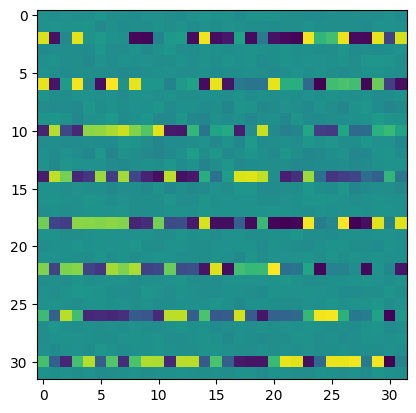

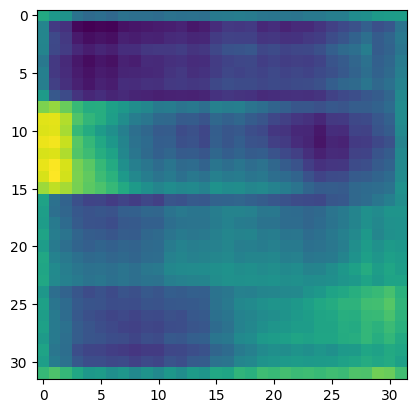

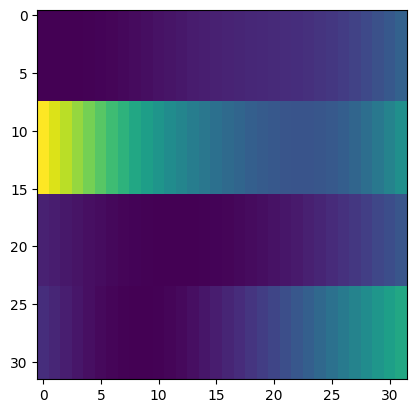

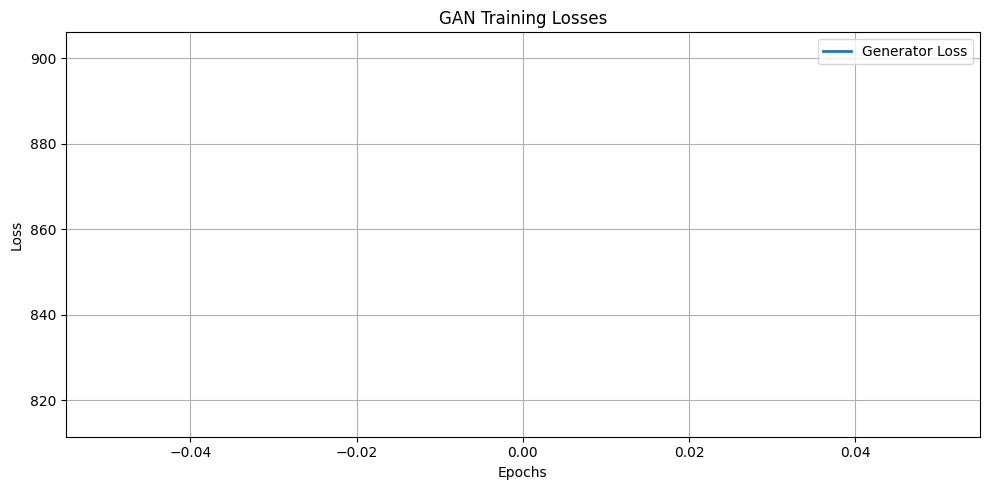

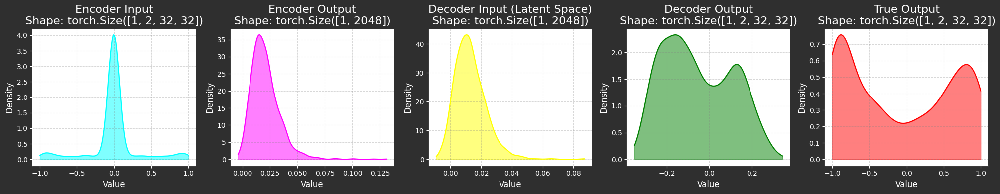

	MNSE Score: 0.4335449898526782
Batch [0/63] - vae loss:  608.21484375
Batch [21/63] - vae loss:  583.9247630726207
Batch [42/63] - vae loss:  560.0772981865462
	Epoch 1 - vae loss: 537.3472183469742
	MNSE Score: 0.1083708827694257
Batch [0/63] - vae loss:  461.9595031738281
Batch [21/63] - vae loss:  455.97710488059306
Batch [42/63] - vae loss:  444.53663812681685
	Epoch 2 - vae loss: 432.90108671642486
	MNSE Score: 0.06826061187755494
Batch [0/63] - vae loss:  382.69134521484375
Batch [21/63] - vae loss:  388.7990889115767
Batch [42/63] - vae loss:  378.7290784259175
	Epoch 3 - vae loss: 370.161368233817
	MNSE Score: 0.05209614389709064
Batch [0/63] - vae loss:  332.69476318359375
Batch [21/63] - vae loss:  336.33362232555044
Batch [42/63] - vae loss:  330.4725973439771
	Epoch 4 - vae loss: 323.8377763051835
	MNSE Score: 0.04166683791175721
Batch [0/63] - vae loss:  292.96319580078125
Batch [21/63] - vae loss:  299.43881919167256
Batch [42/63] - vae loss:  294.8150301201399
	Epoch 5 

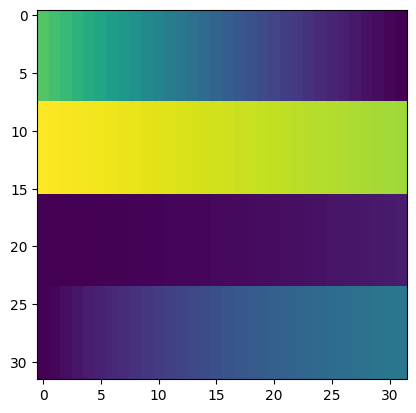

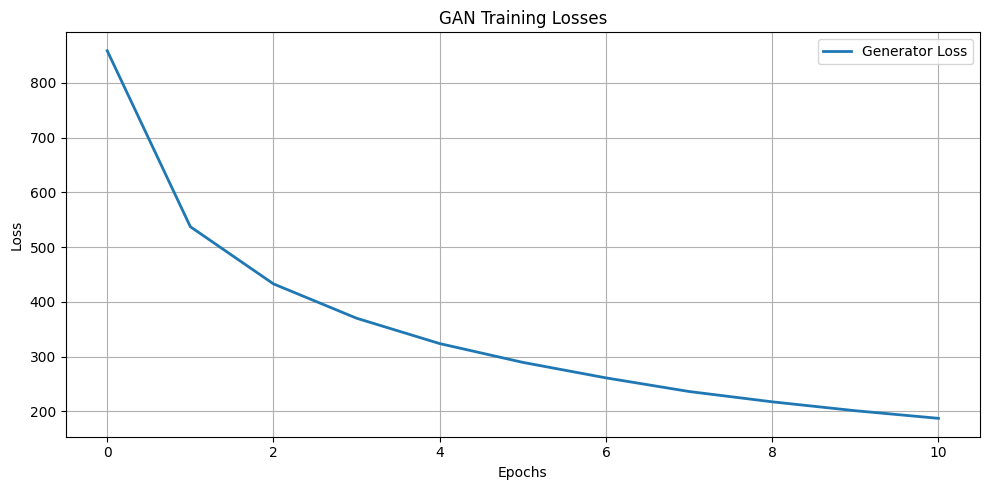

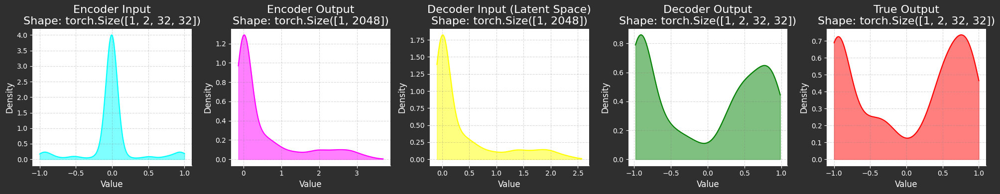

	MNSE Score: 0.02125066196516393
Batch [0/63] - vae loss:  173.9266815185547
Batch [21/63] - vae loss:  179.45576893199575
Batch [42/63] - vae loss:  177.25634162370548
	Epoch 11 - vae loss: 174.98958817739336
	MNSE Score: 0.01984800599397175
Batch [0/63] - vae loss:  176.24197387695312
Batch [21/63] - vae loss:  165.4152568470348
Batch [42/63] - vae loss:  164.66868946164152
	Epoch 12 - vae loss: 163.2954375251891
	MNSE Score: 0.018315989065856214
Batch [0/63] - vae loss:  152.32882690429688
Batch [21/63] - vae loss:  156.28978243741122
Batch [42/63] - vae loss:  154.56955346395804
	Epoch 13 - vae loss: 153.19439624604723
	MNSE Score: 0.017509942623003136
Batch [0/63] - vae loss:  145.8159942626953
Batch [21/63] - vae loss:  148.4320262562145
Batch [42/63] - vae loss:  146.46721453999365
	Epoch 14 - vae loss: 145.22273859902035
	MNSE Score: 0.01684038225738775
Batch [0/63] - vae loss:  133.22528076171875
Batch [21/63] - vae loss:  139.7178358598189
Batch [42/63] - vae loss:  137.71598

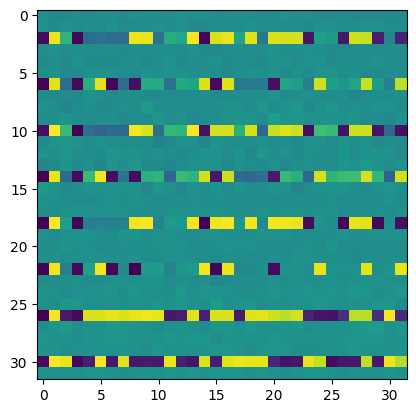

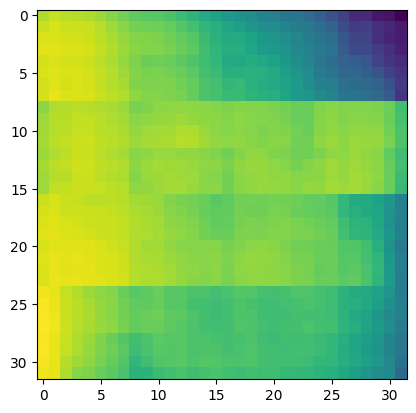

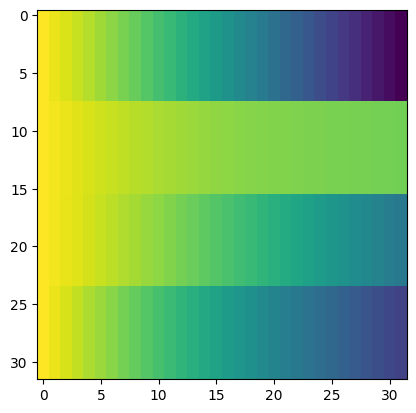

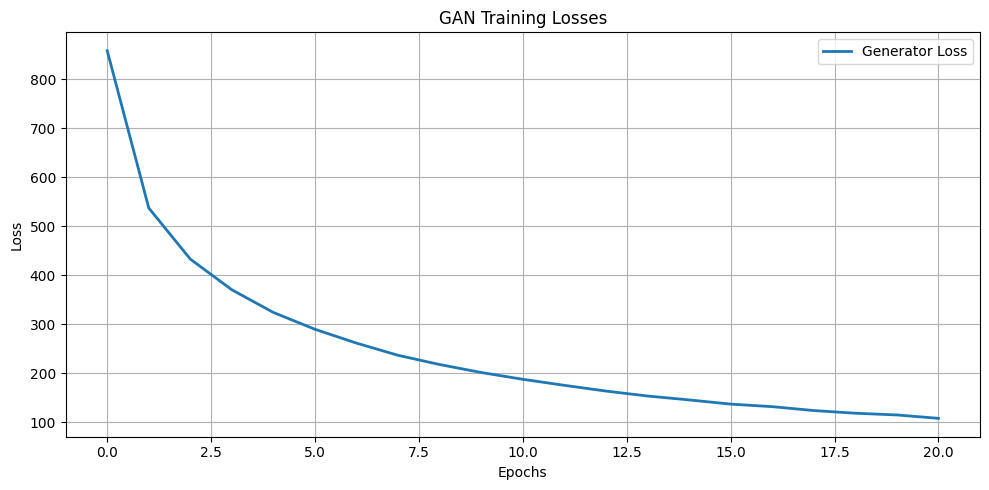

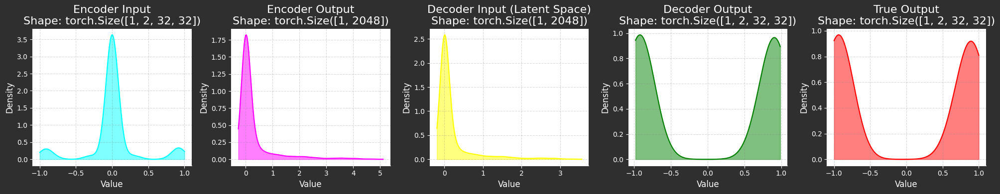

	MNSE Score: 0.01268611369388444
Batch [0/63] - vae loss:  100.33587646484375
Batch [21/63] - vae loss:  105.83332894065164
Batch [42/63] - vae loss:  104.81797080816224
	Epoch 21 - vae loss: 103.91048940022786
	MNSE Score: 0.012478858232498169
Batch [0/63] - vae loss:  98.54835510253906
Batch [21/63] - vae loss:  101.42856147072531
Batch [42/63] - vae loss:  101.78065792349882
	Epoch 22 - vae loss: 100.69028727213542
	MNSE Score: 0.012294089288583823
Batch [0/63] - vae loss:  93.71397399902344
Batch [21/63] - vae loss:  96.87258807095614
Batch [42/63] - vae loss:  97.02707317263581
	Epoch 23 - vae loss: 96.76600295778304
	MNSE Score: 0.011960970090022163
Batch [0/63] - vae loss:  91.86534118652344
Batch [21/63] - vae loss:  95.33339309692383
Batch [42/63] - vae loss:  93.82692505592523
	Epoch 24 - vae loss: 93.11185515873017
	MNSE Score: 0.011705589443740864
Batch [0/63] - vae loss:  89.4716796875
Batch [21/63] - vae loss:  90.98331520774148
Batch [42/63] - vae loss:  90.4694898738417

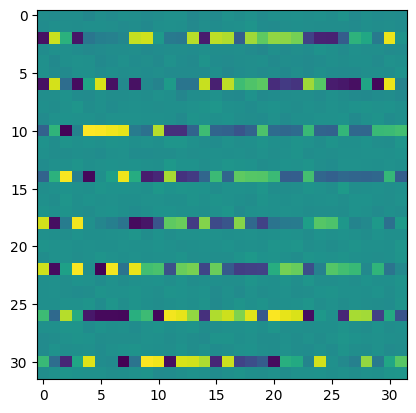

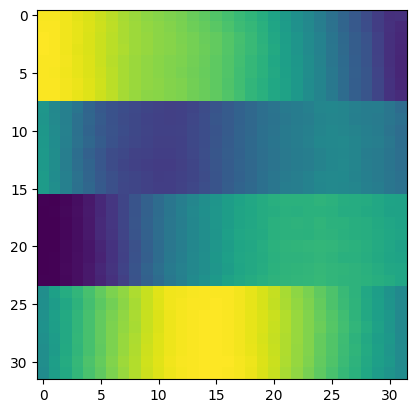

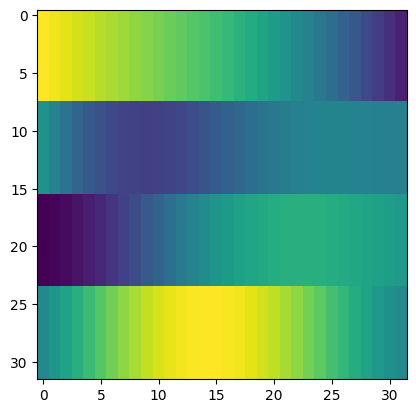

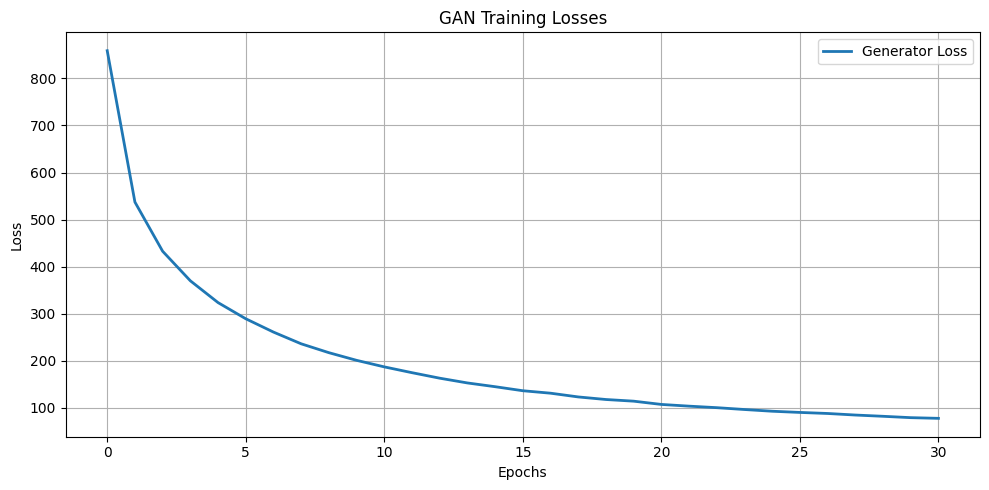

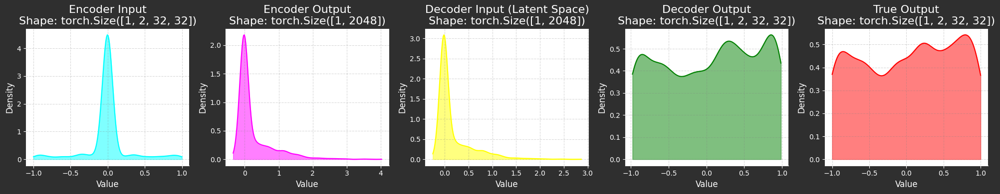

	MNSE Score: 0.009648211987777836
Batch [0/63] - vae loss:  80.24018096923828
Batch [21/63] - vae loss:  76.10030954534358
Batch [42/63] - vae loss:  76.20262412137764
	Epoch 31 - vae loss: 75.5429209149073
	MNSE Score: 0.009298458902372254
Batch [0/63] - vae loss:  76.7830810546875
Batch [21/63] - vae loss:  75.30578717318448
Batch [42/63] - vae loss:  75.22118945454442
	Epoch 32 - vae loss: 74.7222389342293
Batch [0/63] - vae loss:  76.20343017578125
Batch [21/63] - vae loss:  72.87319356744939
Batch [42/63] - vae loss:  73.78917676349019
	Epoch 33 - vae loss: 73.21724967351035
	MNSE Score: 0.00921133669122817
Batch [0/63] - vae loss:  72.55868530273438
Batch [21/63] - vae loss:  71.17383748834783
Batch [42/63] - vae loss:  70.54198668723883
	Epoch 34 - vae loss: 70.75618429032583
	MNSE Score: 0.008712765457670368
Batch [0/63] - vae loss:  70.77095031738281
Batch [21/63] - vae loss:  70.67350873080167
Batch [42/63] - vae loss:  69.67686533373455
	Epoch 35 - vae loss: 69.9219565013098

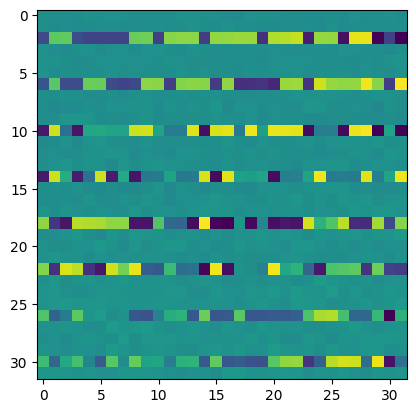

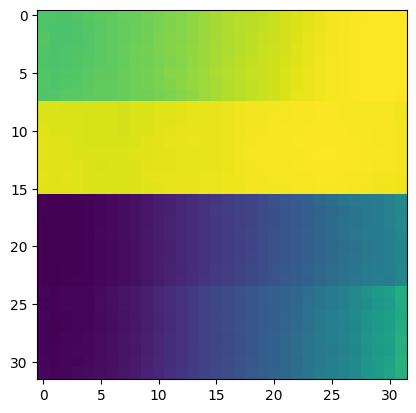

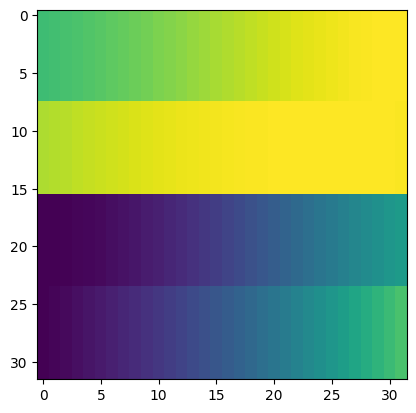

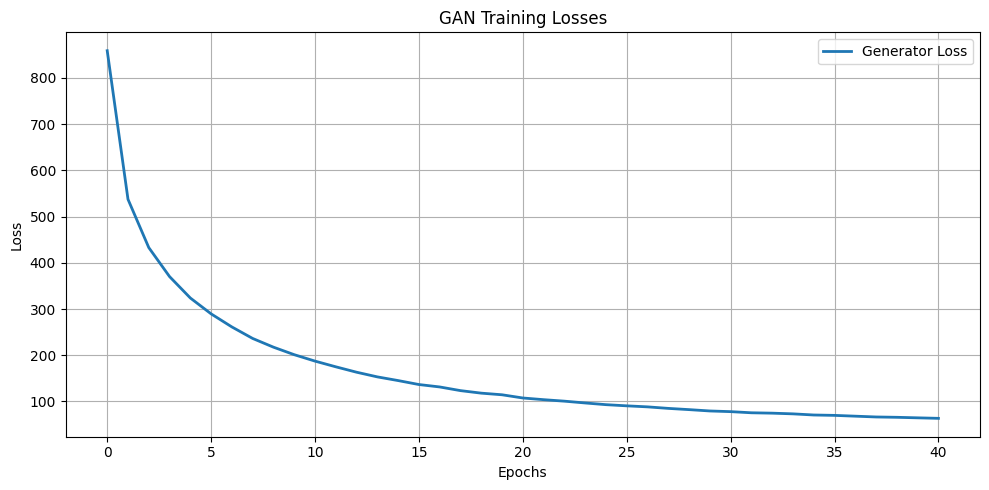

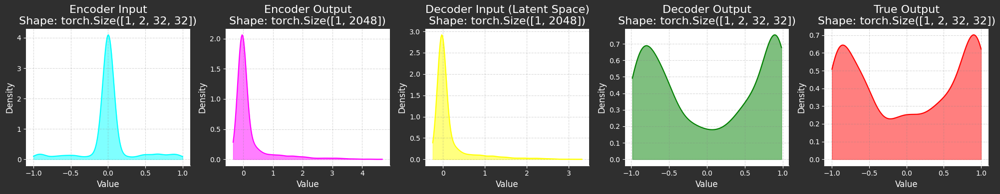

	MNSE Score: 0.007850343501934457
Batch [0/63] - vae loss:  66.29381561279297
Batch [21/63] - vae loss:  62.42689444802024
Batch [42/63] - vae loss:  63.076429145280706
	Epoch 41 - vae loss: 63.172037094358416
Batch [0/63] - vae loss:  68.06536102294922
Batch [21/63] - vae loss:  61.8419224132191
Batch [42/63] - vae loss:  62.73974298876385
	Epoch 42 - vae loss: 62.05814373682416
	MNSE Score: 0.007761957515622415
Batch [0/63] - vae loss:  61.37715148925781
Batch [21/63] - vae loss:  60.211327119307086
Batch [42/63] - vae loss:  60.91457304843637
	Epoch 43 - vae loss: 60.32481456938244
	MNSE Score: 0.007329770807354223
Batch [0/63] - vae loss:  56.950172424316406
Batch [21/63] - vae loss:  60.40873908996582
Batch [42/63] - vae loss:  59.61912359193314
	Epoch 44 - vae loss: 59.162822905040926
	MNSE Score: 0.007273368685254975
Batch [0/63] - vae loss:  54.79447937011719
Batch [21/63] - vae loss:  59.46950184215199
Batch [42/63] - vae loss:  58.38450489487759
	Epoch 45 - vae loss: 57.78501

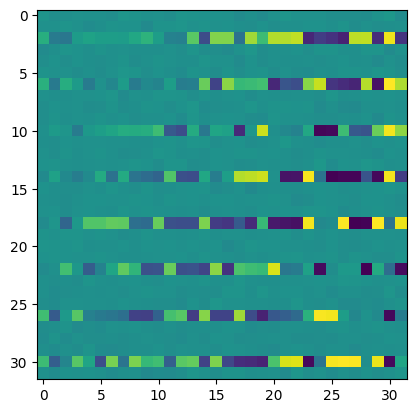

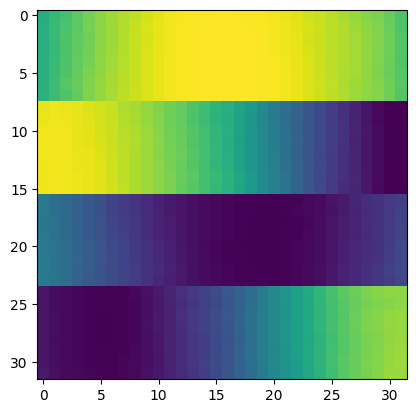

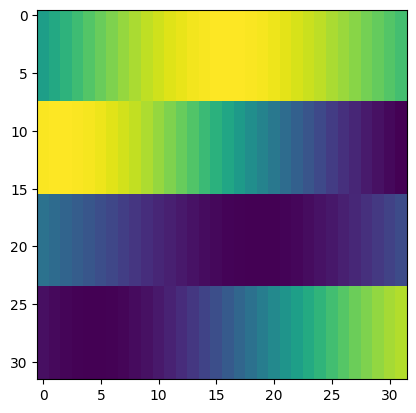

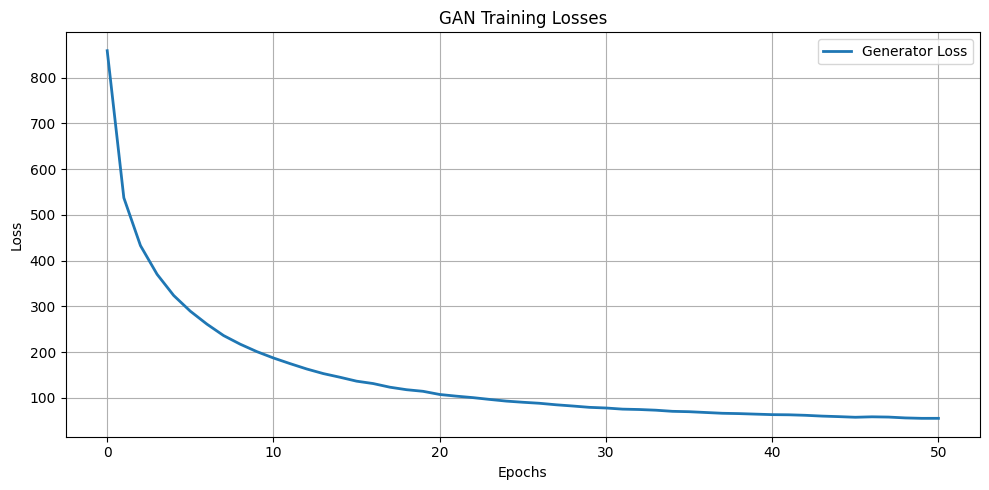

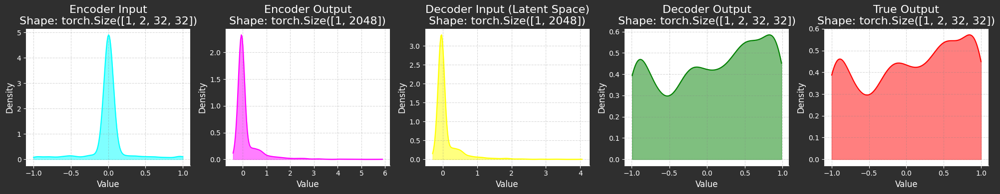

Batch [0/63] - vae loss:  54.19929504394531
Batch [21/63] - vae loss:  54.72640609741211
Batch [42/63] - vae loss:  55.0875358581543
	Epoch 51 - vae loss: 54.65560592166961
Batch [0/63] - vae loss:  67.2071533203125
Batch [21/63] - vae loss:  54.18992146578702
Batch [42/63] - vae loss:  53.63109597494436
	Epoch 52 - vae loss: 53.61400580027747
	MNSE Score: 0.006373208592690173
Batch [0/63] - vae loss:  46.723731994628906
Batch [21/63] - vae loss:  53.882238908247515
Batch [42/63] - vae loss:  53.79129090420035
	Epoch 53 - vae loss: 53.70297864883665
Batch [0/63] - vae loss:  47.46882247924805
Batch [21/63] - vae loss:  52.590197649869054
Batch [42/63] - vae loss:  52.124470466791195
	Epoch 54 - vae loss: 51.97460186670697
	MNSE Score: 0.006154768619804628
Batch [0/63] - vae loss:  58.53229522705078
Batch [21/63] - vae loss:  53.08132136951793
Batch [42/63] - vae loss:  53.291365512581756
	Epoch 55 - vae loss: 52.50700602455745
Batch [0/63] - vae loss:  48.08255386352539
Batch [21/63] -

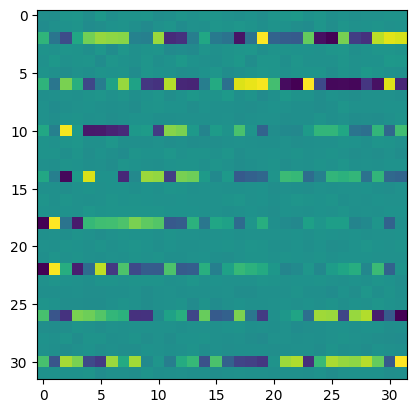

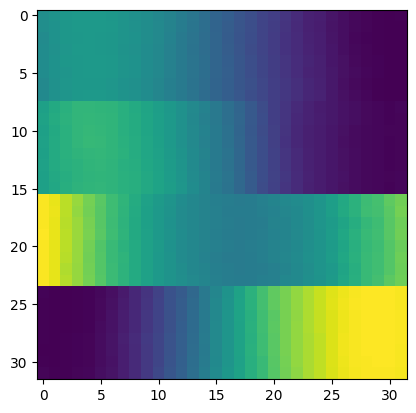

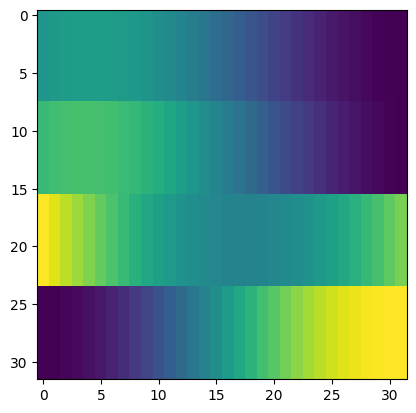

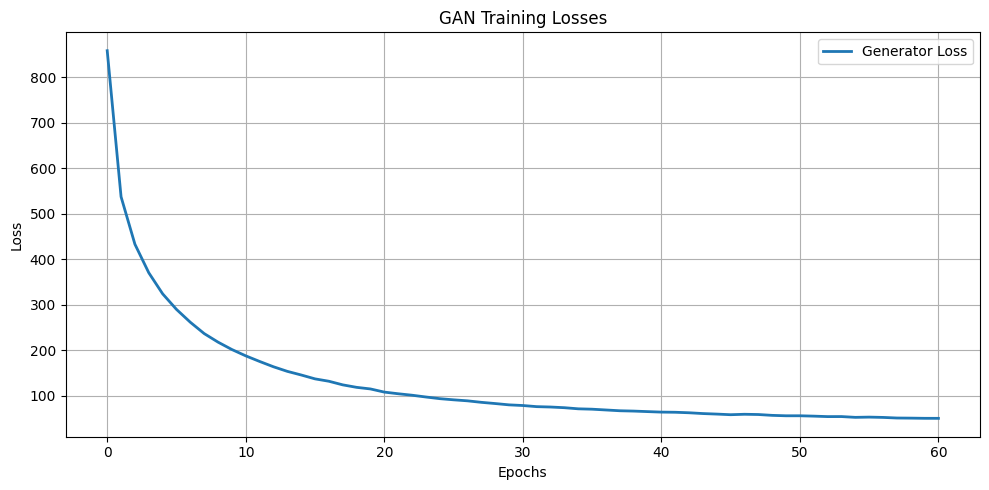

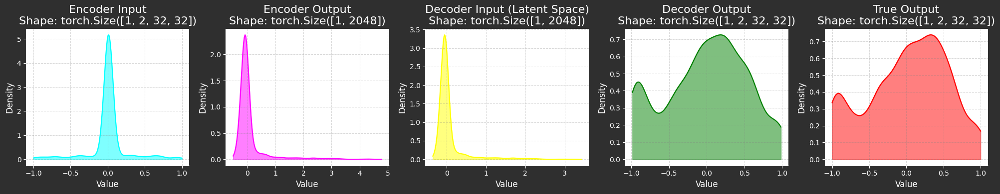

	MNSE Score: 0.005873533656879786
Batch [0/63] - vae loss:  47.66534423828125
Batch [21/63] - vae loss:  50.47340479764071
Batch [42/63] - vae loss:  49.42303901494935
	Epoch 61 - vae loss: 49.21299616495768
	MNSE Score: 0.005797719161602713
Batch [0/63] - vae loss:  52.9040412902832
Batch [21/63] - vae loss:  49.14152370799672
Batch [42/63] - vae loss:  49.863789314447445
	Epoch 62 - vae loss: 49.21534971206907
Batch [0/63] - vae loss:  43.40901565551758
Batch [21/63] - vae loss:  48.475150021639735
Batch [42/63] - vae loss:  48.370741112287654
	Epoch 63 - vae loss: 48.6702631390284
Batch [0/63] - vae loss:  51.575382232666016
Batch [21/63] - vae loss:  48.577877044677734
Batch [42/63] - vae loss:  48.50157946209575
	Epoch 64 - vae loss: 48.01252286396329
	MNSE Score: 0.0055938830362662435
Batch [0/63] - vae loss:  43.92250442504883
Batch [21/63] - vae loss:  45.65151231939142
Batch [42/63] - vae loss:  45.79885615858921
	Epoch 65 - vae loss: 46.17253548758371
	MNSE Score: 0.005273036

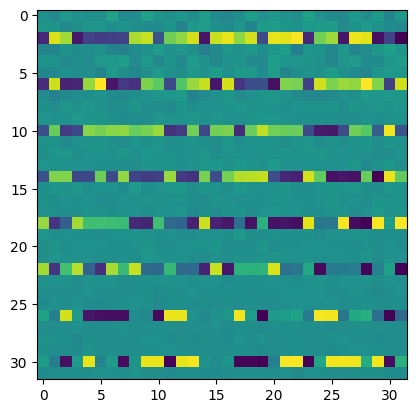

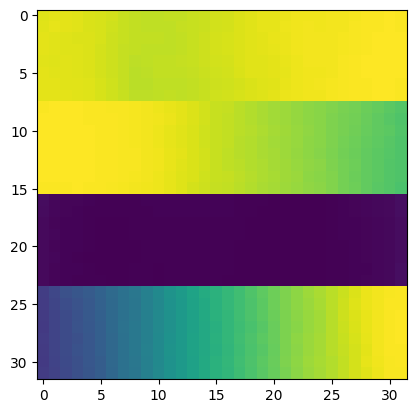

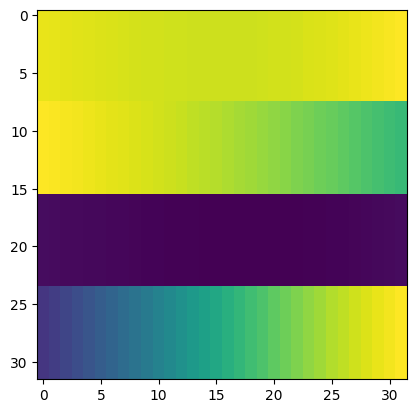

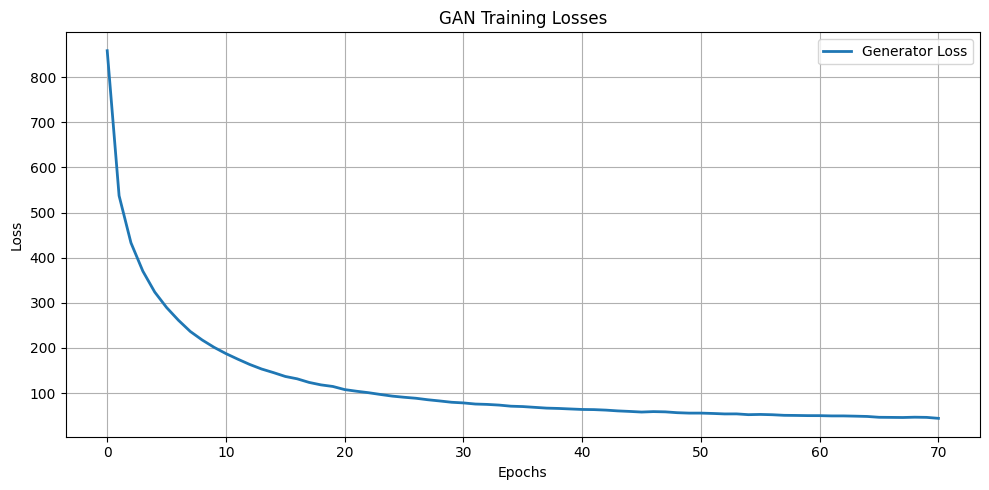

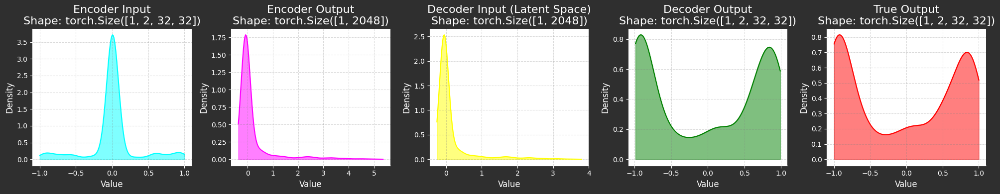

	MNSE Score: 0.004940504958439205
Batch [0/63] - vae loss:  39.29665756225586
Batch [21/63] - vae loss:  45.502202467484906
Batch [42/63] - vae loss:  44.7057788760163
	Epoch 71 - vae loss: 44.05046517508371
	MNSE Score: 0.00493707371846078
Batch [0/63] - vae loss:  49.80696105957031
Batch [21/63] - vae loss:  44.34617371992631
Batch [42/63] - vae loss:  44.42436741673669
	Epoch 72 - vae loss: 44.45287559145973
Batch [0/63] - vae loss:  48.24700164794922
Batch [21/63] - vae loss:  44.573483033613726
Batch [42/63] - vae loss:  43.65958351312682
	Epoch 73 - vae loss: 43.82116408575149
Batch [0/63] - vae loss:  39.048824310302734
Batch [21/63] - vae loss:  44.02046862515536
Batch [42/63] - vae loss:  43.66364119773687
	Epoch 74 - vae loss: 43.42255238124302
Batch [0/63] - vae loss:  45.353179931640625
Batch [21/63] - vae loss:  43.34176184914329
Batch [42/63] - vae loss:  43.29060106499251
	Epoch 75 - vae loss: 43.03425592089456
	MNSE Score: 0.004831194238264173
Batch [0/63] - vae loss:  

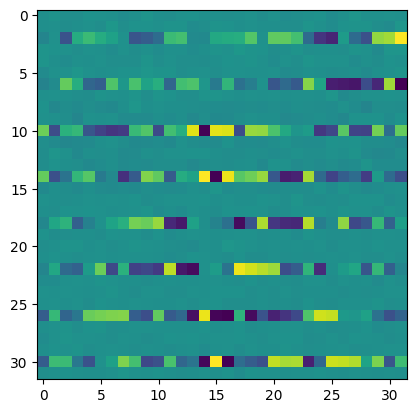

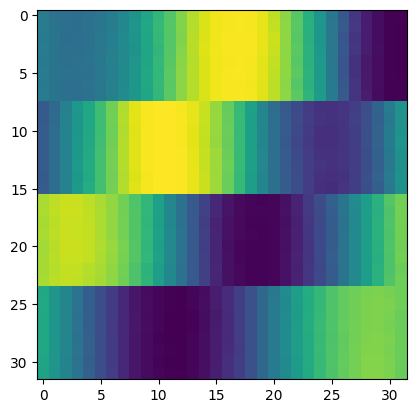

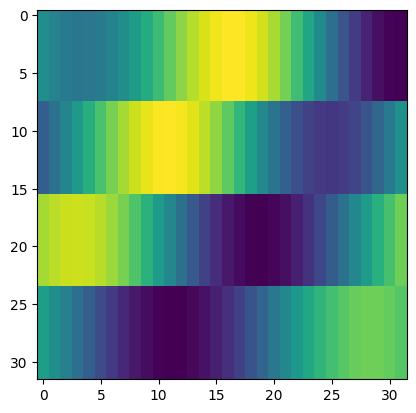

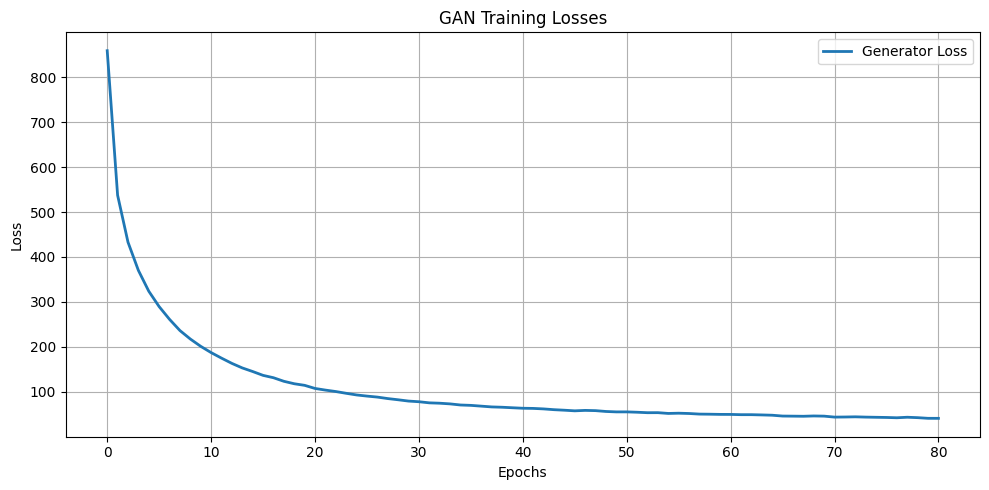

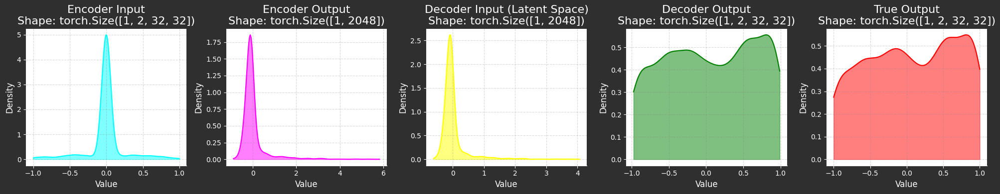

Batch [0/63] - vae loss:  36.424747467041016
Batch [21/63] - vae loss:  41.374507037076086
Batch [42/63] - vae loss:  40.96414566040039
	Epoch 81 - vae loss: 41.141524784148686
Batch [0/63] - vae loss:  39.755882263183594
Batch [21/63] - vae loss:  40.215575131503016
Batch [42/63] - vae loss:  40.22503218539926
	Epoch 82 - vae loss: 40.39929641239227
	MNSE Score: 0.004496500125184419
Batch [0/63] - vae loss:  48.16228485107422
Batch [21/63] - vae loss:  40.33857623013583
Batch [42/63] - vae loss:  40.15005874633789
	Epoch 83 - vae loss: 39.83304486955915


In [ ]:
channel_est_vae_multi_antenna()

## VAE + WGAN-GP

In [ ]:
vae = VAE(z_dim=z_dim, mu_h=MU_H, std_h=STD_H).to(device)
critic = Critic().to(device)

# Initialize weights
vae = vae.apply(weights_init)
critic = critic.apply(weights_init)

# Optimizer is Adam help converge faster and more stable
vae_opt = torch.optim.Adam(vae.parameters(), lr=lr, betas=betas)
c_opt = torch.optim.Adam(critic.parameters(), lr=lr, betas=betas)

skew_cal = SkewCalculator(device)

In [ ]:
def channel_est_wgan_gp_vae_multi_antenna():
    save_results = "channel_est_wgan_gp_vae_multi_antenna"
    min_nmse_scores = 10000000
    total_g_losses = []
    total_c_losses = []
    total_nmse_scores = []
    for epoch in range(n_epochs):
        # Training
        g_losses = 0
        c_losses = 0
        nmse_scores = 0

        total_critic_reals = []
        total_critic_fakes = []
        total_generator_fakes = []

        vae.train()
        critic.train()
        for batch_index, (real, label) in enumerate(train_dataset):

            real = real.to(device)
            label = label.to(device)
            cur_batch_size = real.shape[0]
            #################
            # Update critic #
            #################
            total_c_repeat_losses = 0
            critic_reals = 0
            critic_fakes = 0
            for _ in range(critic_repeats):
                c_opt.zero_grad()


                # Forward pass
                fake, *values = vae(label)

                # critic loss
                critic_real = critic(real)
                critic_fake = critic(fake)

                c_repeat_loss = - (torch.mean(critic_real) - torch.mean(critic_fake))

                # gp loss
                gp_loss = gradient_penalty_loss(critic=critic, real=real, fake=fake)

                # total critic loss
                total_c_repeat_loss = c_repeat_loss + c_lambda * gp_loss
                # Update gradients
                total_c_repeat_loss.backward(retain_graph=True)

                # Update optimizer
                c_opt.step()

                # Keep track of the average critic loss in this batch
                critic_reals += critic_real.detach().cpu()
                critic_fakes += critic_fake.detach().cpu()

                total_c_repeat_losses += total_c_repeat_loss.detach().cpu().item()

            total_critic_reals.append((critic_reals / critic_repeats).view(-1))
            total_critic_fakes.append((critic_fakes / critic_repeats).view(-1))
            c_losses += total_c_repeat_losses / critic_repeats

            ####################
            # Update generator #
            ####################
            vae_opt.zero_grad()

            # get noise
            # Forward pass
            fake_2, *values = vae(label)

            # Compute loss
            v_loss, *values = vae_loss(fake_2, real, *values)


            critic_fake_2 = critic(fake_2)


            g_loss = - torch.mean(critic_fake_2) + v_loss


            # Update gradients
            g_loss.backward()

            # Update the weights
            vae_opt.step()

            g_losses += g_loss.detach().cpu().item()
            total_generator_fakes.append(critic_fake_2.detach().cpu().view(-1))

            if batch_index % (len(train_dataset) // 3) == 0:
                print(f"Batch [{batch_index}/{len(train_dataset)}] - ",  "Critic loss: ",  c_losses / (batch_index + 1), "- generator loss: ", g_losses / (batch_index + 1))

            nmse_score = nmse_func(
                pred=fake.permute(0, 2, 3, 1).detach().cpu(),
                target=real.permute(0, 2, 3, 1).detach().cpu(),
            )
            nmse_scores += nmse_score

        total_nmse_scores.append(nmse_scores / len(train_dataset))
        total_c_losses.append(c_losses / len(train_dataset))
        total_g_losses.append(g_losses / len(train_dataset))


        print(f"\tEpoch {epoch} - critic loss: {total_c_losses[-1]} - generator loss: {total_g_losses[-1]}")

        vae.eval()
        critic.eval()
        # Visualize Test Dataset
        with torch.no_grad():
            for real, label in eval_dataset:
                cur_batch_size = real.shape[0]
                real = real.to(device)
                label = label.to(device)
                fake, *values = vae(label)
                _, _, (input_decoder, output_encoder) = values
                break
        if epoch in range(0, n_epochs, int(n_epochs // 10)):
            show_tensor_images(label[0,0,:,:].T)
            show_tensor_images(fake[0,0,:,:].T)
            show_tensor_images(real[0,0,:,:].T)
            show_loss_images(total_c_losses, total_g_losses)

            # grad_cam = GradCam(critic, critic.critic[-3])
            # grad_cam_1 = GradCam(critic, critic.critic[-2])
            # grad_cam_2 = GradCam(critic, critic.critic[-1])
            # grad_cam.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_1_epoch{epoch}.png")
            # grad_cam_1.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_2_epoch{epoch}.png")
            # grad_cam_2.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_3_epoch{epoch}.png")

            plot_distribution(
                np.array(torch.cat(total_critic_reals)),
                np.array(torch.cat(total_critic_fakes)),
                np.array(torch.cat(total_generator_fakes)),
                save_path=f"results/dis/{save_results}/dis_{epoch}.png"
            )
            plot_vae_in_out(label, fake, input_decoder, output_encoder, real)


            grad_cam = GradCam(critic, critic.critic[-3][0])
            grad_cam_1 = GradCam(critic, critic.critic[-2][0])
            grad_cam_2 = GradCam(critic, critic.critic[-1][0])
            grad_cam.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_1_epoch{epoch}.png")
            grad_cam_1.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_2_epoch{epoch}.png")
            grad_cam_2.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_3_epoch{epoch}.png")


        if min_nmse_scores > min(total_nmse_scores):
            min_nmse_scores = min(total_nmse_scores)
            save_checkpoint(vae, f"results/checkpoint/{save_results}/g_model.pt")
            save_checkpoint(critic, f"results/checkpoint/{save_results}/d_model.pt")
            plot_generated_image(
                fake[0,0,:,:].T,
                test_input=label[0,0,:,:].T,
                tar=real[0,0,:,:].T,
                prefix=save_results,
            )
            print(f"\tMNSE Score: {min_nmse_scores}")

        plot_nmse_func(
            total_nmse_scores,
            range(epoch + 1),
            img_path=f"results/nmse/{save_results}/nmse.png",
        )
        plot_loss_func(
            total_c_losses,
            total_g_losses,
            range(epoch + 1),
            img_path=f"results/loss/{save_results}/loss.png",
        )

    save_npy(f"results/nmse/{save_results}/nmse_scores.npy", np.array(total_nmse_scores))
    save_npy(f"results/loss/{save_results}/losses_d.npy", np.array(total_c_losses))
    save_npy(f"results/loss/{save_results}/losses_g.npy", np.array(total_g_losses))


Batch [21/63] -  Critic loss:  3.7458773598526474 - generator loss:  585.4312438964844
Batch [42/63] -  Critic loss:  4.052780521008395 - generator loss:  558.5308894667514
	Epoch 1 - critic loss: 3.9365863106238153 - generator loss: 538.0485006665426
	MNSE Score: 0.10801217030911218
Batch [0/63] -  Critic loss:  4.295897324879964 - generator loss:  454.2664489746094
Batch [21/63] -  Critic loss:  2.5892295421976033 - generator loss:  456.43614196777344
Batch [42/63] -  Critic loss:  1.7675961445468342 - generator loss:  442.03280994503996
	Epoch 2 - critic loss: 1.35953794995313 - generator loss: 431.1604401119172
	MNSE Score: 0.06545393145273602
Batch [0/63] -  Critic loss:  0.3669406771659851 - generator loss:  387.5633239746094
Batch [21/63] -  Critic loss:  0.29899480826023855 - generator loss:  385.0088181929155
Batch [42/63] -  Critic loss:  0.27090891398662736 - generator loss:  376.5649960540062
	Epoch 3 - critic loss: 0.2736480242360836 - generator loss: 367.853511749752
	MNS

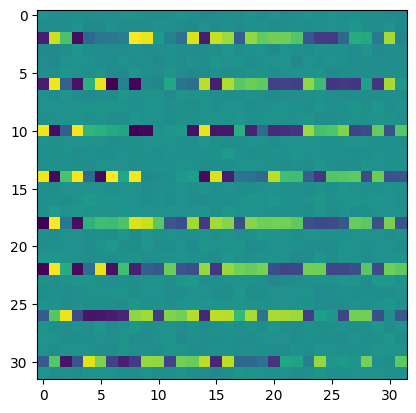

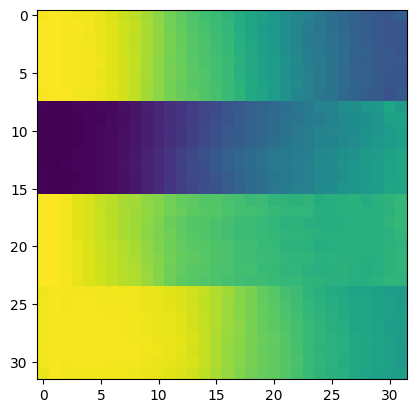

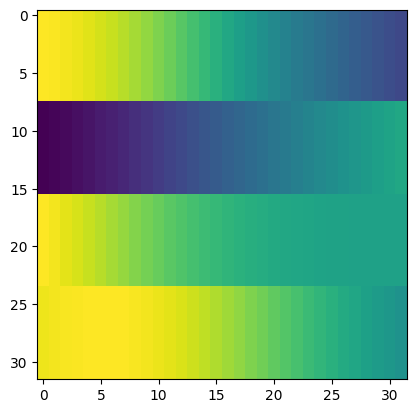

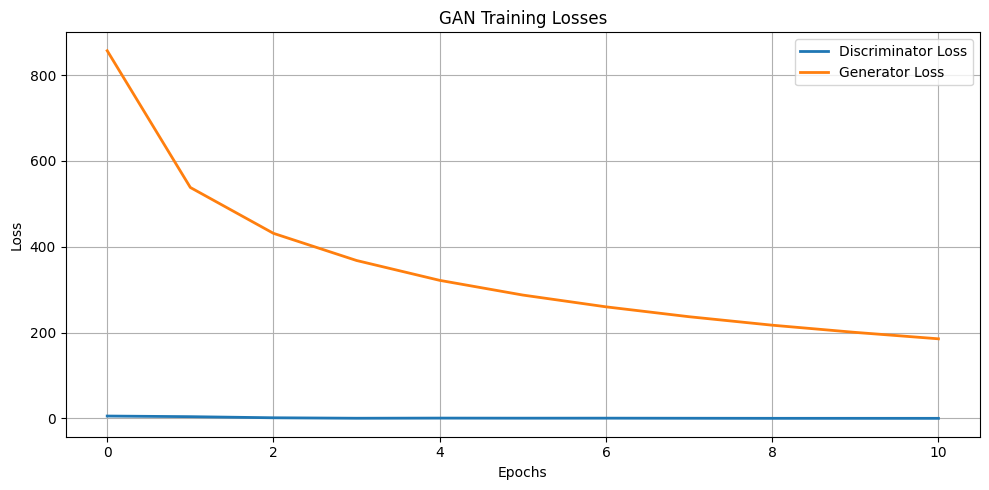

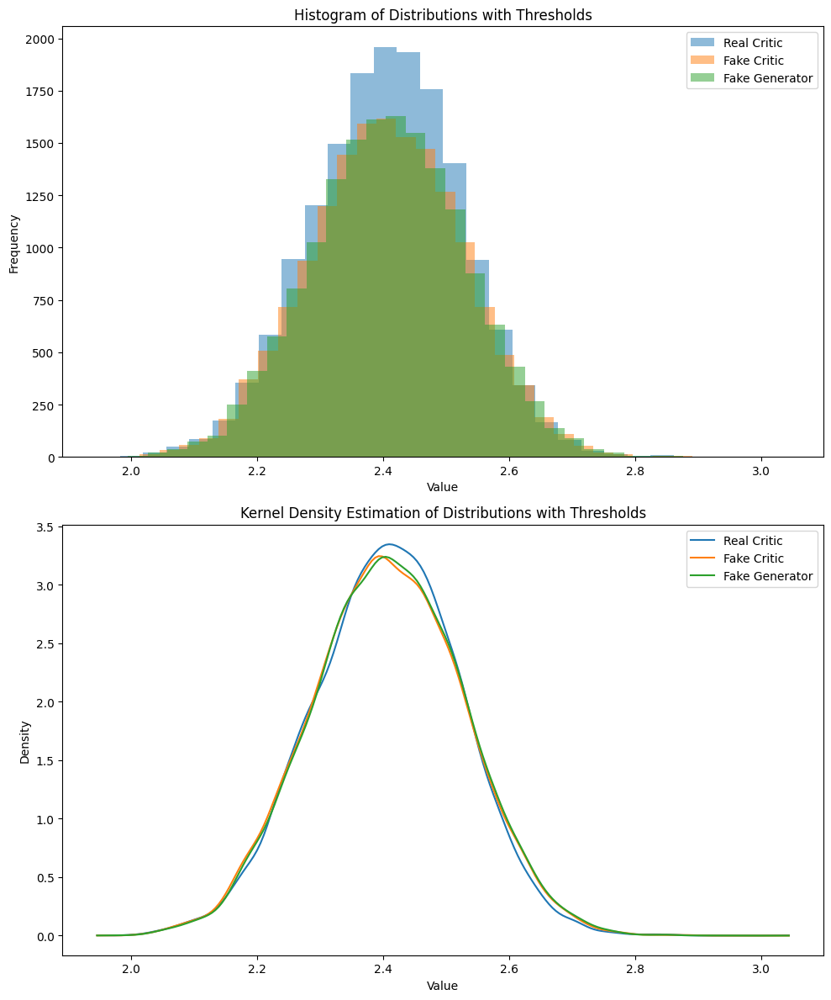

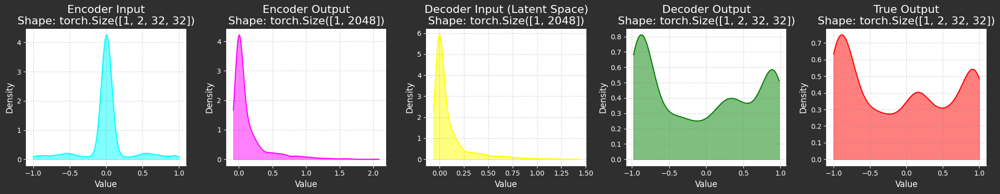

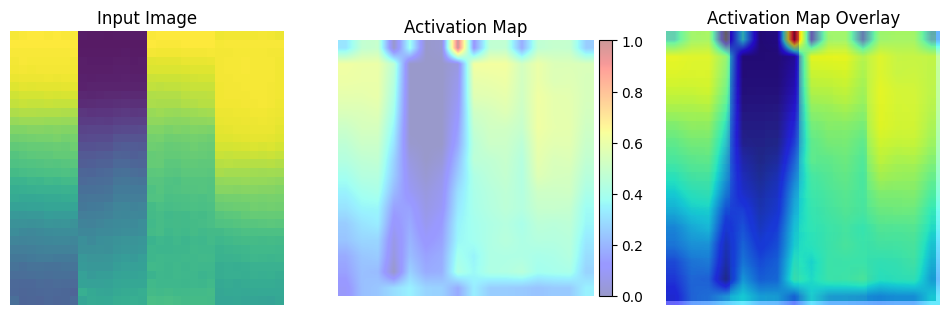

/tmp/ipykernel_29/1517990262.py:63: RuntimeWarning: invalid value encountered in divide
  activation_map = (activation_map - activation_map.min()) / (


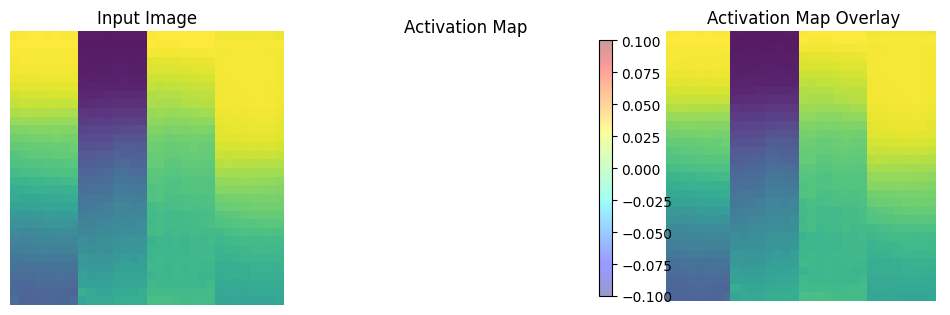

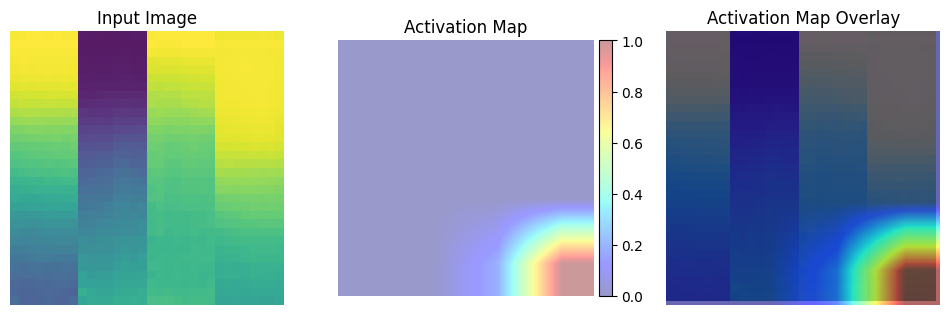

	MNSE Score: 0.02033388301257103
Batch [0/63] -  Critic loss:  0.08332948386669159 - generator loss:  174.90887451171875
Batch [21/63] -  Critic loss:  0.039665352016913166 - generator loss:  177.38731800426137
Batch [42/63] -  Critic loss:  0.052294793459334105 - generator loss:  175.34837341308594
	Epoch 11 - critic loss: 0.09088538077576135 - generator loss: 173.83280290876115
	MNSE Score: 0.01934487385941403
Batch [0/63] -  Critic loss:  0.2649405896663666 - generator loss:  161.75067138671875
Batch [21/63] -  Critic loss:  0.1363942645151507 - generator loss:  166.98662289706144
Batch [42/63] -  Critic loss:  0.11216429540122203 - generator loss:  164.77481930754905
	Epoch 12 - critic loss: 0.1138731408765707 - generator loss: 162.32748170882937
	MNSE Score: 0.018151678514504242
Batch [0/63] -  Critic loss:  0.06221485137939453 - generator loss:  152.72259521484375
Batch [21/63] -  Critic loss:  0.12807956710457805 - generator loss:  155.200759194114
Batch [42/63] -  Critic loss: 

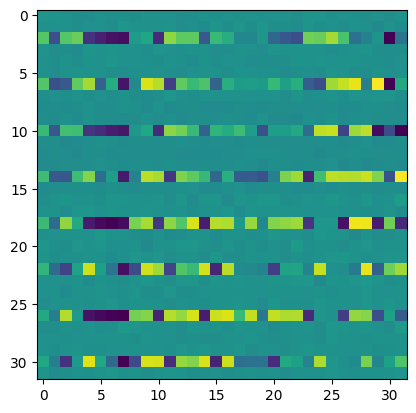

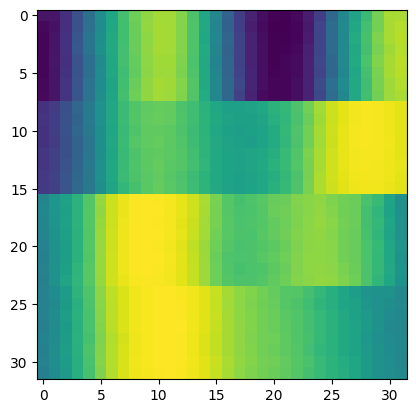

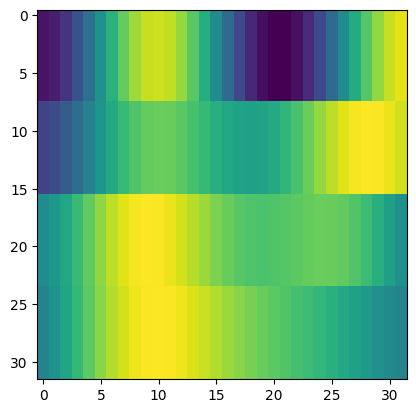

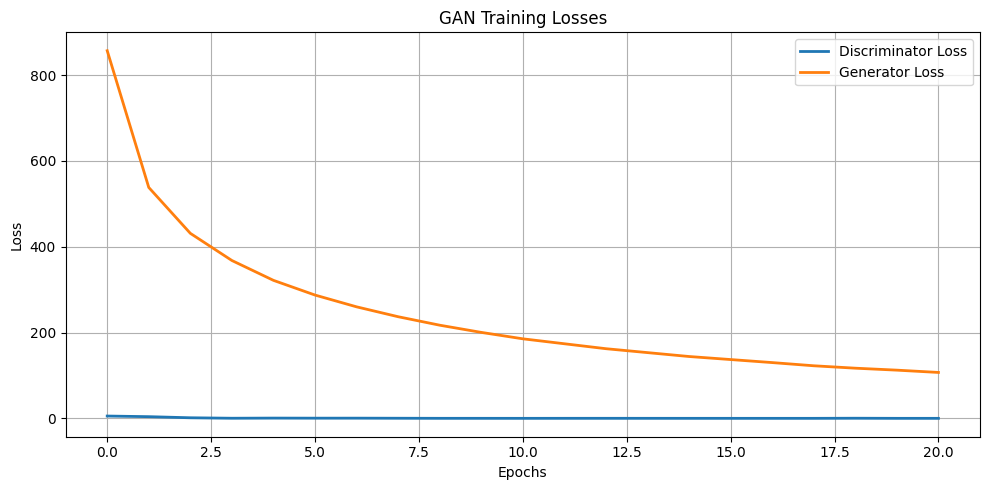

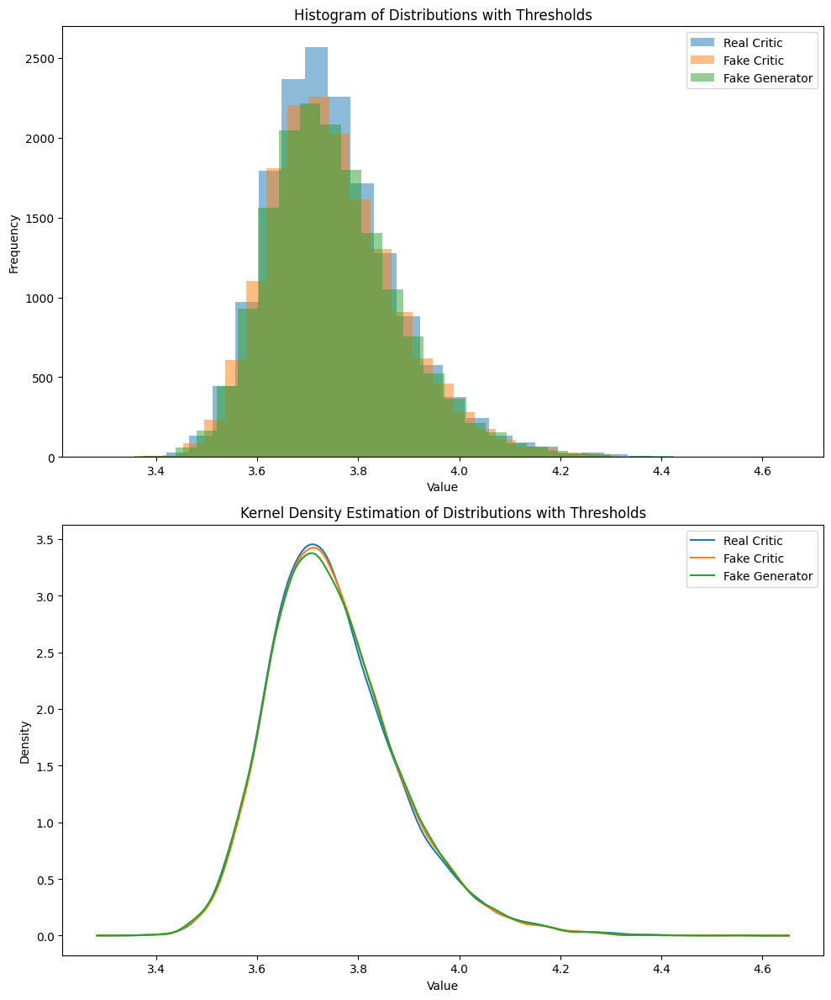

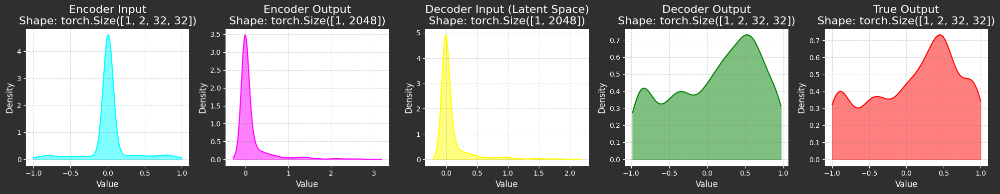

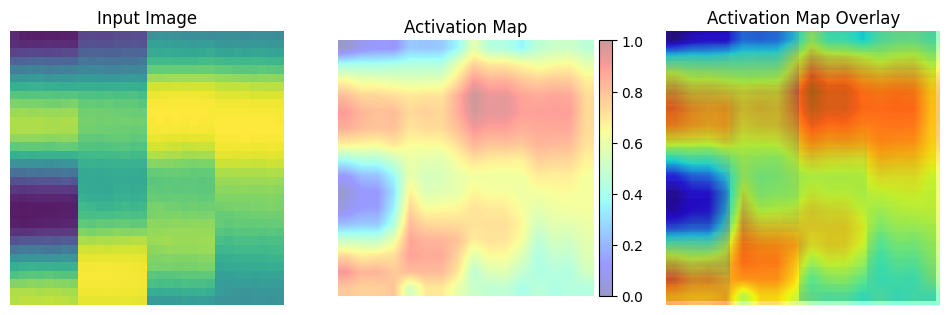

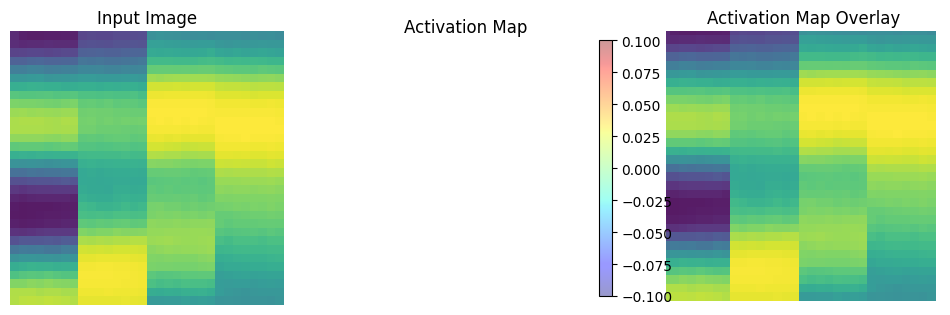

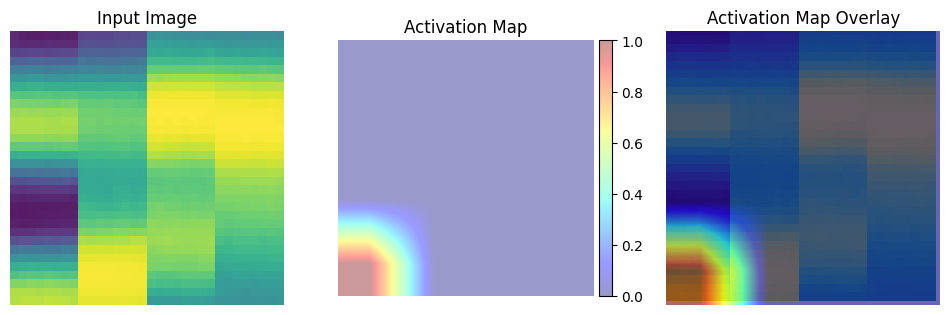

	MNSE Score: 0.0129794796840066
Batch [0/63] -  Critic loss:  0.030520976210633915 - generator loss:  92.53878784179688
Batch [21/63] -  Critic loss:  0.038947758716389995 - generator loss:  103.11404488303445
Batch [42/63] -  Critic loss:  0.035158166676297675 - generator loss:  102.57657303921012
	Epoch 21 - critic loss: 0.03392810363657576 - generator loss: 102.16346135215154
	MNSE Score: 0.012477977570915033
Batch [0/63] -  Critic loss:  0.05049586296081543 - generator loss:  101.90424346923828
Batch [21/63] -  Critic loss:  0.037581529496519855 - generator loss:  99.73017952658914
Batch [42/63] -  Critic loss:  0.03532965758512186 - generator loss:  99.30323401162791
	Epoch 22 - critic loss: 0.03335624900720423 - generator loss: 99.26085590180897
	MNSE Score: 0.012295604919985173
Batch [0/63] -  Critic loss:  0.03036392790575822 - generator loss:  92.94843292236328
Batch [21/63] -  Critic loss:  0.04429788862101056 - generator loss:  97.23039384321733
Batch [42/63] -  Critic loss:

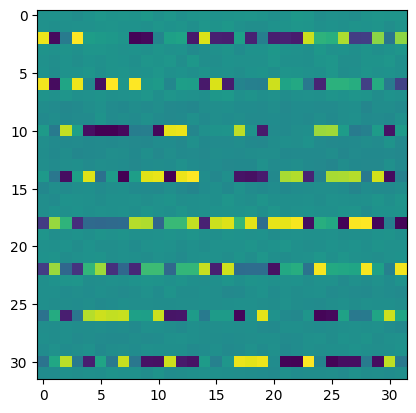

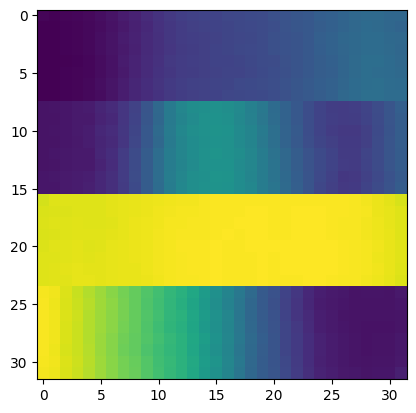

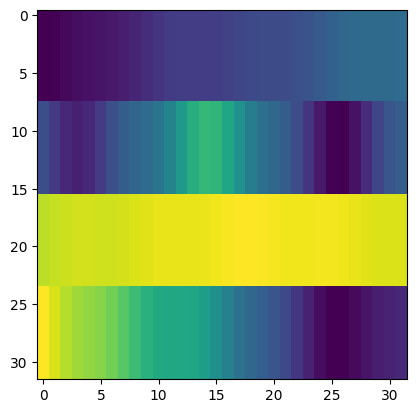

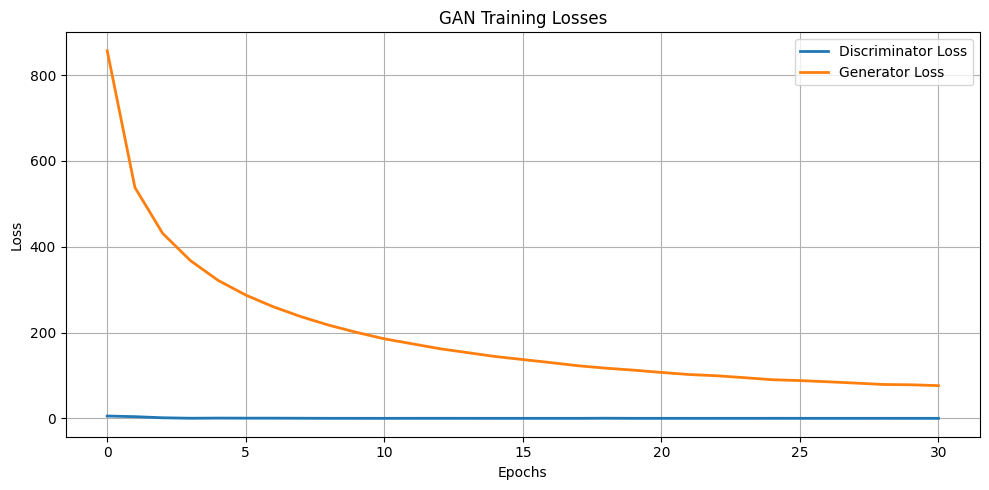

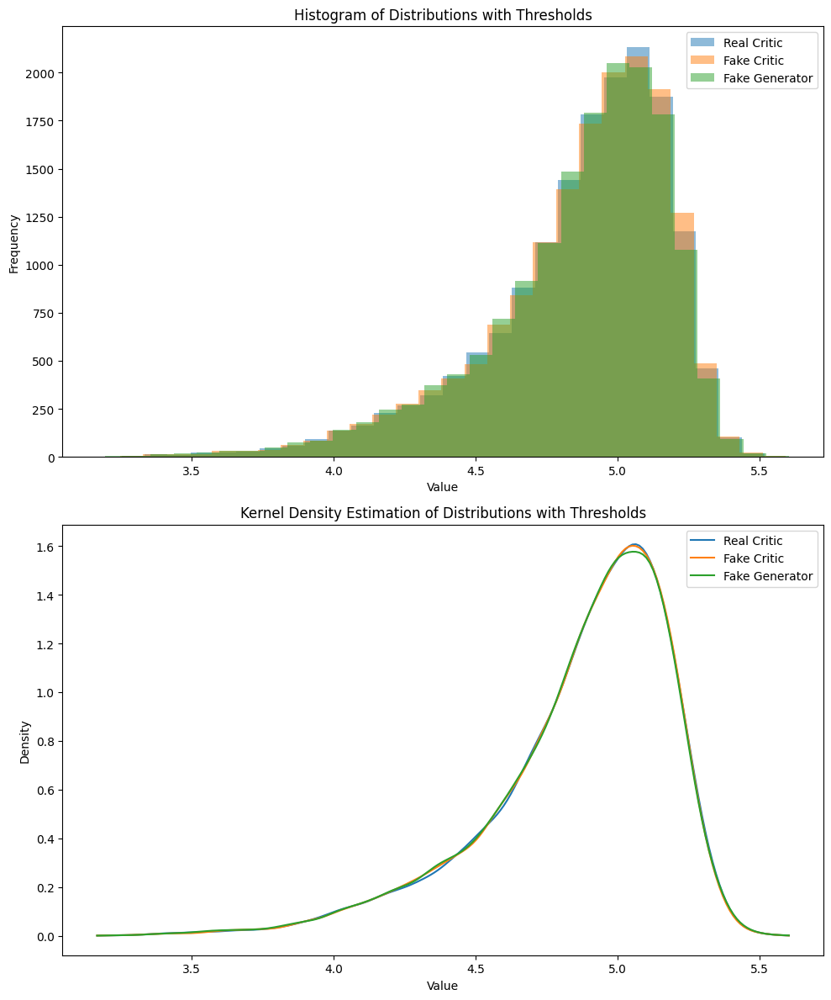

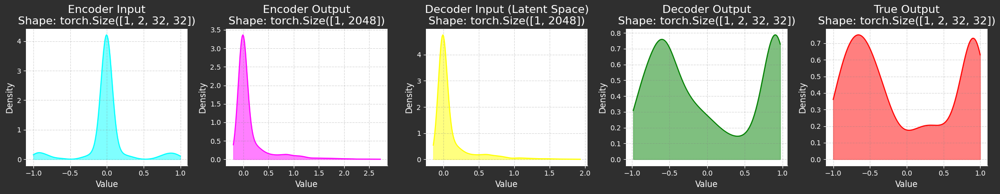

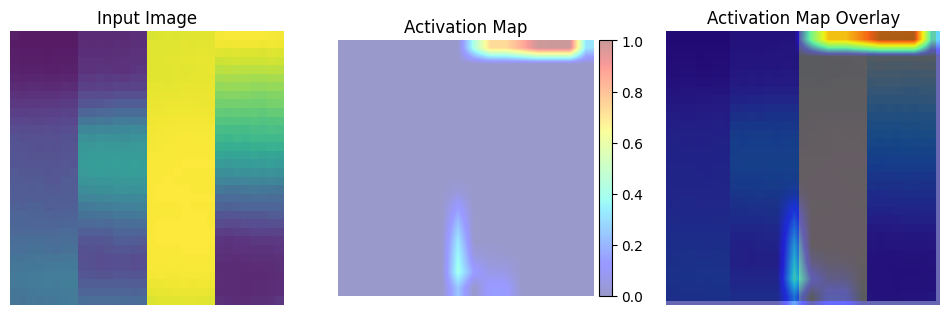

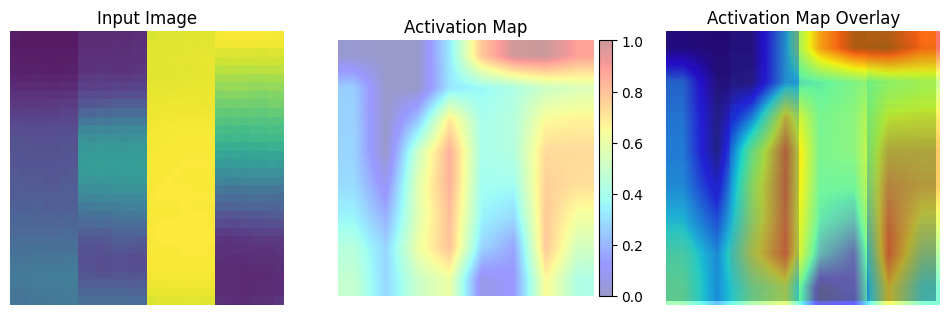

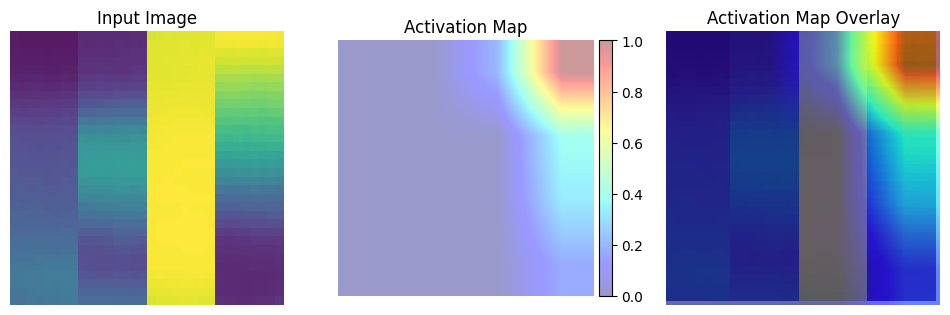

Batch [0/63] -  Critic loss:  0.01277315802872181 - generator loss:  74.5458755493164
Batch [21/63] -  Critic loss:  0.024864671257973616 - generator loss:  73.47083698619495
Batch [42/63] -  Critic loss:  0.021681577097191363 - generator loss:  73.69796220646349
	Epoch 31 - critic loss: 0.0218711938541481 - generator loss: 73.72587942698645
	MNSE Score: 0.009614040572491904
Batch [0/63] -  Critic loss:  0.1157552922765414 - generator loss:  78.37066650390625
Batch [21/63] -  Critic loss:  0.023933325428515676 - generator loss:  71.58926634355025
Batch [42/63] -  Critic loss:  0.026529199075560242 - generator loss:  72.37268563204033
	Epoch 32 - critic loss: 0.024656806200269672 - generator loss: 71.77432832263764
	MNSE Score: 0.009301681795881854
Batch [0/63] -  Critic loss:  0.1394147165119648 - generator loss:  77.07594299316406
Batch [21/63] -  Critic loss:  0.017217965105153395 - generator loss:  71.13296907598323
Batch [42/63] -  Critic loss:  0.015737494504324684 - generator los

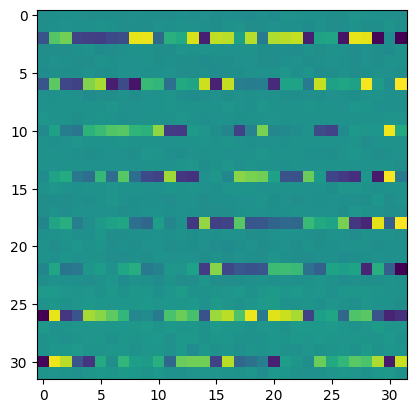

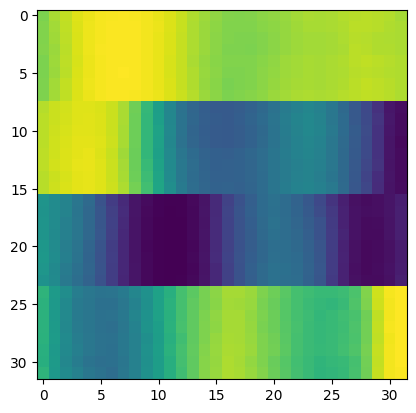

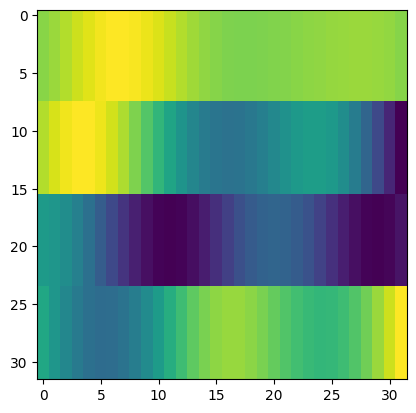

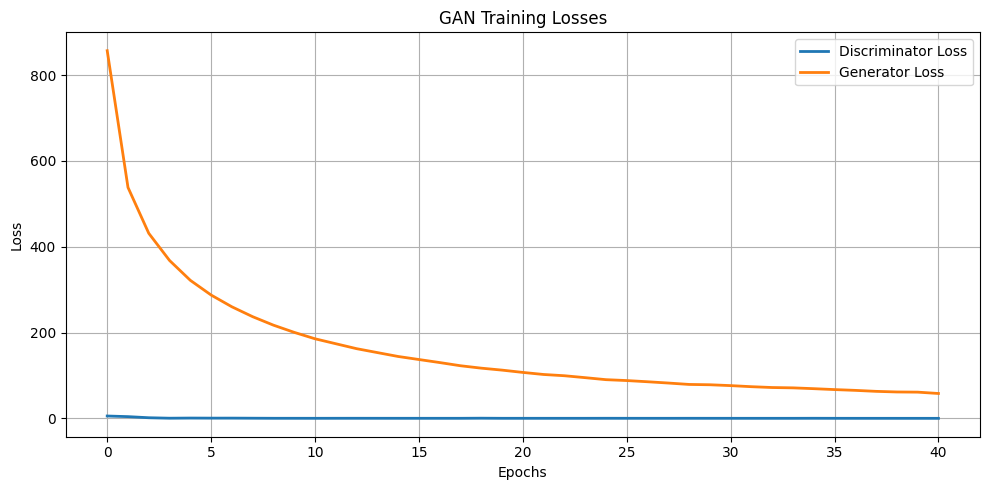

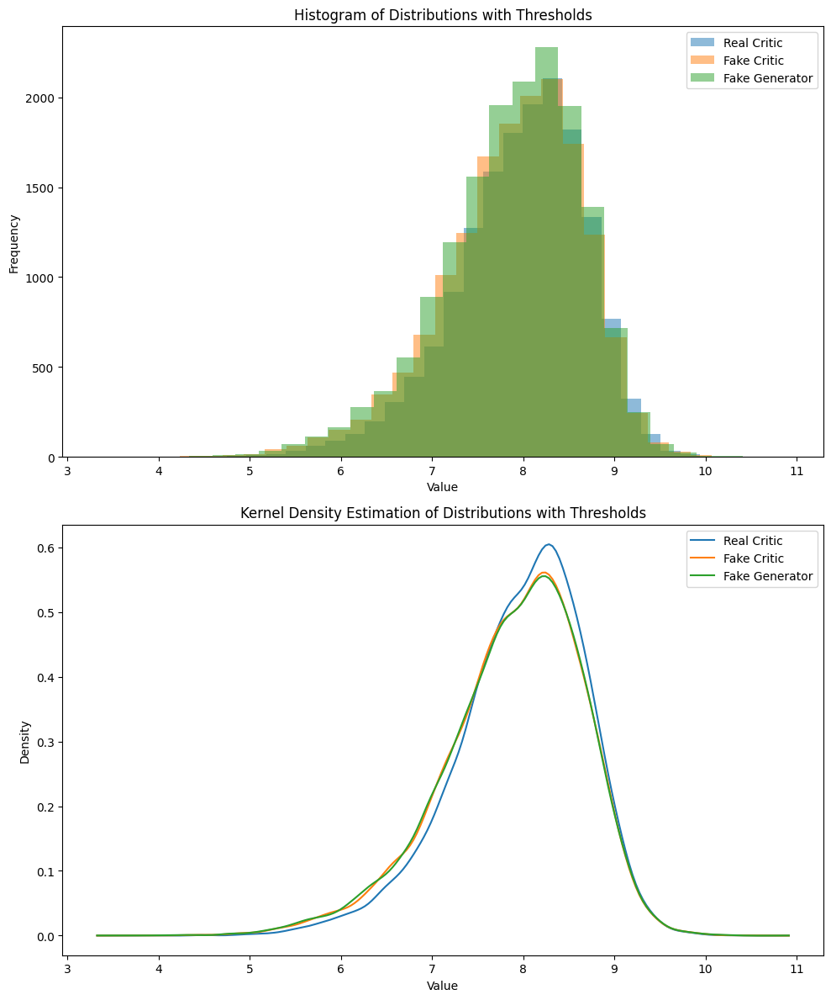

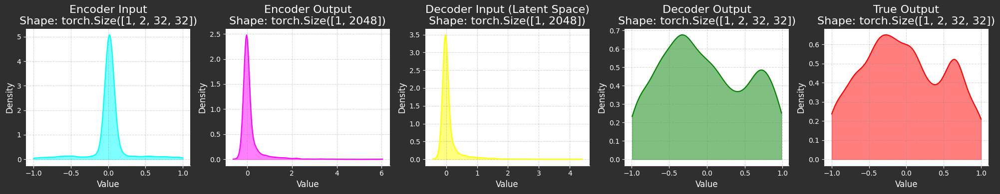

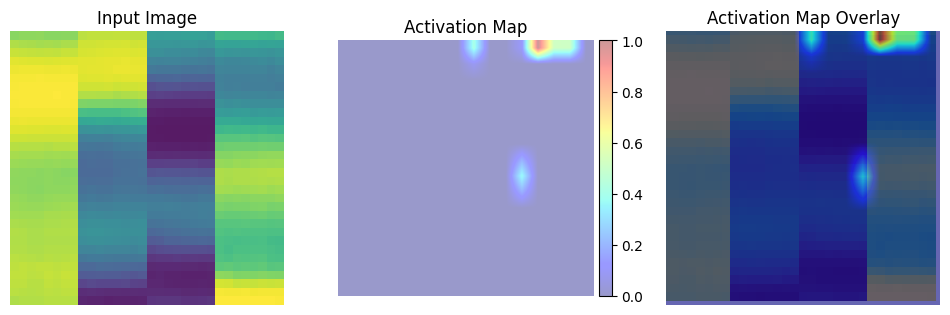

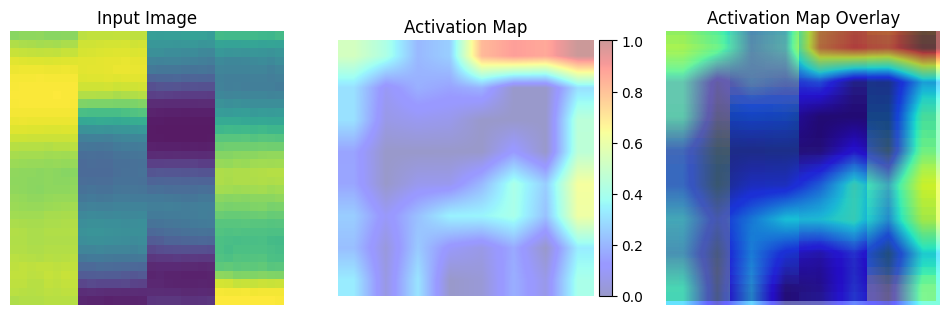

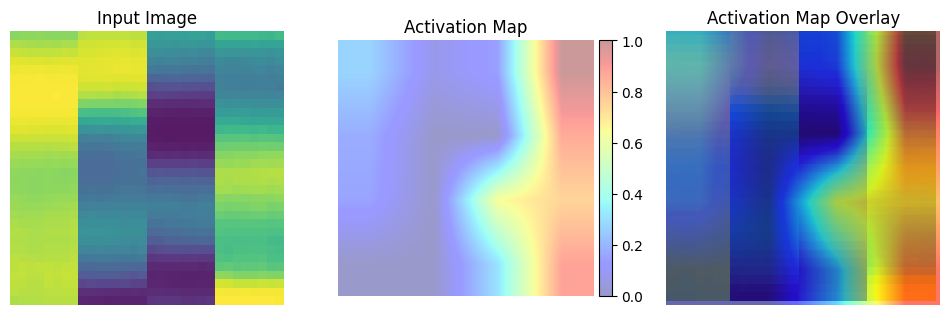

	MNSE Score: 0.007935855205037765
Batch [0/63] -  Critic loss:  0.03950260331233343 - generator loss:  56.22480392456055
Batch [21/63] -  Critic loss:  -0.04541676584631205 - generator loss:  57.49762743169611
Batch [42/63] -  Critic loss:  -0.04344596095787463 - generator loss:  57.095073167667834
	Epoch 41 - critic loss: -0.04661390207037725 - generator loss: 56.98037423027886
Batch [0/63] -  Critic loss:  -0.08678467820088069 - generator loss:  51.86565399169922
Batch [21/63] -  Critic loss:  -0.06459583127588936 - generator loss:  56.30055878379128
Batch [42/63] -  Critic loss:  -0.06052397760425428 - generator loss:  55.03797389185706
	Epoch 42 - critic loss: -0.048649419572145206 - generator loss: 55.10820073930044
	MNSE Score: 0.007660309488456401
Batch [0/63] -  Critic loss:  -0.12119188408056895 - generator loss:  50.29129409790039
Batch [21/63] -  Critic loss:  -0.05871332414222486 - generator loss:  51.891320488669656
Batch [42/63] -  Critic loss:  -0.06921309440634972 - gen

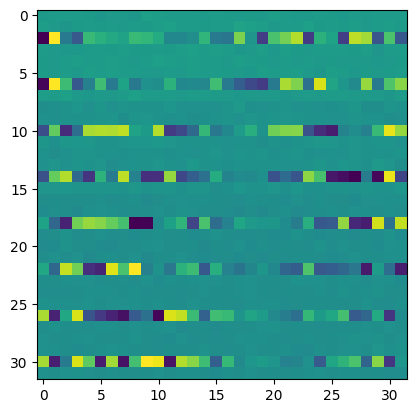

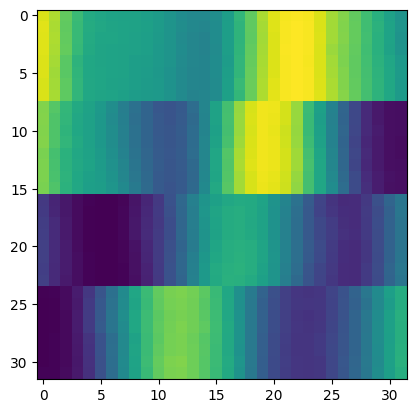

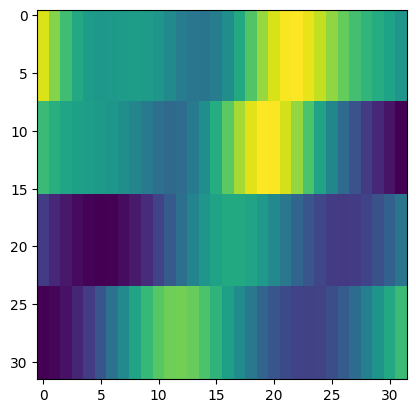

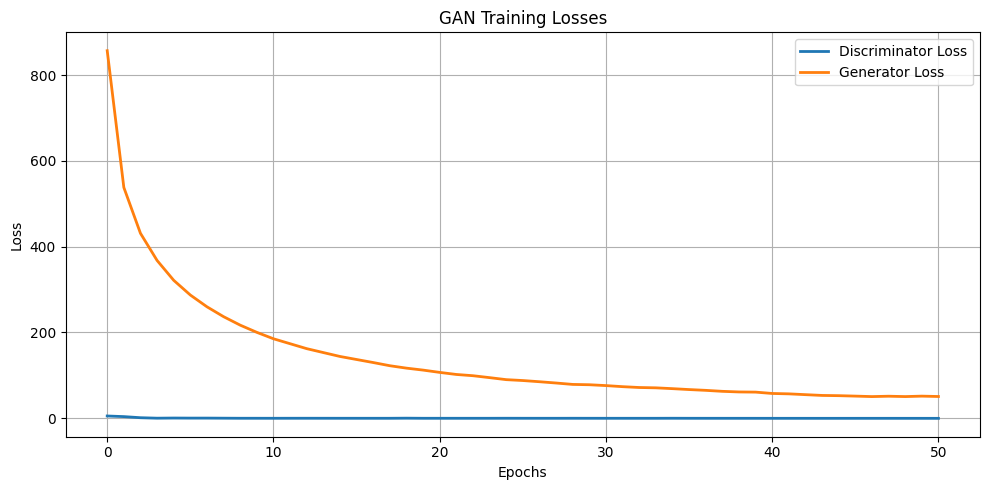

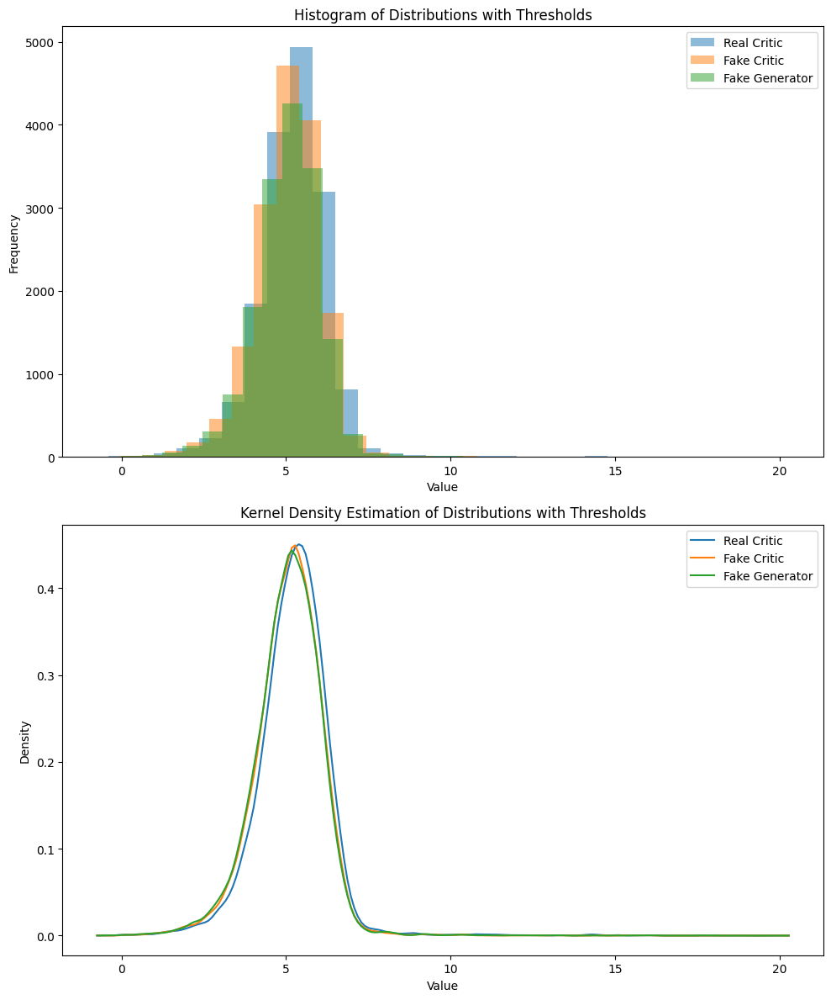

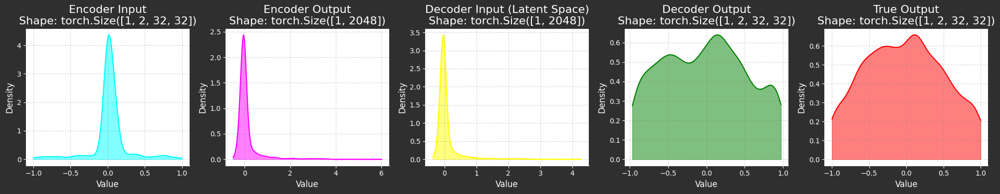

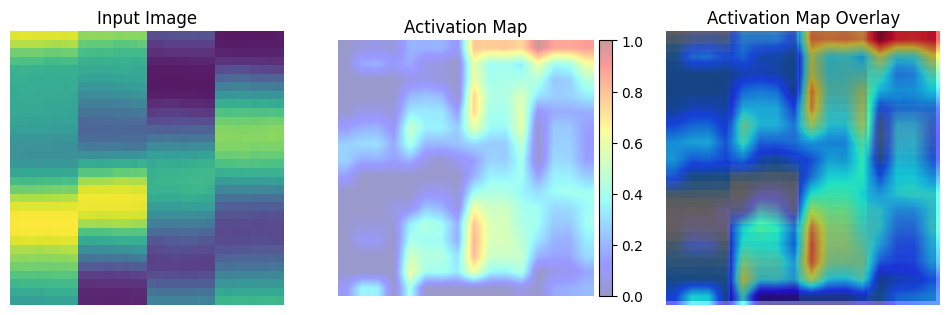

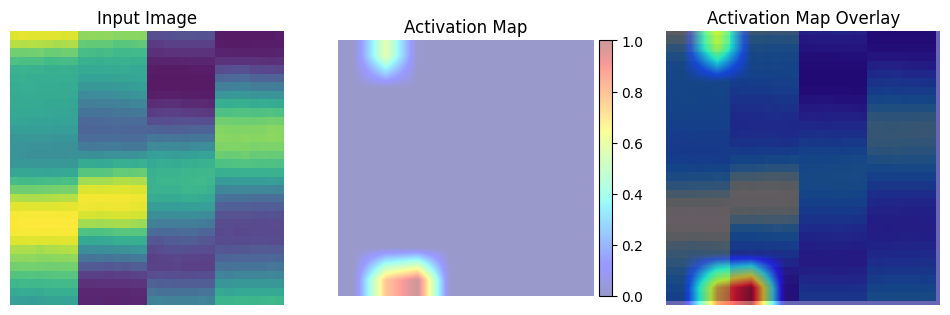

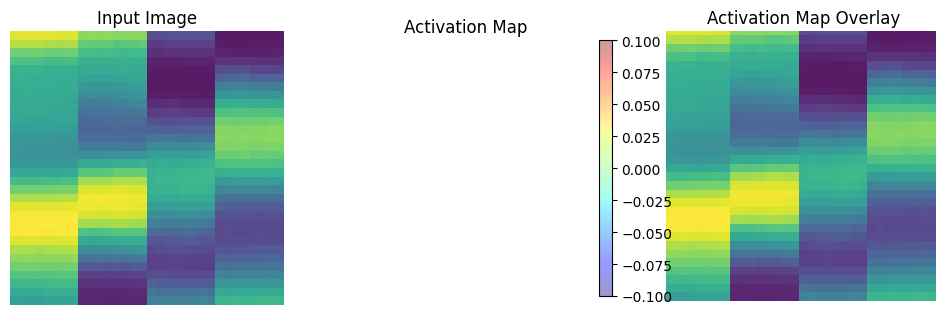

	MNSE Score: 0.006415139610273024
Batch [0/63] -  Critic loss:  -0.22314059734344482 - generator loss:  55.178955078125
Batch [21/63] -  Critic loss:  -0.08389942991462622 - generator loss:  52.67888988148082
Batch [42/63] -  Critic loss:  -0.09750659030306248 - generator loss:  53.14837477927984
	Epoch 51 - critic loss: -0.10268174722869561 - generator loss: 52.861319647894966
Batch [0/63] -  Critic loss:  -0.10205317785342534 - generator loss:  45.94332504272461
Batch [21/63] -  Critic loss:  -0.10295700171793049 - generator loss:  52.09266177090731
Batch [42/63] -  Critic loss:  -0.1120967993931484 - generator loss:  51.692080120707665
	Epoch 52 - critic loss: -0.11006812639928684 - generator loss: 52.321322728717135
	MNSE Score: 0.006131269909914524
Batch [0/63] -  Critic loss:  0.04949407776196798 - generator loss:  62.46025466918945
Batch [21/63] -  Critic loss:  -0.11848984063236102 - generator loss:  54.08854935385964
Batch [42/63] -  Critic loss:  -0.11839655999007616 - genera

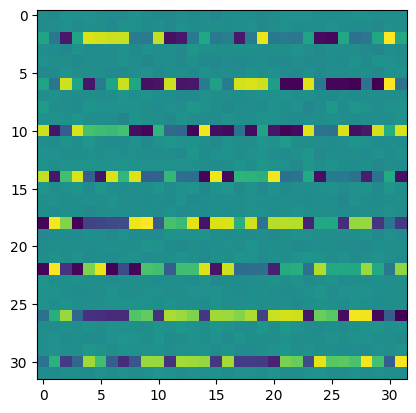

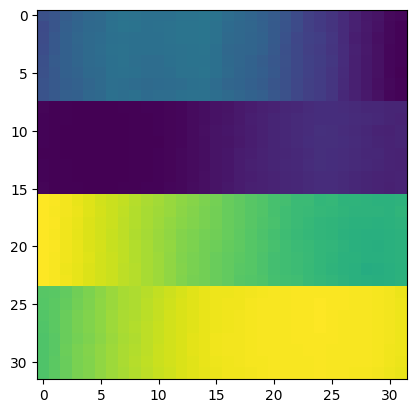

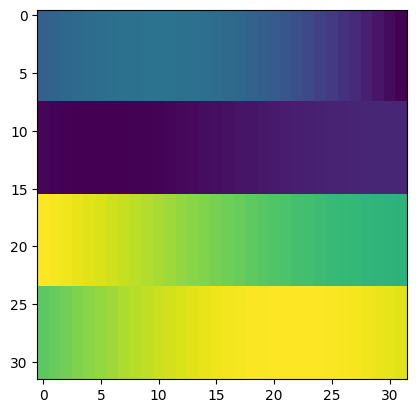

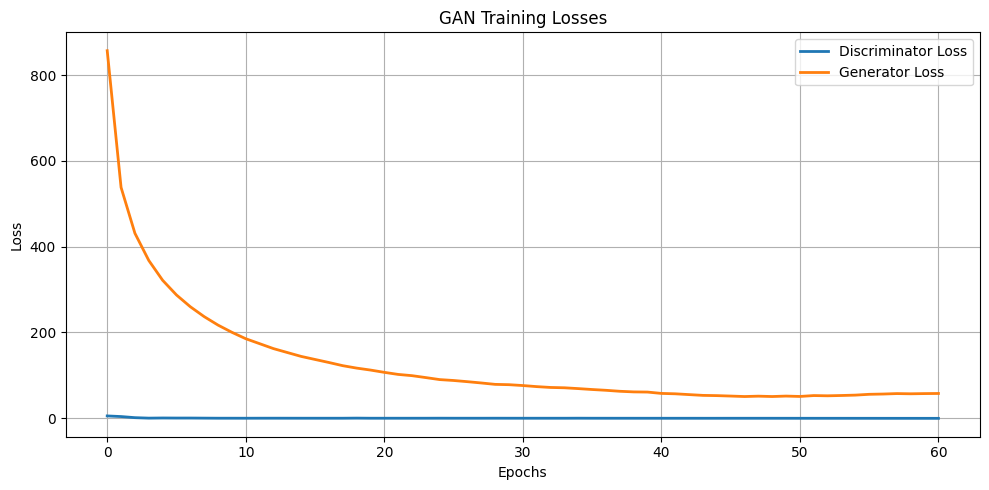

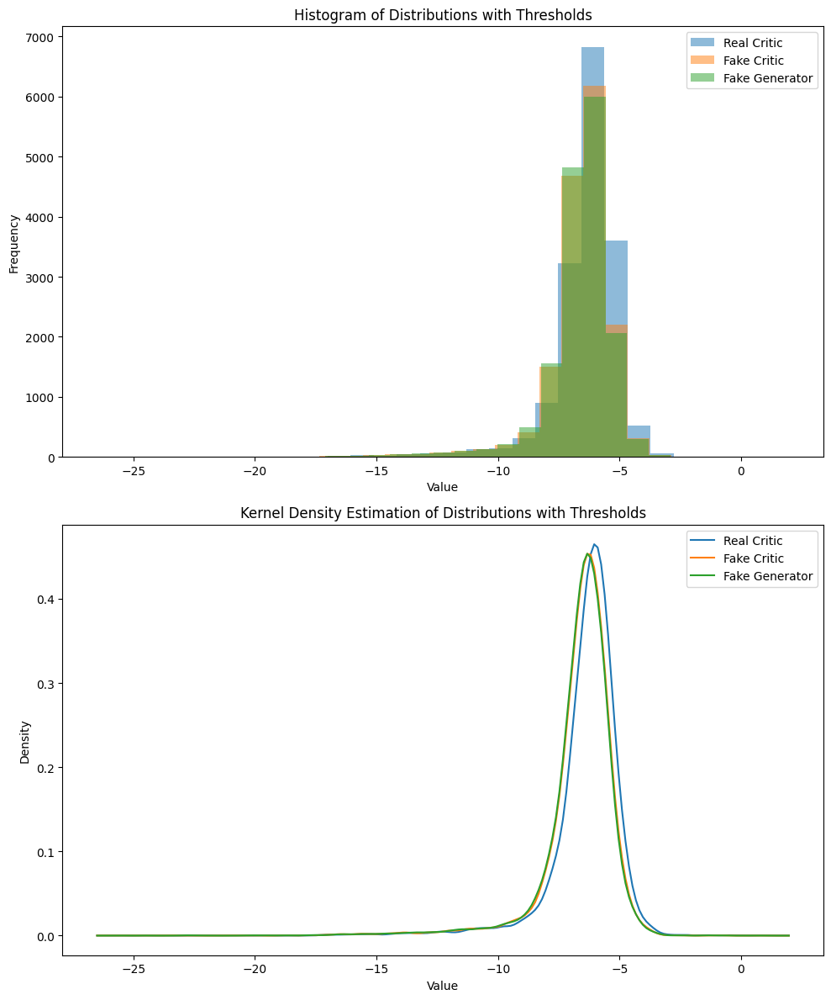

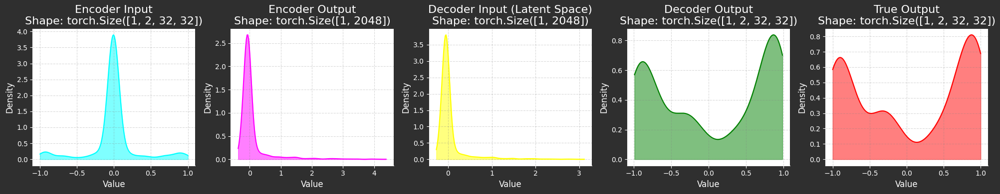

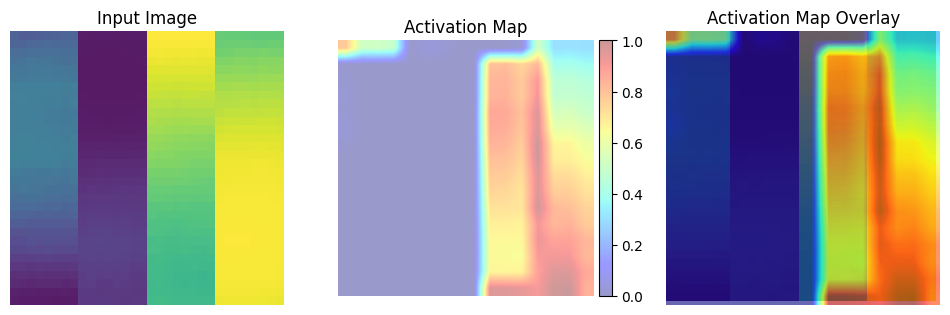

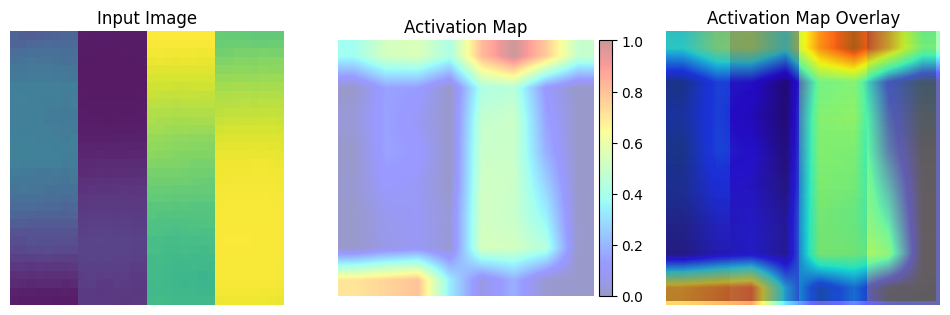

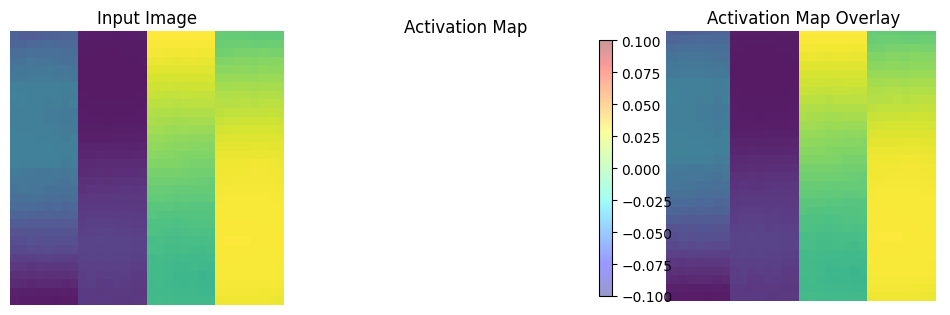

Batch [0/63] -  Critic loss:  -0.2643349965413411 - generator loss:  54.60255432128906
Batch [21/63] -  Critic loss:  -0.23016595806587825 - generator loss:  58.34992148659446
Batch [42/63] -  Critic loss:  -0.2394469942348872 - generator loss:  58.1099071946255
	Epoch 61 - critic loss: -0.2413905009075448 - generator loss: 57.8059324234251
	MNSE Score: 0.00568065152222675
Batch [0/63] -  Critic loss:  -0.16491243739922842 - generator loss:  60.03853225708008
Batch [21/63] -  Critic loss:  -0.24432013590227478 - generator loss:  58.24312816966664
Batch [42/63] -  Critic loss:  -0.24622887754163078 - generator loss:  57.340591164522394
	Epoch 62 - critic loss: -0.2508487248862231 - generator loss: 57.33510153634207
	MNSE Score: 0.005515510105483588
Batch [0/63] -  Critic loss:  -0.2821291188398997 - generator loss:  51.41920852661133
Batch [21/63] -  Critic loss:  -0.27017540518533106 - generator loss:  56.665388800881125
Batch [42/63] -  Critic loss:  -0.2682383470526037 - generator lo

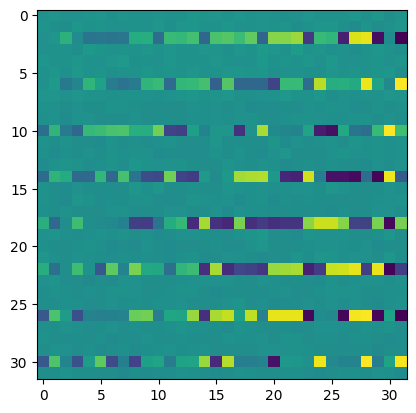

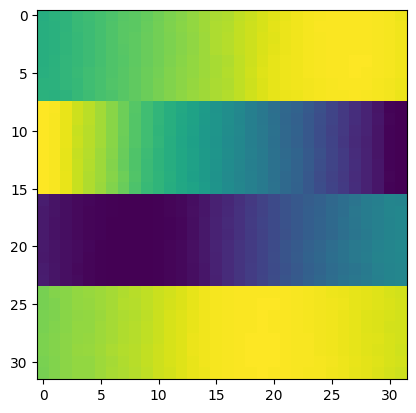

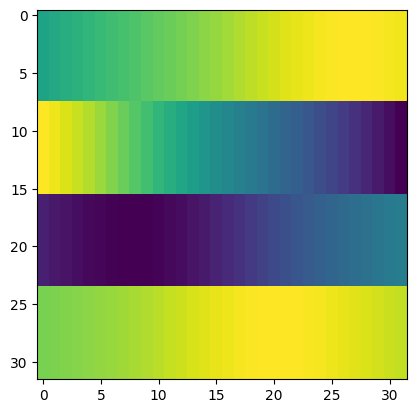

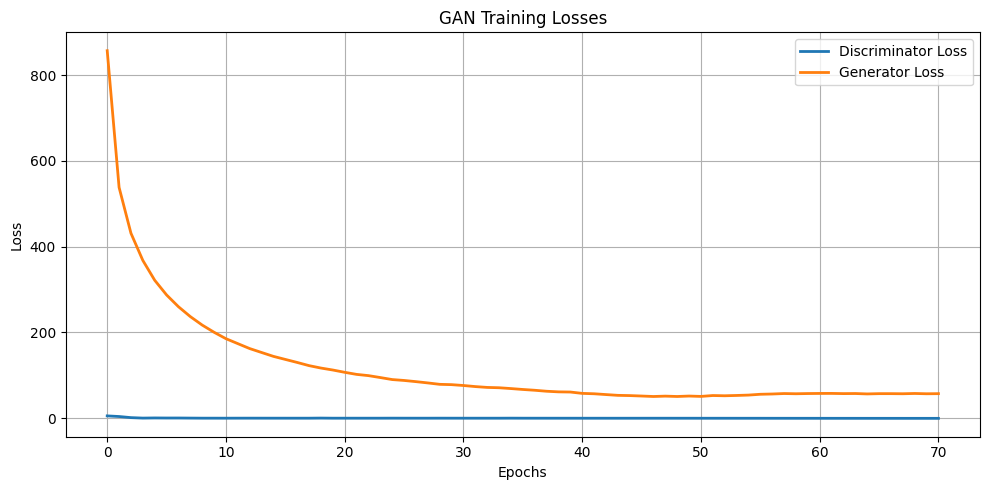

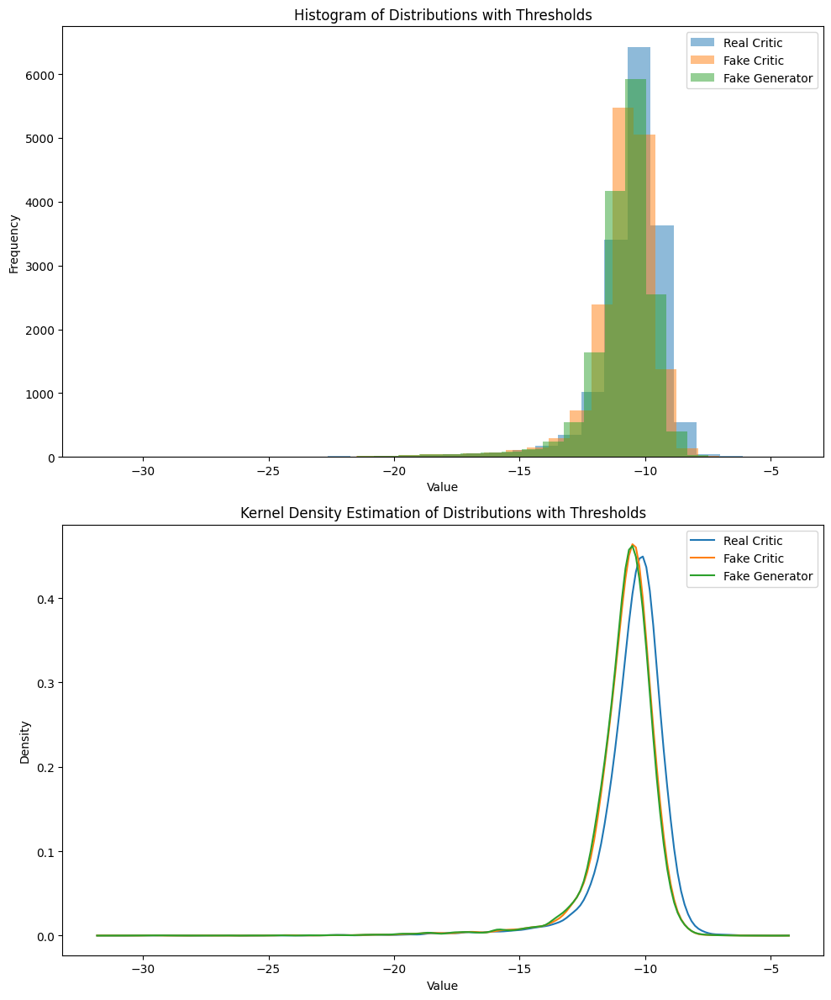

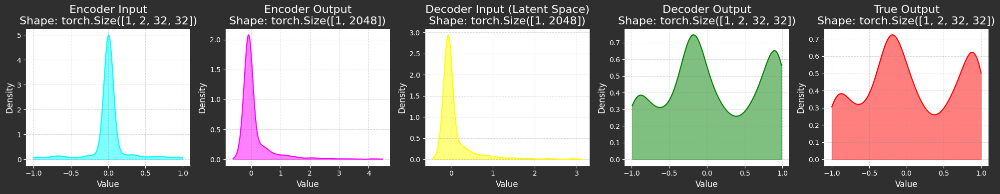

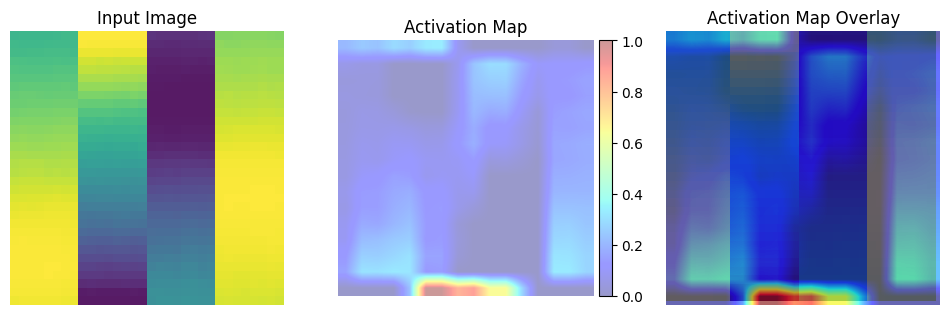

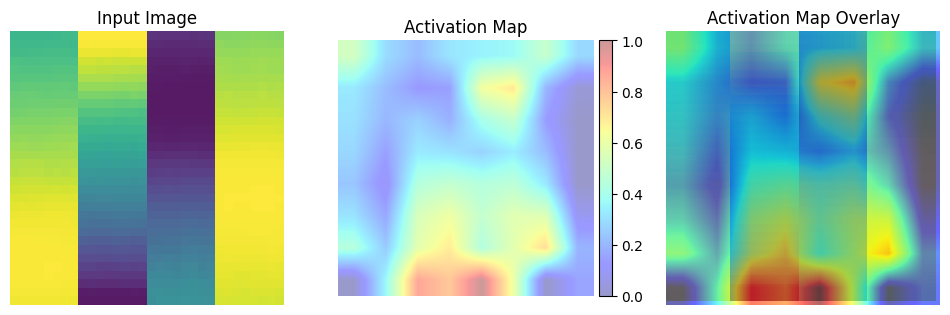

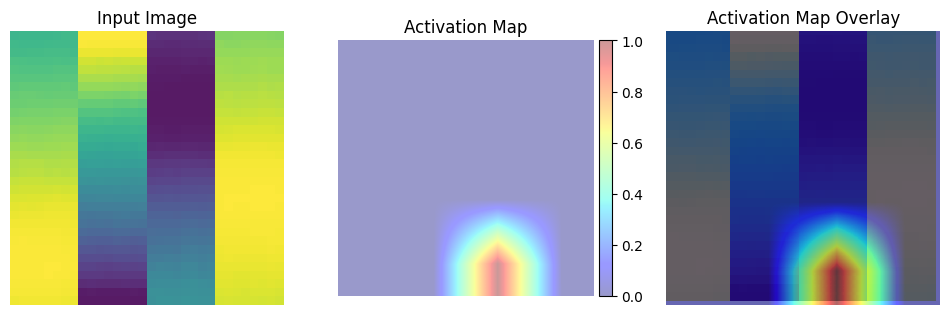

Batch [0/63] -  Critic loss:  -0.270581990480423 - generator loss:  56.54812240600586
Batch [21/63] -  Critic loss:  -0.3086620729529496 - generator loss:  56.6288816278631
Batch [42/63] -  Critic loss:  -0.3084987388100735 - generator loss:  56.08672510191452
	Epoch 71 - critic loss: -0.3143932849326461 - generator loss: 56.52504657563709
	MNSE Score: 0.005062858537135143
Batch [0/63] -  Critic loss:  -0.24606738984584808 - generator loss:  60.01738739013672
Batch [21/63] -  Critic loss:  -0.3118062653776371 - generator loss:  56.141336094249375
Batch [42/63] -  Critic loss:  -0.31524080754250516 - generator loss:  55.875712461249776
	Epoch 72 - critic loss: -0.313968698499064 - generator loss: 56.19618158491831
	MNSE Score: 0.00501839140991843
Batch [0/63] -  Critic loss:  -0.33612919847170514 - generator loss:  55.95012283325195
	Epoch 79 - critic loss: -0.3227697818604095 - generator loss: 54.38338664221385
	MNSE Score: 0.004431698234781387
Batch [0/63] -  Critic loss:  -0.31710642

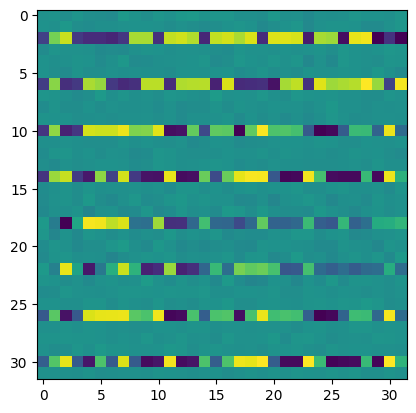

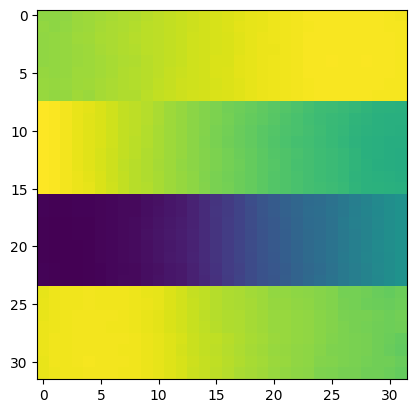

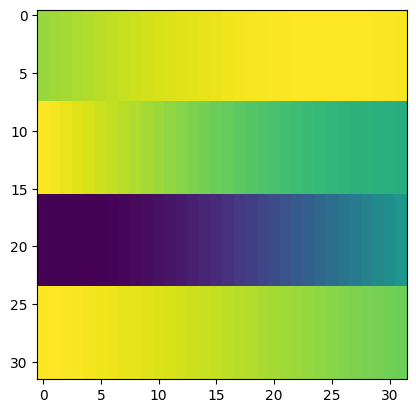

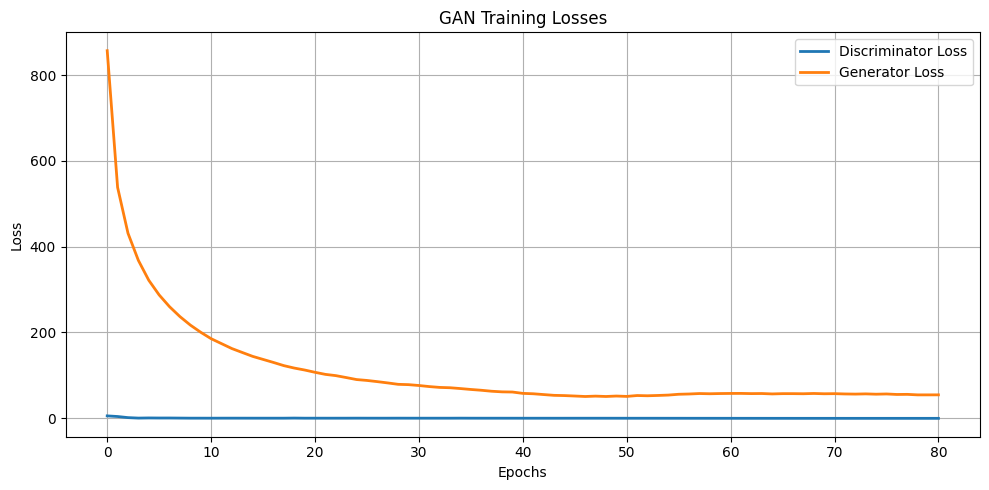

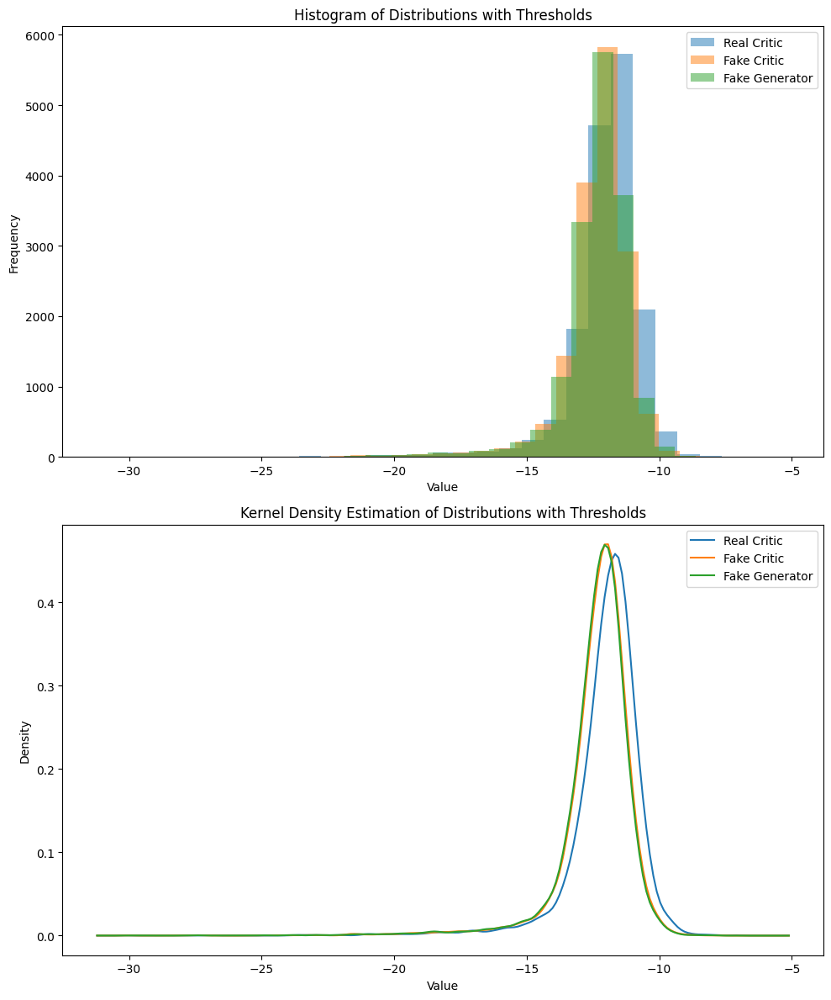

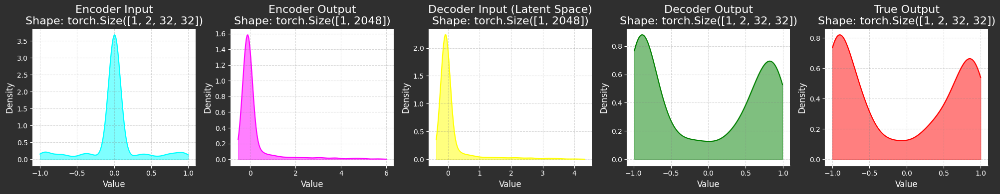

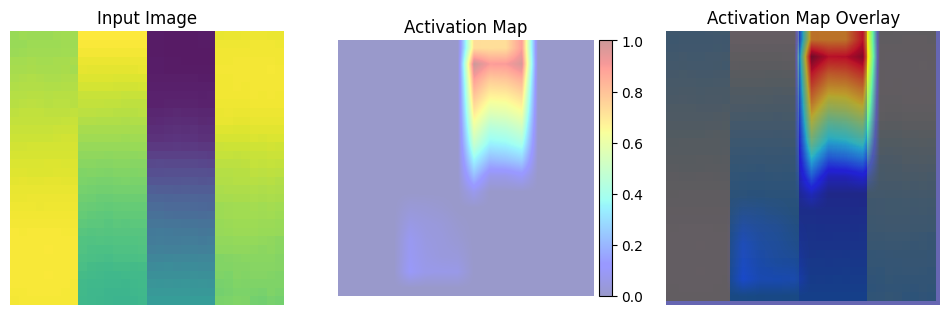

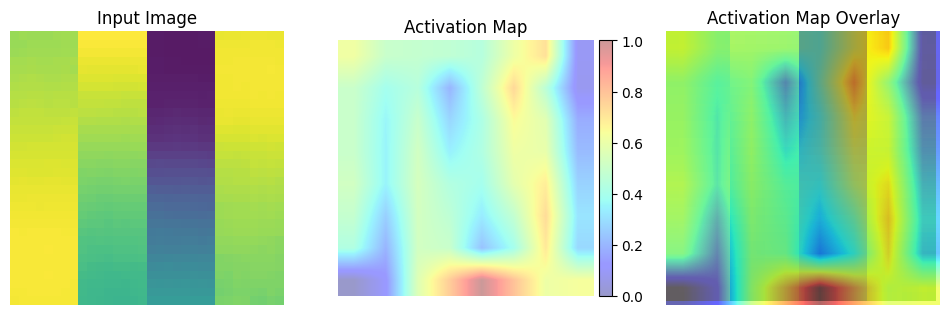

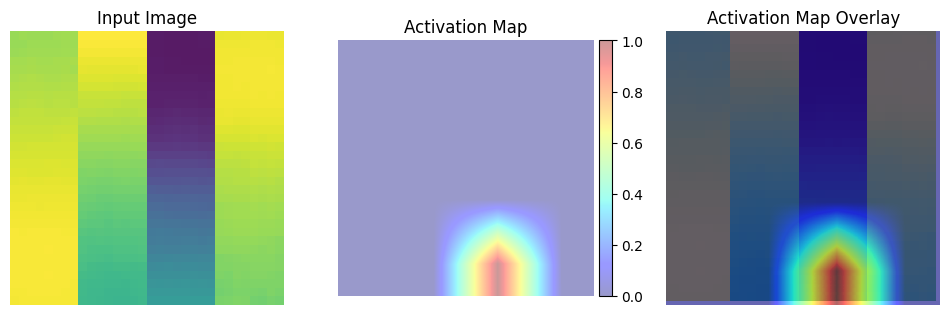

Batch [0/63] -  Critic loss:  -0.32165412108103436 - generator loss:  49.13426208496094
Batch [21/63] -  Critic loss:  -0.3062778222515728 - generator loss:  54.087084856900304
Batch [42/63] -  Critic loss:  -0.3071555144680562 - generator loss:  54.66118408912836
	Epoch 81 - critic loss: -0.3127119658248764 - generator loss: 54.622922867063494
Batch [0/63] -  Critic loss:  -0.2780699034531911 - generator loss:  49.27849578857422
Batch [21/63] -  Critic loss:  -0.3172892508181659 - generator loss:  54.09362203424627
Batch [42/63] -  Critic loss:  -0.31681857587293144 - generator loss:  53.996781637502274
	Epoch 82 - critic loss: -0.3223921375142204 - generator loss: 53.596665821378195
	MNSE Score: 0.004352850961454567
Batch [0/63] -  Critic loss:  -0.23811876773834229 - generator loss:  70.81917572021484
Batch [21/63] -  Critic loss:  -0.3136872223606616 - generator loss:  55.11368387395685
Batch [42/63] -  Critic loss:  -0.317491408639638 - generator loss:  53.92875156846157
	Epoch 83

In [255]:
channel_est_wgan_gp_vae_multi_antenna()

## VAE + WGAN-GP + Skewness loss

In [256]:
vae = VAE(z_dim=z_dim, mu_h=MU_H, std_h=STD_H).to(device)
critic = Critic().to(device)

# Initialize weights
vae = vae.apply(weights_init)
critic = critic.apply(weights_init)

# Optimizer is Adam help converge faster and more stable
vae_opt = torch.optim.Adam(vae.parameters(), lr=lr, betas=betas)
c_opt = torch.optim.Adam(critic.parameters(), lr=lr, betas=betas)

skew_cal = SkewCalculator(device)

save_results = "channel_est_wgan_gp_vae_skew_multi_antenna"

In [257]:
def channel_est_wgan_gp_vae_threwness():
    save_results = "channel_est_wgan_gp_vae_skew_multi_antenna"
    min_nmse_scores = 10000000
    total_g_losses = []
    total_c_losses = []
    total_nmse_scores = []
    total_skewness = []
    for epoch in range(n_epochs):
        # Training
        g_losses = 0
        c_losses = 0
        g_skewness = 0
        nmse_scores = 0
        total_critic_reals = []
        total_critic_fakes = []
        total_generator_fakes = []

        vae.train()
        critic.train()
        for batch_index, (real, label) in enumerate(train_dataset):

            real = real.to(device)
            label = label.to(device)
            cur_batch_size = real.shape[0]
            #################
            # Update critic #
            #################
            total_c_repeat_losses = 0
            critic_reals = 0
            critic_fakes = 0
            for _ in range(critic_repeats):
                c_opt.zero_grad()


                # Forward pass
                fake, *values = vae(label)

                # critic loss
                critic_real = critic(real)
                critic_fake = critic(fake)

                c_repeat_loss = - (torch.mean(critic_real) - torch.mean(critic_fake))

                # gp loss
                gp_loss = gradient_penalty_loss(critic=critic, real=real, fake=fake)

                # total critic loss
                total_c_repeat_loss = c_repeat_loss + c_lambda * gp_loss
                # Update gradients
                total_c_repeat_loss.backward(retain_graph=True)

                # Update optimizer
                c_opt.step()

                # Keep track of the average critic loss in this batch
                critic_reals += critic_real.detach().cpu()
                critic_fakes += critic_fake.detach().cpu()

                total_c_repeat_losses += total_c_repeat_loss.detach().cpu().item()

            total_critic_reals.append((critic_reals / critic_repeats).view(-1))
            total_critic_fakes.append((critic_fakes / critic_repeats).view(-1))
            c_losses += total_c_repeat_losses / critic_repeats

            ####################
            # Update generator #
            ####################
            vae_opt.zero_grad()

            # get noise
            # Forward pass
            fake_2, *values = vae(label)

            # Compute loss
            v_loss, *values = vae_loss(fake_2, real, *values)


            critic_fake_2 = critic(fake_2)

            skew_loss_2 = l2_loss(skew_cal(real.view(real.size(0), -1)),skew_cal(fake_2.view(fake_2.size(0), -1)))

            g_loss = - torch.mean(critic_fake_2) + skew_loss_2 + v_loss


            # Update gradients
            g_loss.backward()

            # Update the weights
            vae_opt.step()

            g_losses += g_loss.detach().cpu().item()
            total_generator_fakes.append(critic_fake_2.detach().cpu().view(-1))
            g_skewness += skew_loss_2.detach().cpu().item()

            if batch_index % (len(train_dataset) // 3) == 0:
                print(f"Batch [{batch_index}/{len(train_dataset)}] - ",  "Critic loss: ",  c_losses / (batch_index + 1), "- generator loss: ", g_losses / (batch_index + 1))

            nmse_score = nmse_func(
                pred=fake.permute(0, 2, 3, 1).detach().cpu(),
                target=real.permute(0, 2, 3, 1).detach().cpu(),
            )
            nmse_scores += nmse_score

        total_nmse_scores.append(nmse_scores / len(train_dataset))
        total_c_losses.append(c_losses / len(train_dataset))
        total_g_losses.append(g_losses / len(train_dataset))
        total_skewness.append(g_skewness / len(train_dataset))


        print(f"\tEpoch {epoch} - critic loss: {total_c_losses[-1]} - generator loss: {total_g_losses[-1]}")

        vae.eval()
        critic.eval()
        # Visualize Test Dataset
        with torch.no_grad():
            for real, label in eval_dataset:
                cur_batch_size = real.shape[0]
                real = real.to(device)
                label = label.to(device)
                fake, *values = vae(label)
                _, _, (input_decoder, output_encoder) = values
                break
        if epoch in range(0, n_epochs, int(n_epochs // 10)):
            show_tensor_images(label[0,0,:,:].T)
            show_tensor_images(fake[0,0,:,:].T)
            show_tensor_images(real[0,0,:,:].T)
            show_loss_images(total_c_losses, total_g_losses)

            # grad_cam = GradCam(critic, critic.critic[-3])
            # grad_cam_1 = GradCam(critic, critic.critic[-2])
            # grad_cam_2 = GradCam(critic, critic.critic[-1])
            # grad_cam.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_1_epoch{epoch}.png")
            # grad_cam_1.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_2_epoch{epoch}.png")
            # grad_cam_2.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_3_epoch{epoch}.png")

            plot_distribution(
                np.array(torch.cat(total_critic_reals)),
                np.array(torch.cat(total_critic_fakes)),
                np.array(torch.cat(total_generator_fakes)),
                save_path=f"results/dis/{save_results}/dis_{epoch}.png"
            )
            plot_vae_in_out(label, fake, input_decoder, output_encoder, real)


            grad_cam = GradCam(critic, critic.critic[-3][0])
            grad_cam_1 = GradCam(critic, critic.critic[-2][0])
            grad_cam_2 = GradCam(critic, critic.critic[-1][0])
            grad_cam.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_1_epoch{epoch}.png")
            grad_cam_1.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_2_epoch{epoch}.png")
            grad_cam_2.visualize_cam(fake, save_path=f"results/dam/{save_results}/grad_cam_fake_conv_3_epoch{epoch}.png")


        if min_nmse_scores > min(total_nmse_scores):
            min_nmse_scores = min(total_nmse_scores)
            save_checkpoint(vae, f"results/checkpoint/{save_results}/g_model.pt")
            save_checkpoint(critic, f"results/checkpoint/{save_results}/d_model.pt")
            plot_generated_image(
                fake[0,0,:,:].T,
                test_input=label[0,0,:,:].T,
                tar=real[0,0,:,:].T,
                prefix=save_results,
            )
            print(f"\tMNSE Score: {min_nmse_scores}")

        plot_nmse_func(
            total_nmse_scores,
            range(epoch + 1),
            img_path=f"results/nmse/{save_results}/nmse.png",
        )
        plot_loss_func(
            total_c_losses,
            total_g_losses,
            range(epoch + 1),
            img_path=f"results/loss/{save_results}/loss.png",
        )

        plot_skewness_func(
            total_skewness,
            range(epoch + 1),
            img_path=f"results/skewness/{save_results}/skewness.png",
        )

    save_npy(f"results/nmse/{save_results}/nmse_scores.npy", np.array(total_nmse_scores))
    save_npy(f"results/loss/{save_results}/losses_d.npy", np.array(total_c_losses))
    save_npy(f"results/loss/{save_results}/losses_g.npy", np.array(total_g_losses))


Batch [0/63] -  Critic loss:  9.878575007120768 - generator loss:  1451.265625
Batch [21/63] -  Critic loss:  6.7636889941764595 - generator loss:  1097.0000582608309
Batch [42/63] -  Critic loss:  4.808105476142824 - generator loss:  951.6972116869549
	Epoch 0 - critic loss: 4.250067351356386 - generator loss: 862.5027514260913


/tmp/ipykernel_29/3193178299.py:57: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at /usr/local/src/pytorch/aten/src/ATen/native/ReduceOps.cpp:1808.)
  standardized_z = (output_encoder - torch.mean(output_encoder, dim=0)) / torch.std(output_encoder, dim=0)


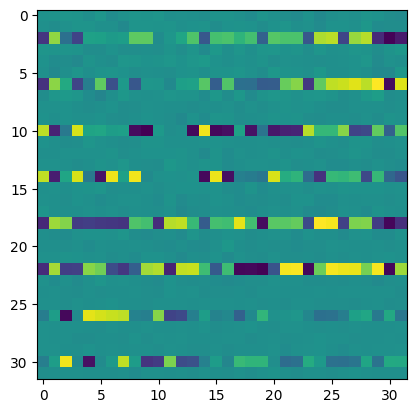

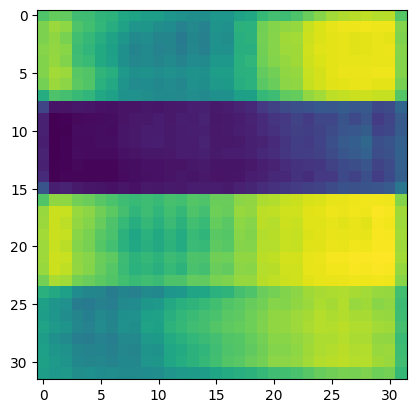

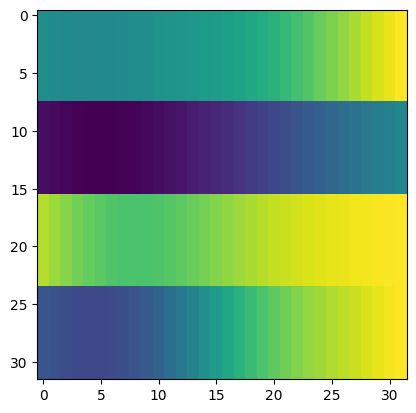

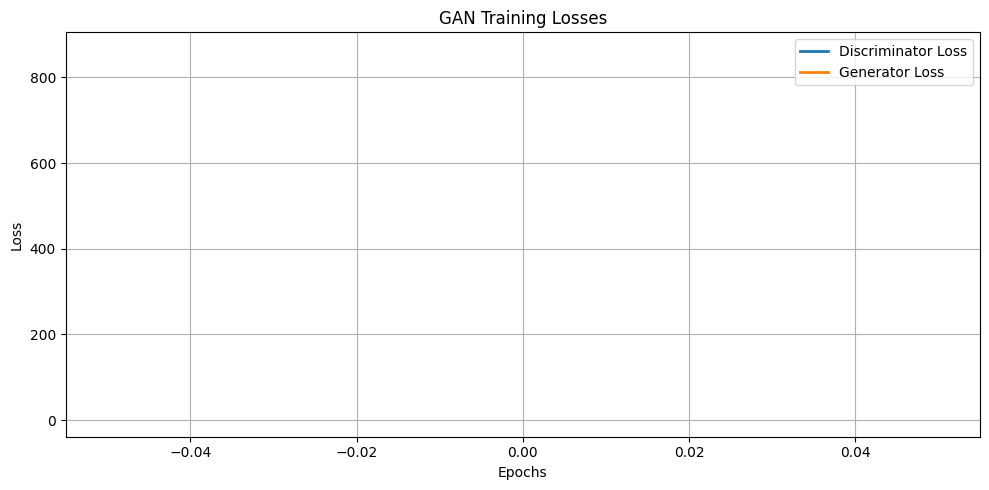

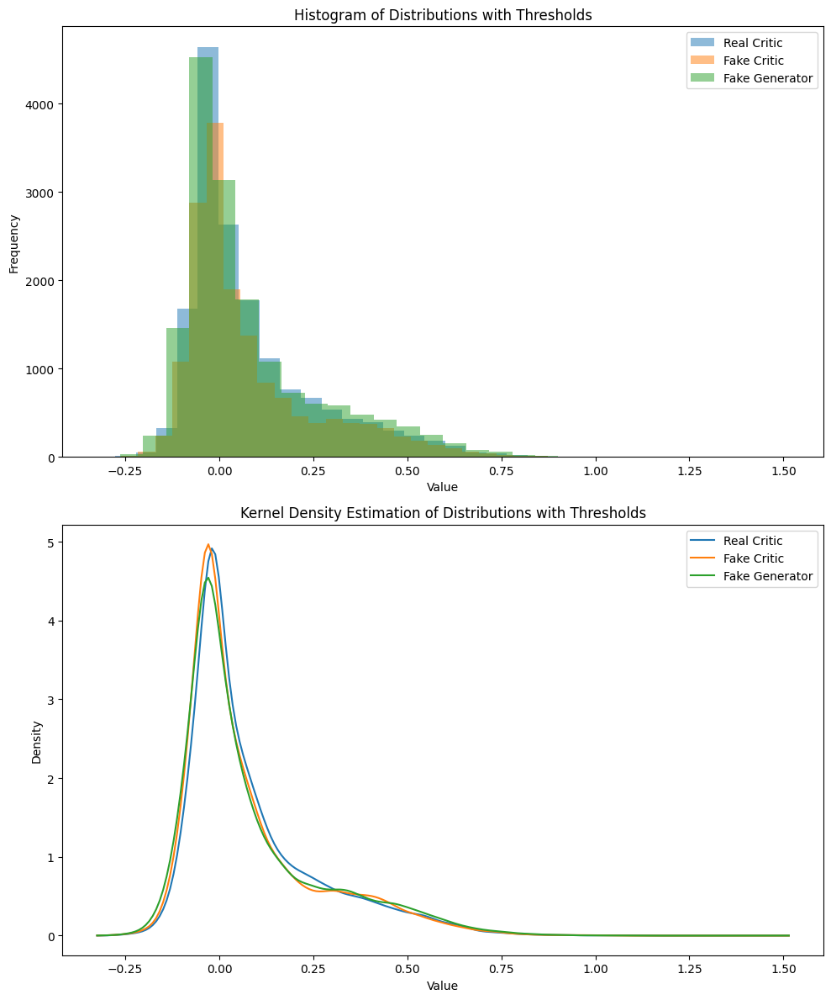

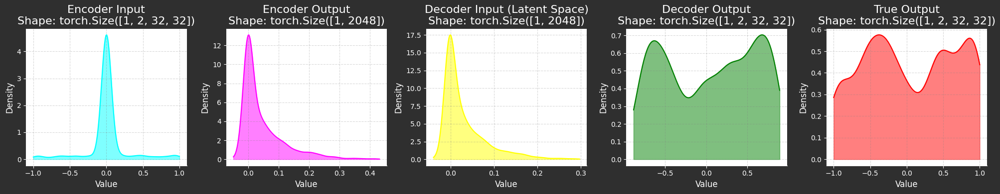

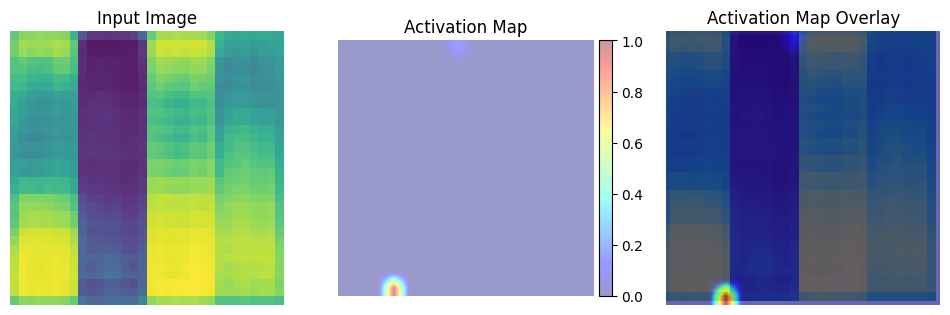

/tmp/ipykernel_29/1517990262.py:63: RuntimeWarning: invalid value encountered in divide
  activation_map = (activation_map - activation_map.min()) / (


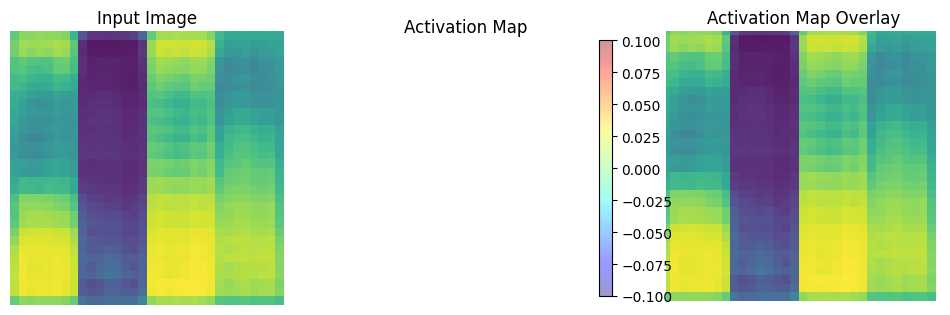

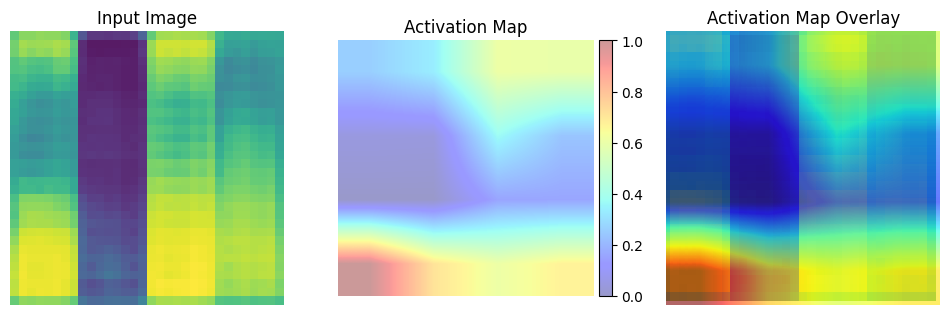

	MNSE Score: 0.42672362379611484
Batch [0/63] -  Critic loss:  2.8955623308817544 - generator loss:  618.8793334960938
Batch [21/63] -  Critic loss:  2.7832512494289516 - generator loss:  592.232987837358
Batch [42/63] -  Critic loss:  2.204488152681395 - generator loss:  567.012296454851
	Epoch 1 - critic loss: 2.00173481368514 - generator loss: 543.4888538178943
	MNSE Score: 0.11117418890907652
Batch [0/63] -  Critic loss:  0.9139503836631775 - generator loss:  481.6013488769531
Batch [21/63] -  Critic loss:  0.6913025302417349 - generator loss:  463.370341907848
Batch [42/63] -  Critic loss:  0.587659431058307 - generator loss:  448.40462192269257
	Epoch 2 - critic loss: 0.5737083257821499 - generator loss: 436.26273358057415
	MNSE Score: 0.06739929342080676
Batch [0/63] -  Critic loss:  0.662246584892273 - generator loss:  397.34515380859375
Batch [21/63] -  Critic loss:  0.435296047817577 - generator loss:  388.69346757368606
Batch [42/63] -  Critic loss:  0.3544944294894389 - gen

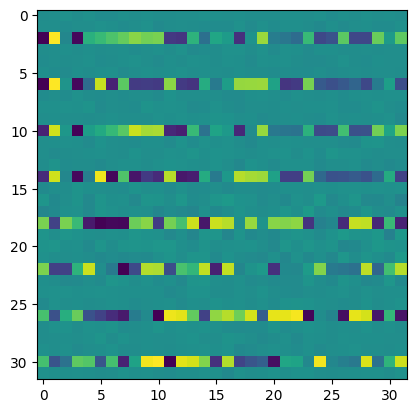

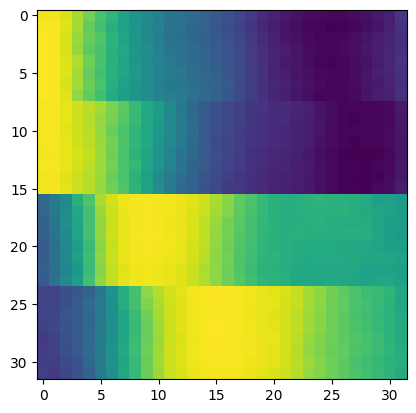

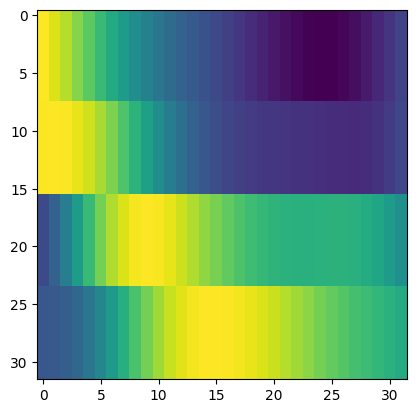

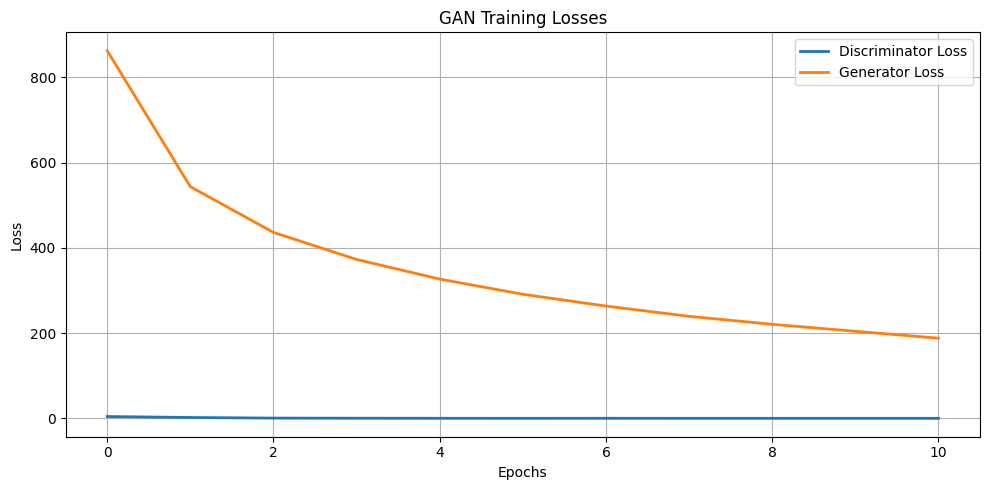

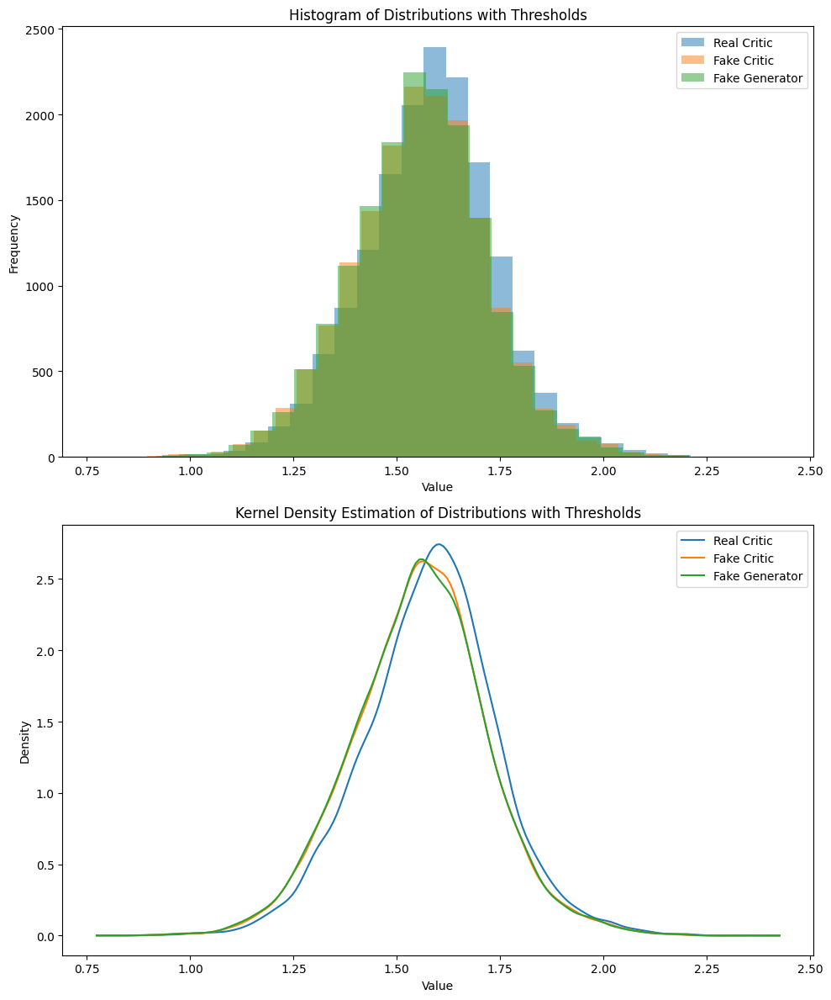

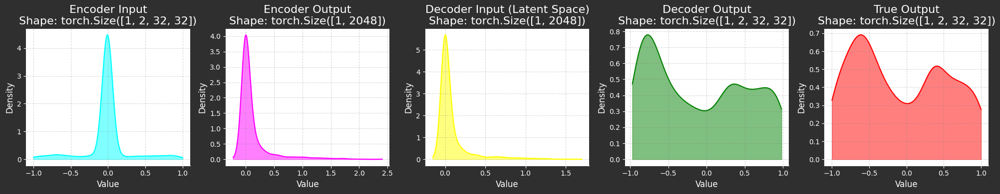

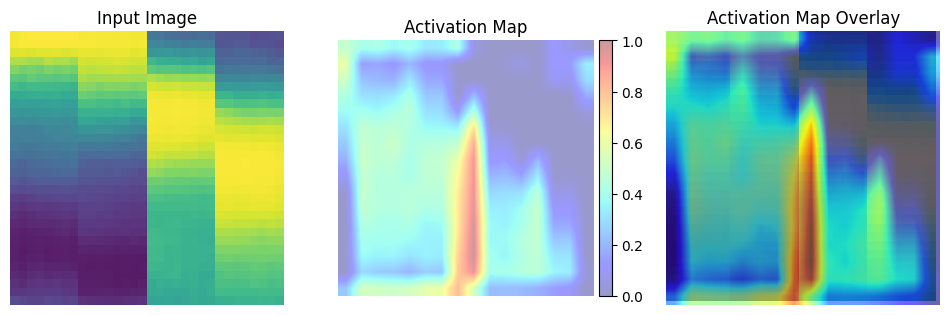

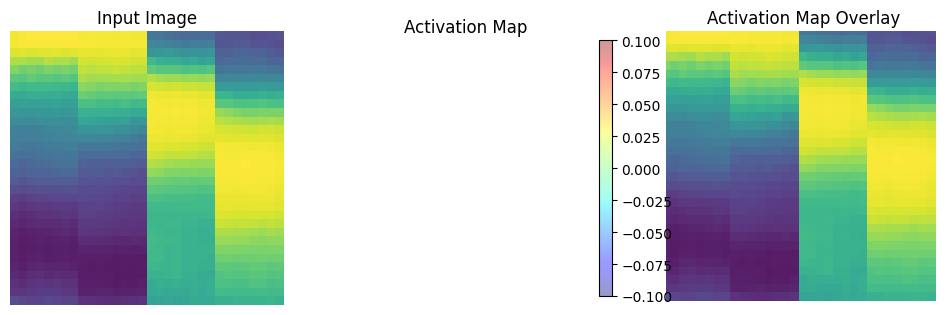

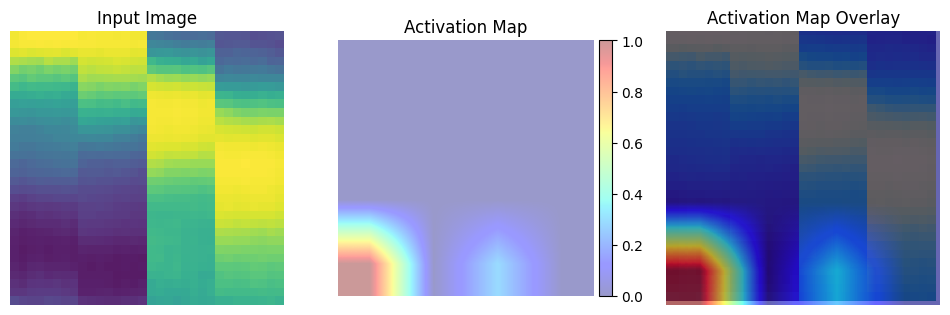

	MNSE Score: 0.020419838453923898
Batch [0/63] -  Critic loss:  -0.001906531552473704 - generator loss:  170.19078063964844
Batch [21/63] -  Critic loss:  0.002123024653304707 - generator loss:  180.75433141534978
Batch [42/63] -  Critic loss:  0.001261416909306548 - generator loss:  178.51599795319314
	Epoch 11 - critic loss: 0.015929696145196442 - generator loss: 177.28061203729538
	MNSE Score: 0.019938327253810943
Batch [0/63] -  Critic loss:  0.028891577074925106 - generator loss:  170.4677734375
Batch [21/63] -  Critic loss:  0.006847270453969637 - generator loss:  168.39409706809303
Batch [42/63] -  Critic loss:  0.0073895069748856285 - generator loss:  166.24024040754452
	Epoch 12 - critic loss: 0.005746134542047029 - generator loss: 164.87505231584822
	MNSE Score: 0.01792867205268334
Batch [0/63] -  Critic loss:  -0.021531324212749798 - generator loss:  151.16175842285156
Batch [21/63] -  Critic loss:  -0.016462507911703804 - generator loss:  157.27875934947622
Batch [42/63] - 

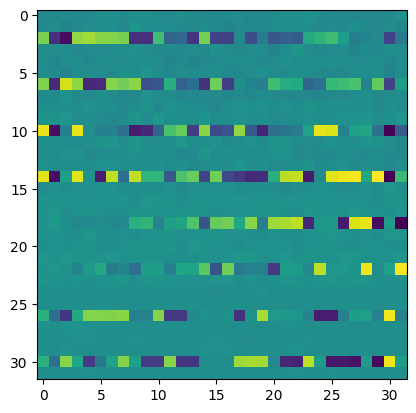

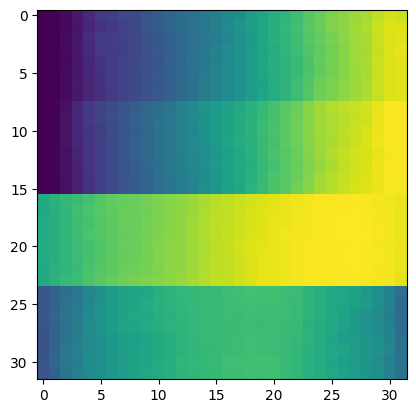

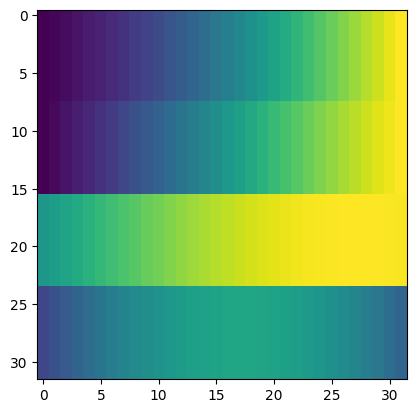

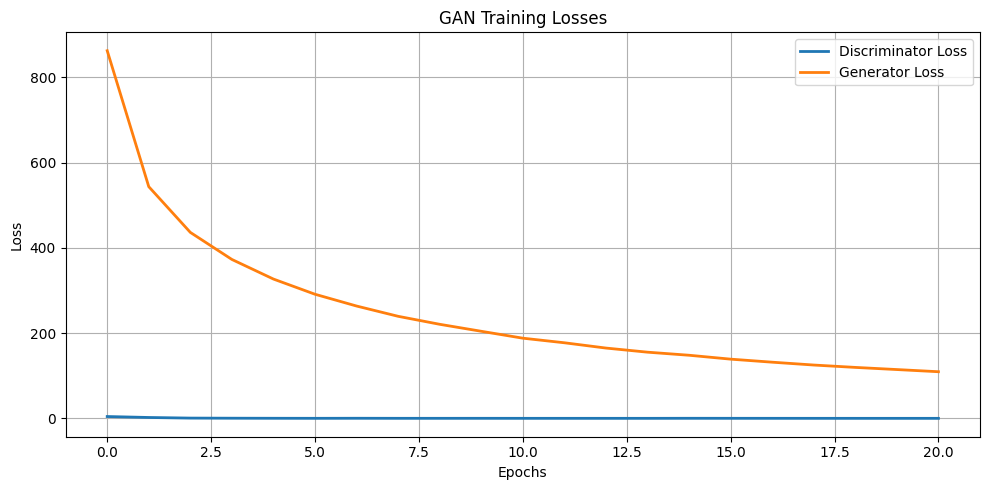

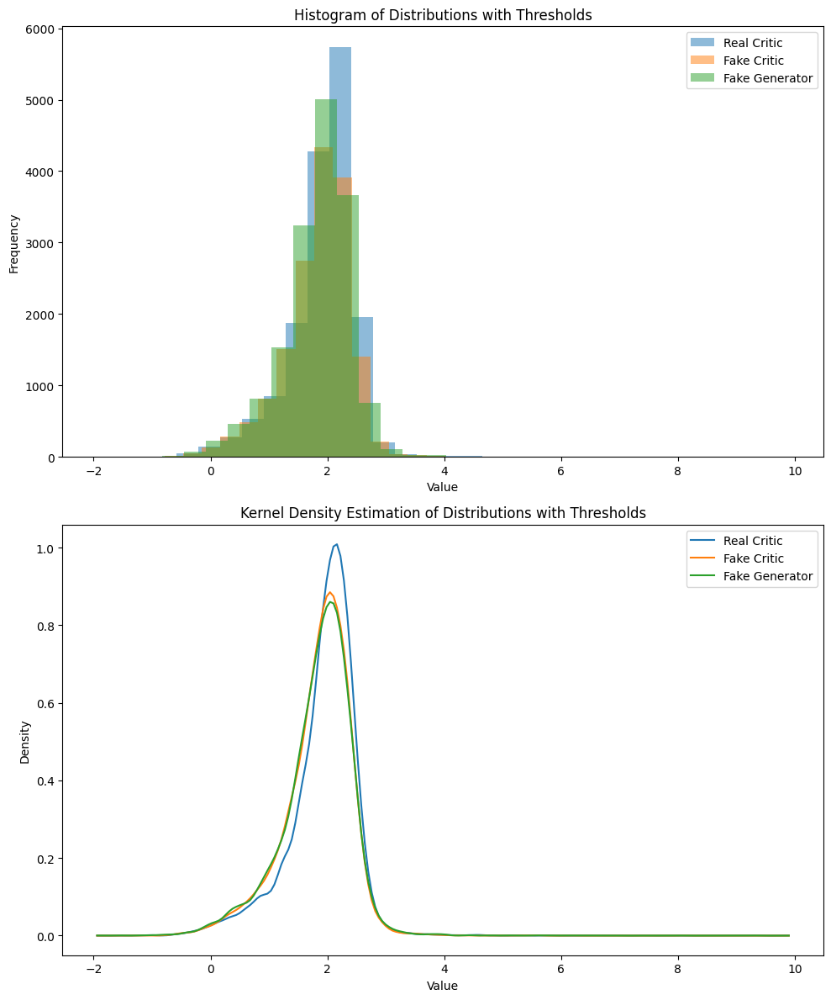

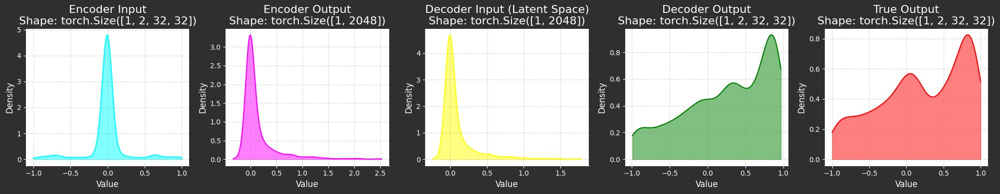

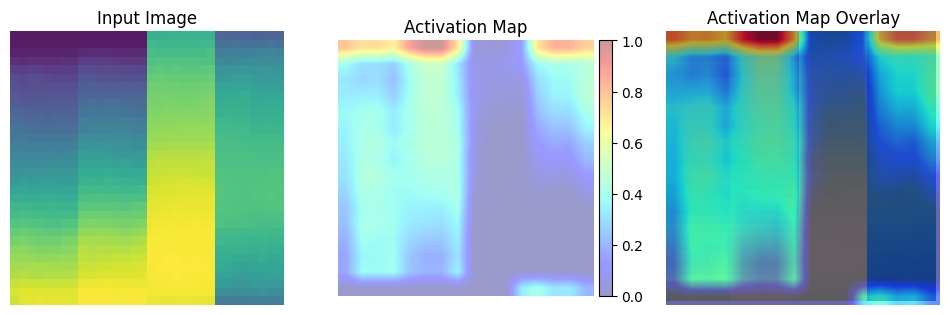

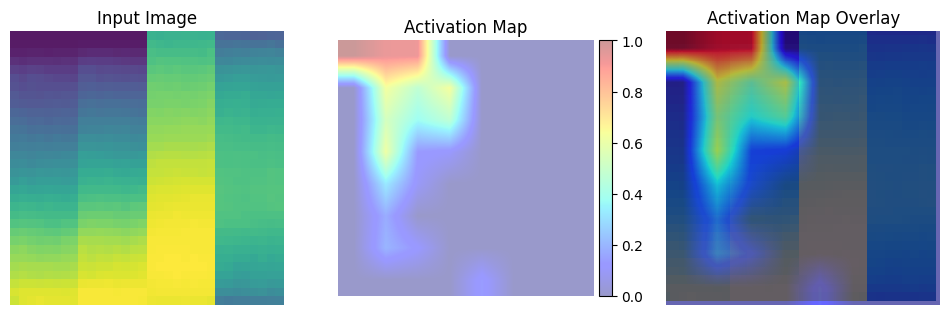

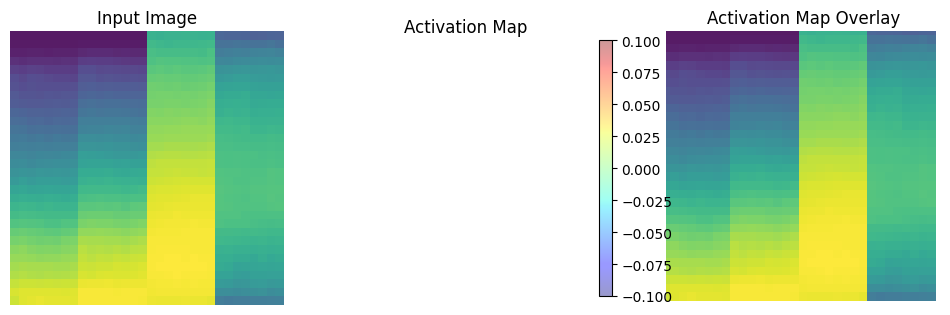

	MNSE Score: 0.01264819594484473
Batch [0/63] -  Critic loss:  0.12809755901495615 - generator loss:  103.49345397949219
Batch [21/63] -  Critic loss:  -0.05182925098095879 - generator loss:  107.5009106722745
Batch [42/63] -  Critic loss:  -0.0761768453747265 - generator loss:  106.82254507375318
	Epoch 21 - critic loss: -0.0996122118381281 - generator loss: 106.58834511893136
Batch [0/63] -  Critic loss:  -0.12896152337392172 - generator loss:  103.54340362548828
Batch [21/63] -  Critic loss:  -0.18367635842525595 - generator loss:  103.0148318897594
Batch [42/63] -  Critic loss:  -0.1990712092135304 - generator loss:  102.4560019914494
	Epoch 22 - critic loss: -0.20892475072353608 - generator loss: 101.6148921421596
	MNSE Score: 0.011616937357873197
Batch [0/63] -  Critic loss:  -0.2293293128410975 - generator loss:  98.23296356201172
Batch [21/63] -  Critic loss:  -0.2542650846369339 - generator loss:  101.33788264881481
Batch [42/63] -  Critic loss:  -0.26125467643719313 - generat

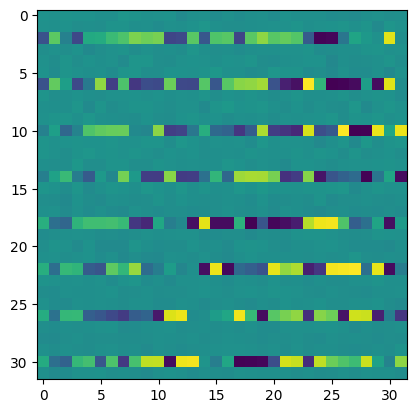

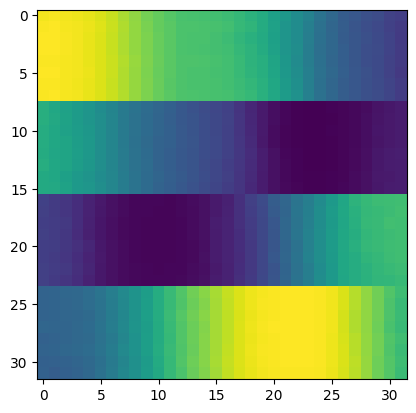

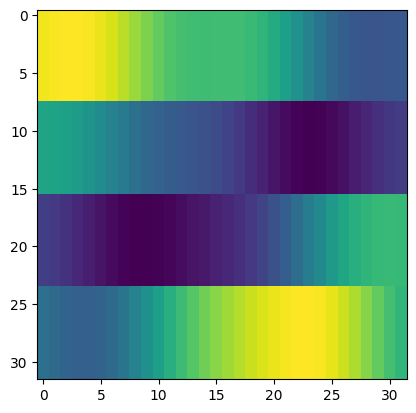

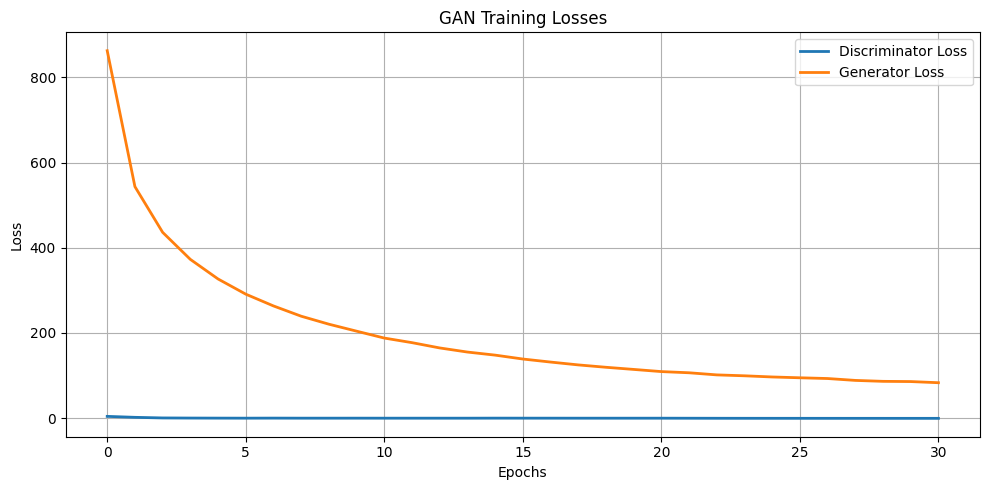

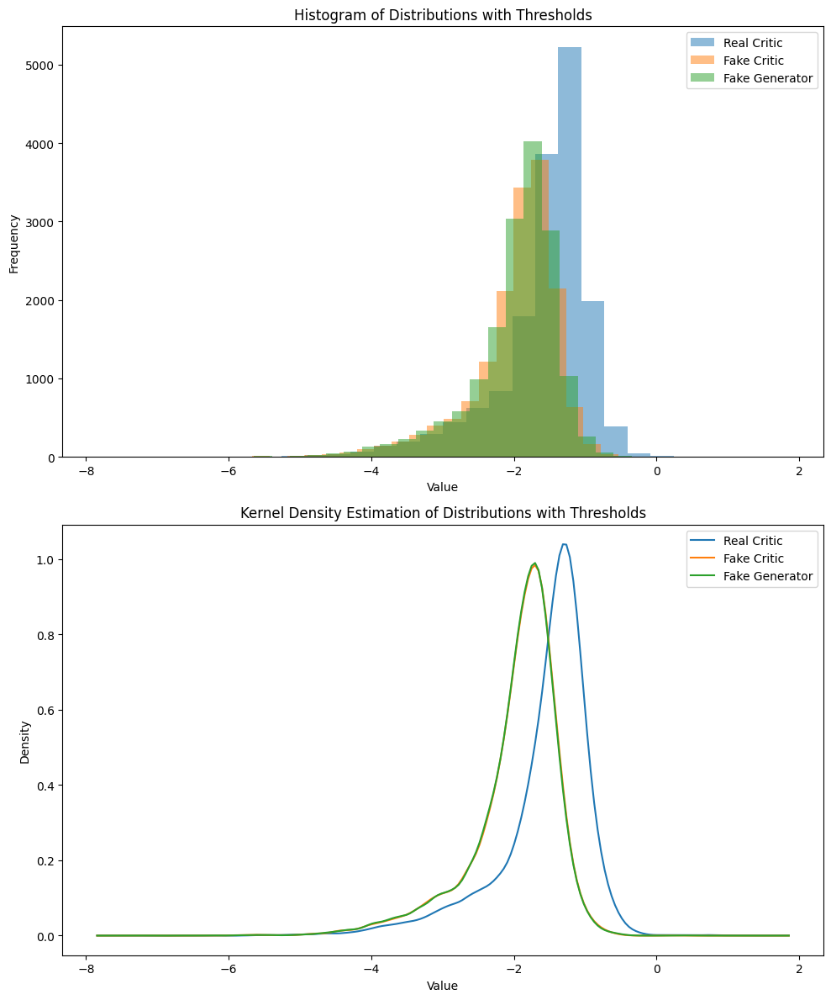

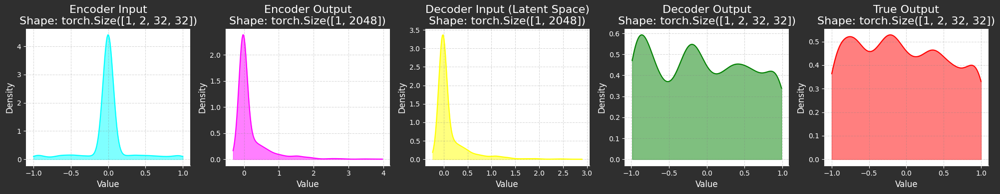

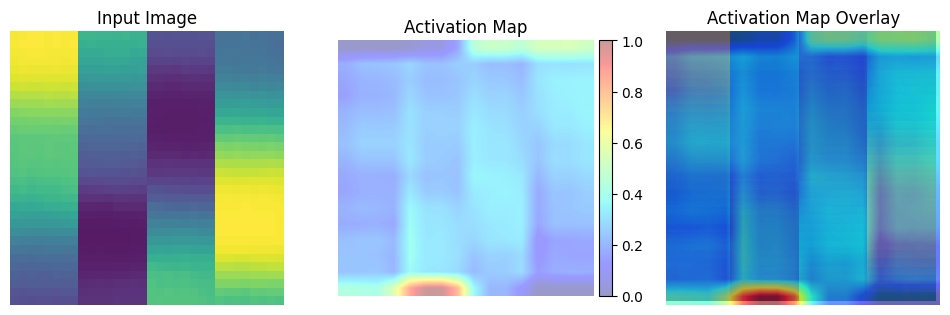

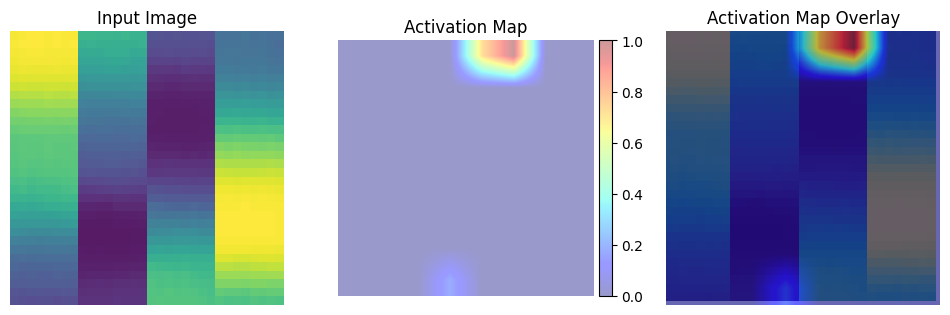

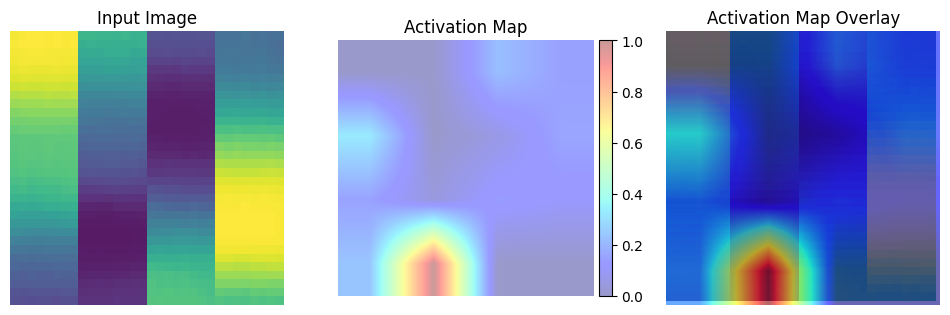

Batch [0/63] -  Critic loss:  -0.4223528703053792 - generator loss:  82.3434066772461
Batch [21/63] -  Critic loss:  -0.3799303015976241 - generator loss:  80.94170206243342
Batch [42/63] -  Critic loss:  -0.37221063592637244 - generator loss:  80.73395680272301
	Epoch 31 - critic loss: -0.37091535298281886 - generator loss: 80.69307902502635
	MNSE Score: 0.009229105882464892
Batch [0/63] -  Critic loss:  -0.3535349170366923 - generator loss:  82.44514465332031
Batch [21/63] -  Critic loss:  -0.37459621149482153 - generator loss:  78.51476738669656
Batch [42/63] -  Critic loss:  -0.3741246898506963 - generator loss:  78.8176418570585
	Epoch 32 - critic loss: -0.37603230656139436 - generator loss: 78.81341928149027
	MNSE Score: 0.00896348153787946
Batch [0/63] -  Critic loss:  -0.3357132474581401 - generator loss:  80.25131225585938
Batch [21/63] -  Critic loss:  -0.3782241245110829 - generator loss:  79.33239538019353
Batch [42/63] -  Critic loss:  -0.3753120067507721 - generator loss:

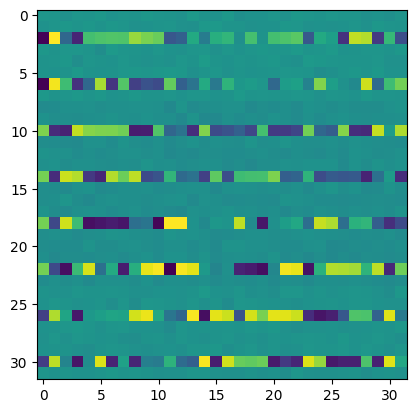

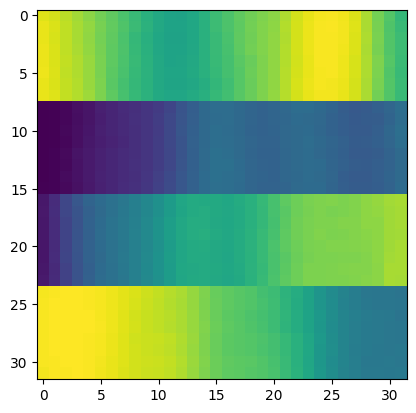

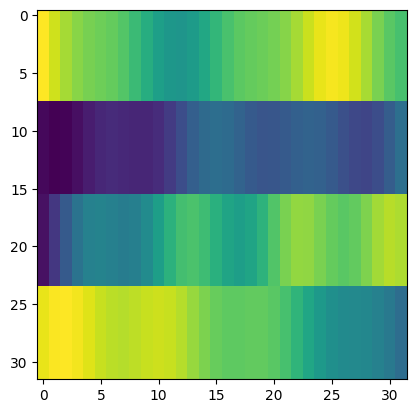

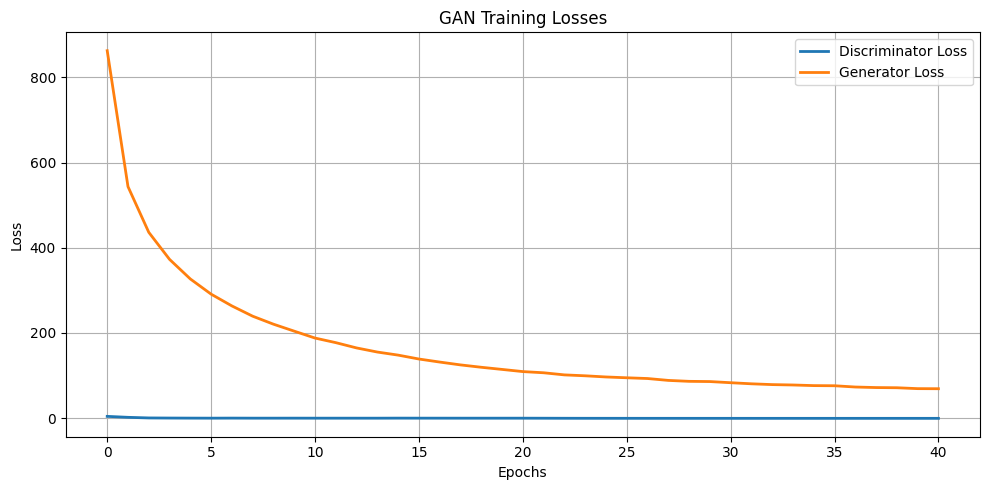

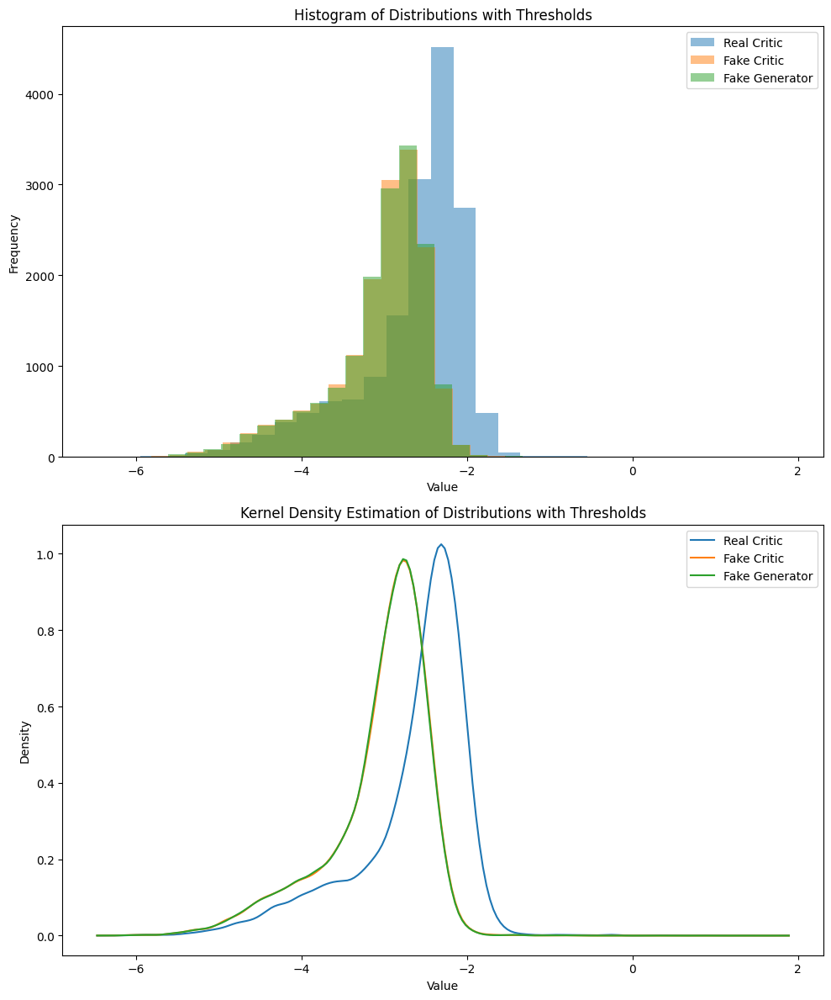

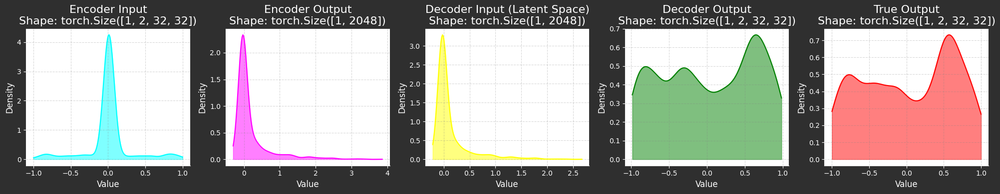

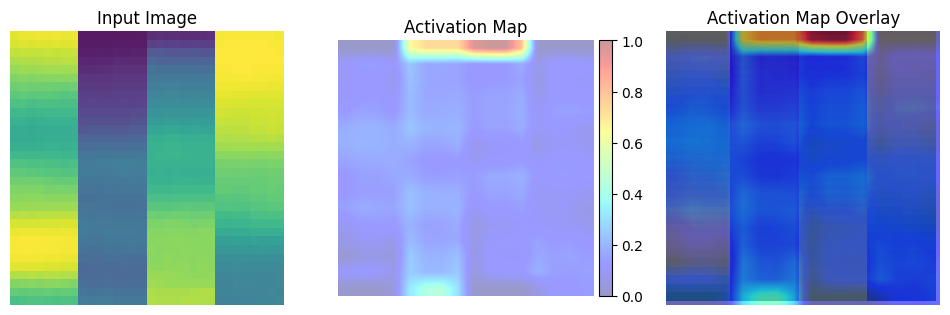

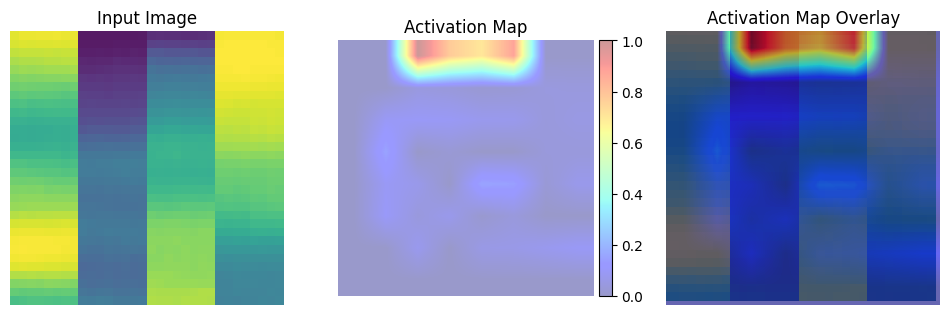

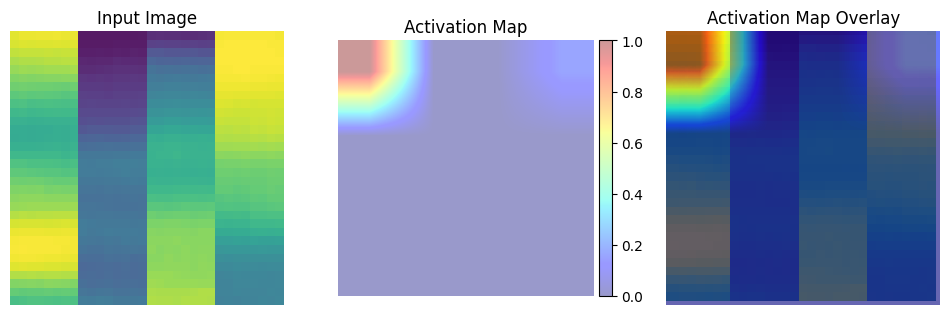

Batch [0/63] -  Critic loss:  -0.3400421937306722 - generator loss:  62.583351135253906
Batch [21/63] -  Critic loss:  -0.3679686897631848 - generator loss:  67.21647678722034
Batch [42/63] -  Critic loss:  -0.3702159461586974 - generator loss:  68.10290074902912
	Epoch 41 - critic loss: -0.3737042221442731 - generator loss: 68.12384650820778
	MNSE Score: 0.0075111534402129195
Batch [0/63] -  Critic loss:  -0.35871919989585876 - generator loss:  62.16069793701172
Batch [21/63] -  Critic loss:  -0.37478157471526746 - generator loss:  66.50771609219638
Batch [42/63] -  Critic loss:  -0.36966665354810024 - generator loss:  66.56574098453966
	Epoch 42 - critic loss: -0.3713504583747299 - generator loss: 66.81139846075149
	MNSE Score: 0.007378671680473619
Batch [0/63] -  Critic loss:  -0.38514132301012677 - generator loss:  62.39402770996094
Batch [21/63] -  Critic loss:  -0.3765795718539845 - generator loss:  66.85034145008434
Batch [42/63] -  Critic loss:  -0.37374087914015897 - generator

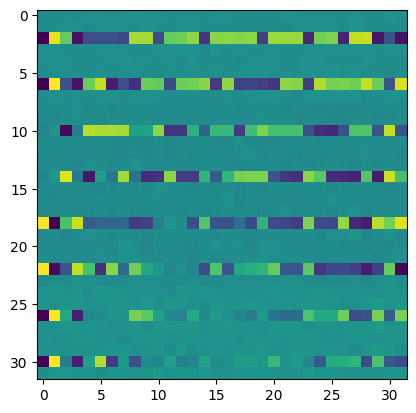

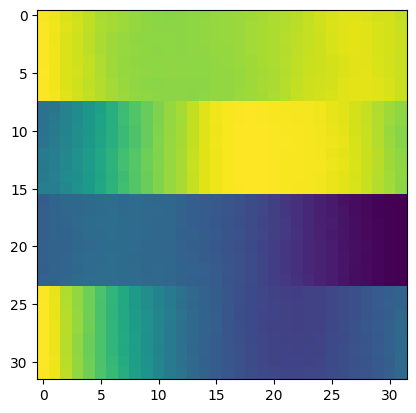

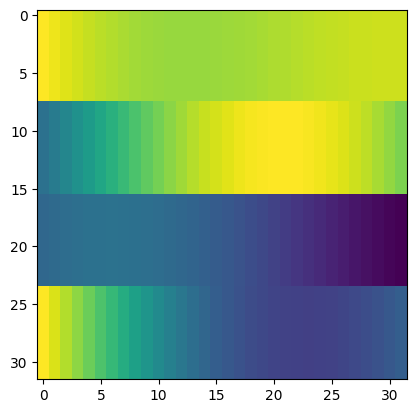

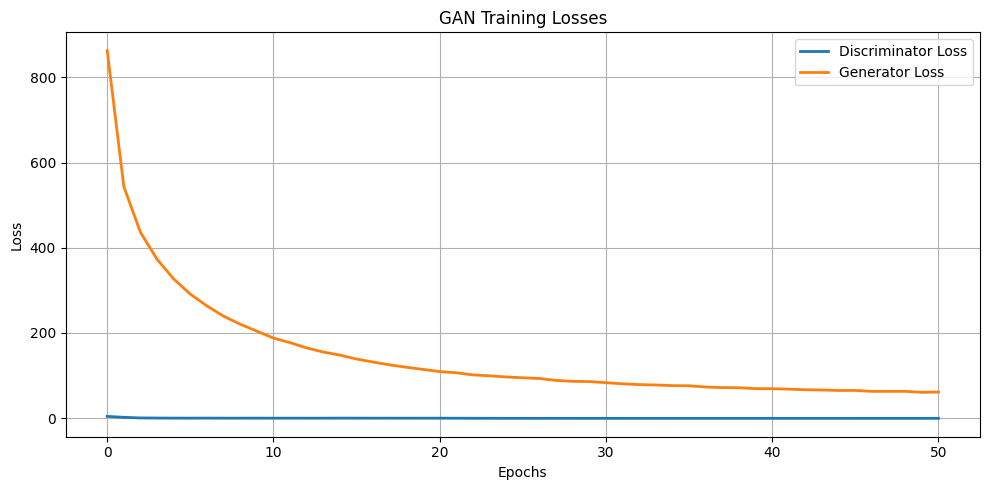

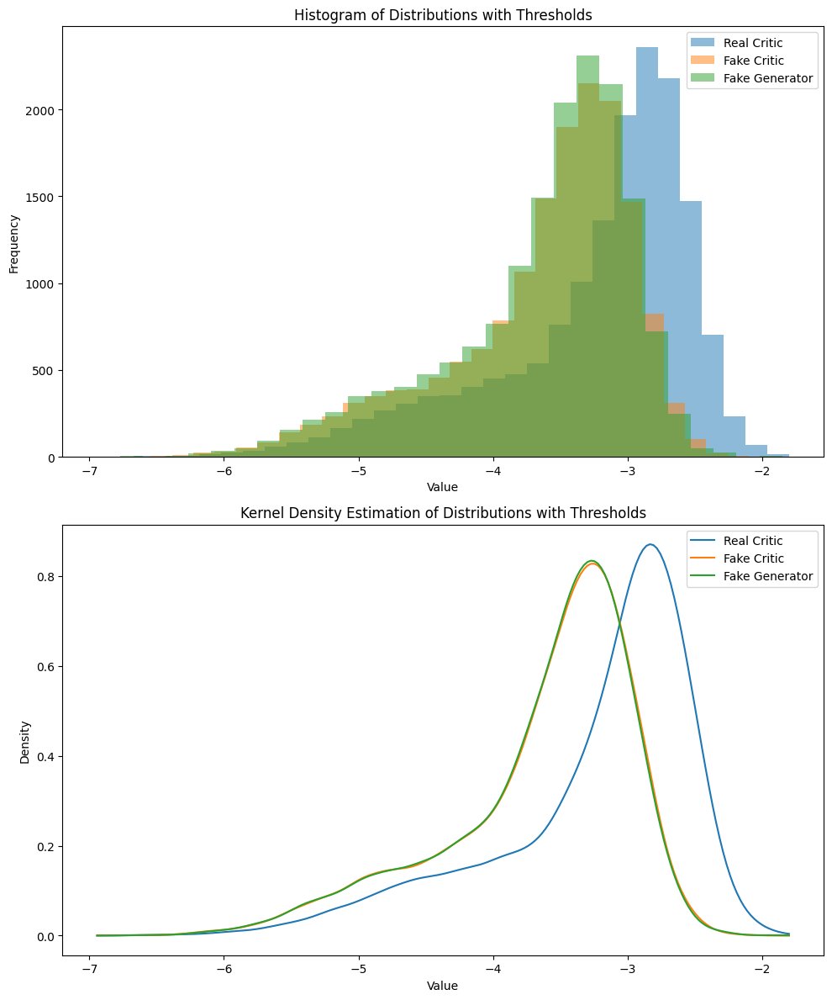

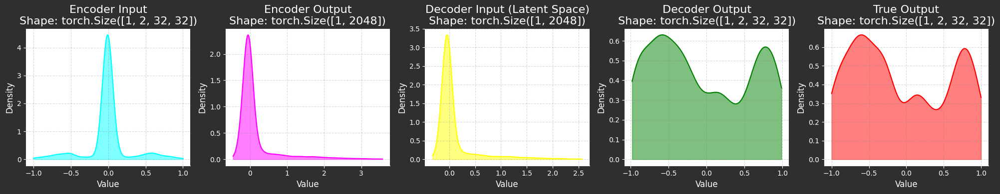

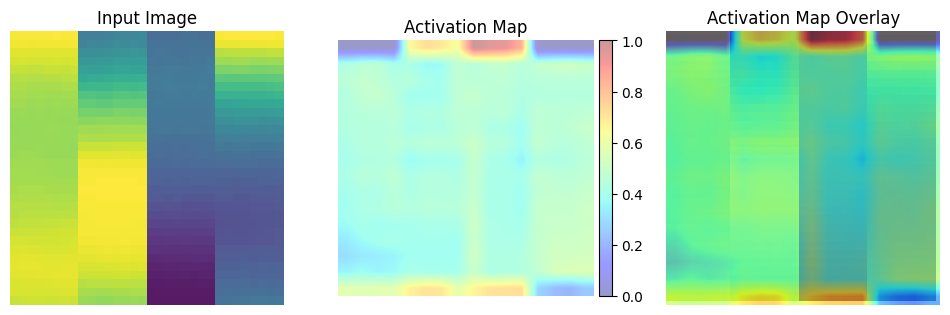

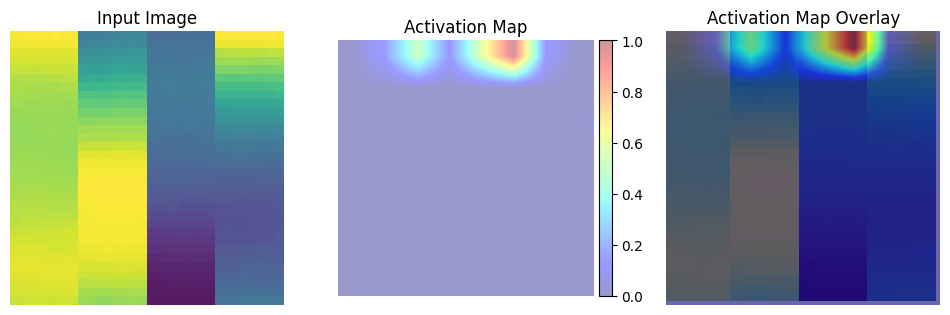

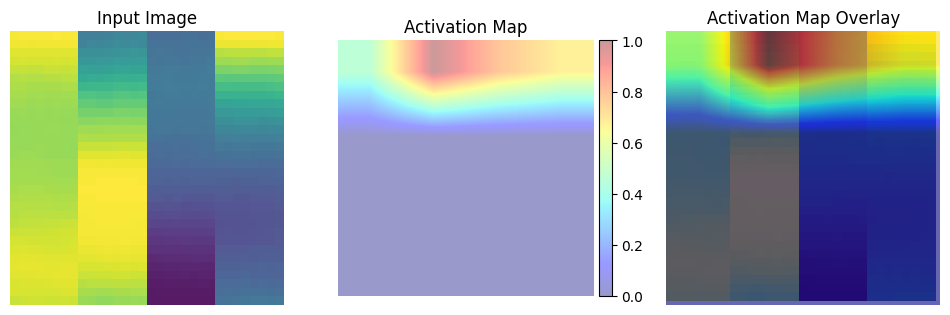

Batch [0/63] -  Critic loss:  -0.3093092044194539 - generator loss:  56.811500549316406
Batch [21/63] -  Critic loss:  -0.35018202165762574 - generator loss:  58.459961977871984
Batch [42/63] -  Critic loss:  -0.35581495133481283 - generator loss:  59.31835281017215
	Epoch 51 - critic loss: -0.3588686509737893 - generator loss: 58.77157120477585
	MNSE Score: 0.00623172369327337
Batch [0/63] -  Critic loss:  -0.3303518493970235 - generator loss:  52.884666442871094
Batch [21/63] -  Critic loss:  -0.3573501457770665 - generator loss:  58.28480356389826
Batch [42/63] -  Critic loss:  -0.3568865377311559 - generator loss:  58.81494459995004
	Epoch 52 - critic loss: -0.358529282467706 - generator loss: 58.92595042879619
Batch [0/63] -  Critic loss:  -0.31362024943033856 - generator loss:  55.598899841308594
Batch [21/63] -  Critic loss:  -0.3530546282276963 - generator loss:  57.100130254572086
Batch [42/63] -  Critic loss:  -0.35029717956402506 - generator loss:  56.98422037168991
	Epoch 5

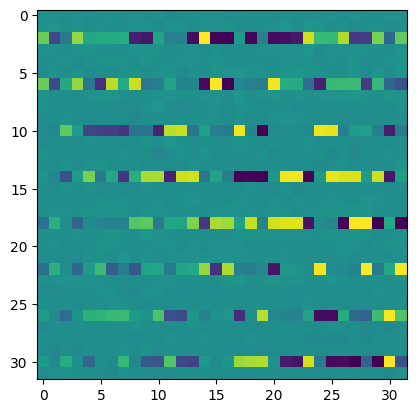

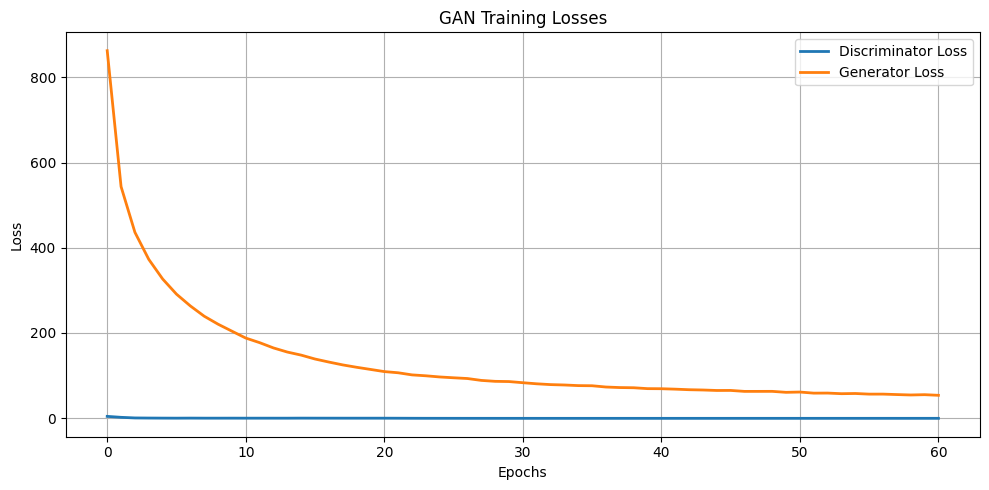

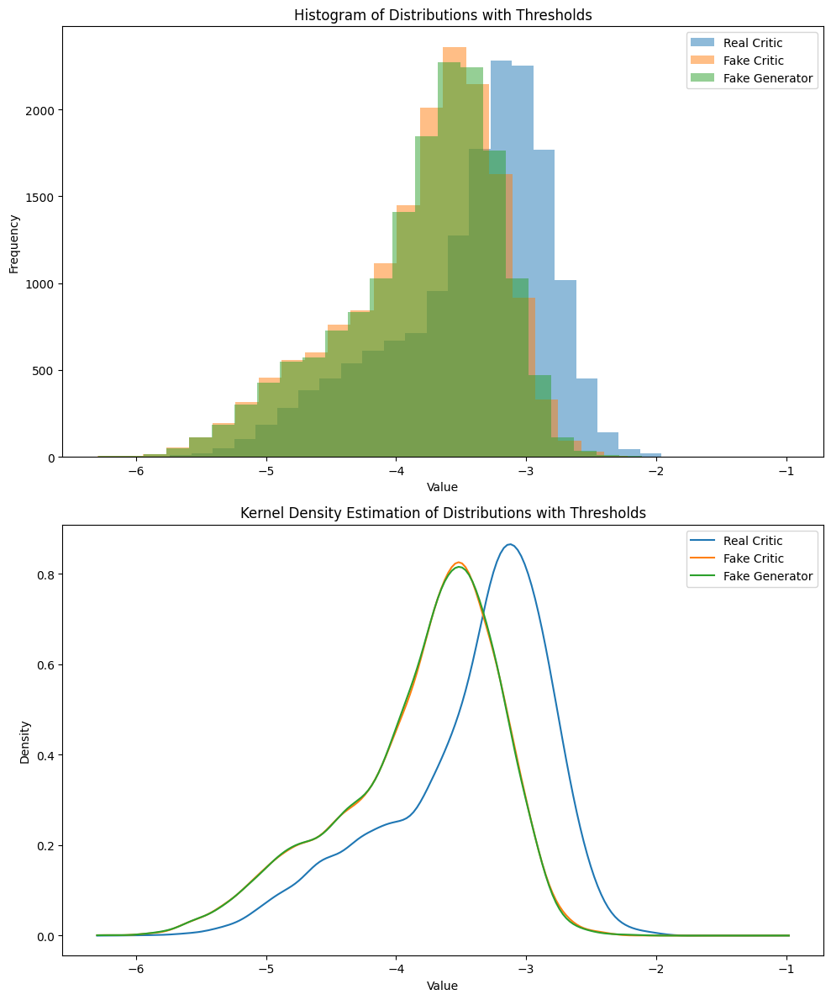

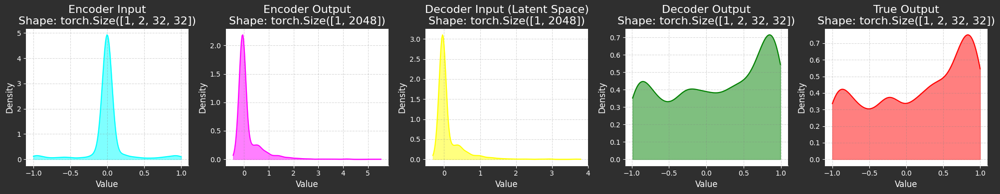

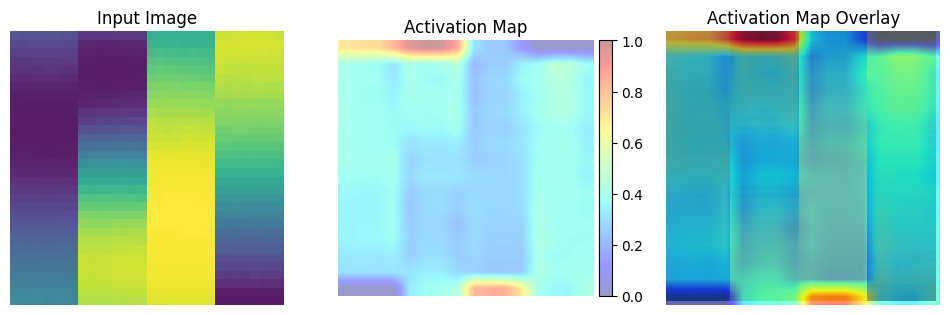

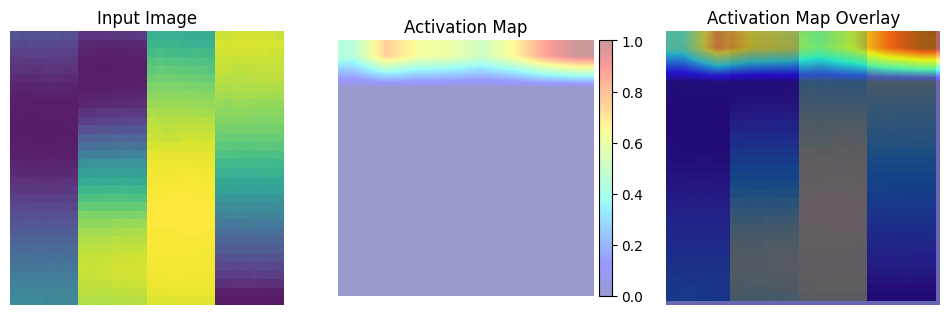

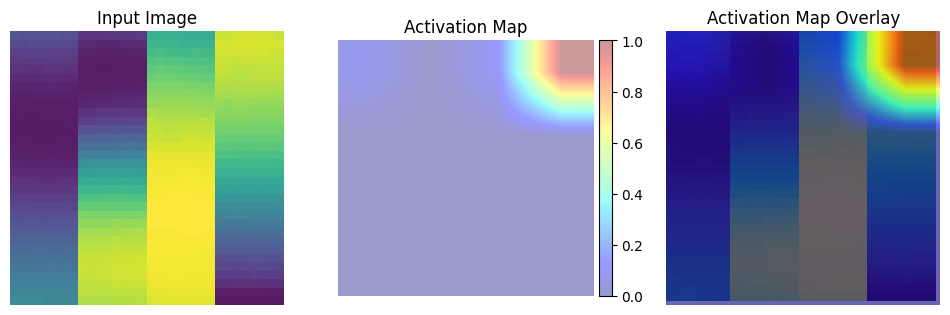

	MNSE Score: 0.005663199756767542
Batch [0/63] -  Critic loss:  -0.33659611145655316 - generator loss:  50.494346618652344
Batch [21/63] -  Critic loss:  -0.349888161276326 - generator loss:  54.620645176280625
Batch [42/63] -  Critic loss:  -0.3452804548333782 - generator loss:  54.218796042508856
	Epoch 61 - critic loss: -0.3456919688396354 - generator loss: 53.47349403018043
	MNSE Score: 0.005592322076803872
Batch [0/63] -  Critic loss:  -0.3506319224834442 - generator loss:  49.81633758544922
Batch [21/63] -  Critic loss:  -0.34224913111238764 - generator loss:  53.381492614746094
Batch [42/63] -  Critic loss:  -0.34301575140435575 - generator loss:  53.10243411396825
	Epoch 62 - critic loss: -0.34491935940015894 - generator loss: 52.8647081284296
	MNSE Score: 0.005510042731960614
Batch [0/63] -  Critic loss:  -0.3869817356268565 - generator loss:  55.82870864868164
Batch [21/63] -  Critic loss:  -0.34843406803680194 - generator loss:  52.46475687893954
Batch [42/63] -  Critic loss

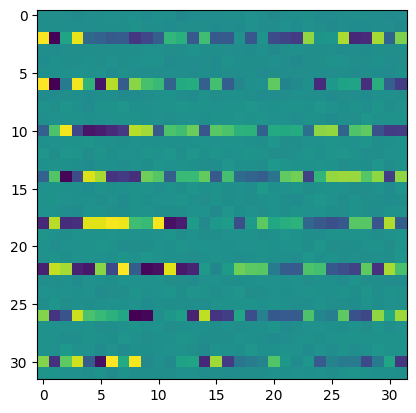

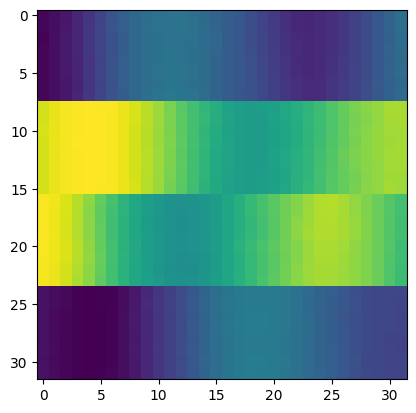

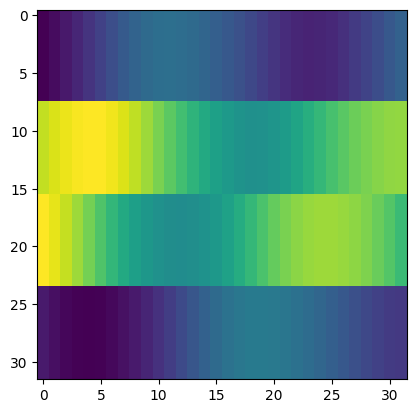

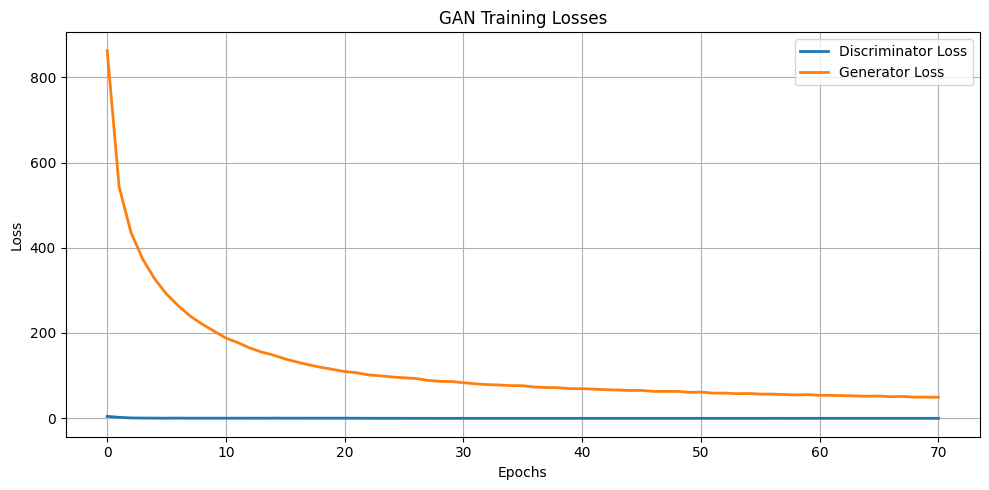

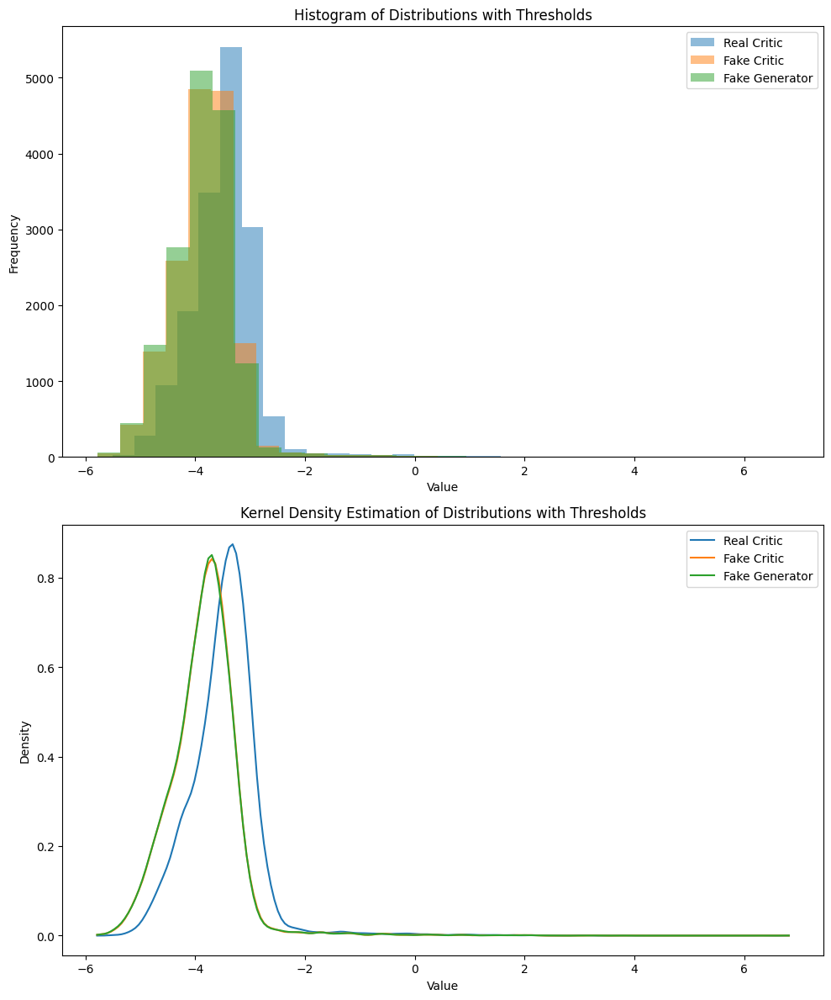

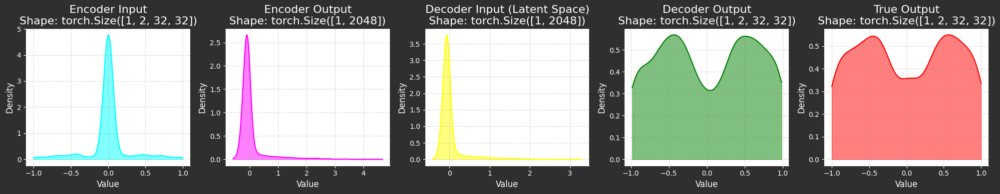

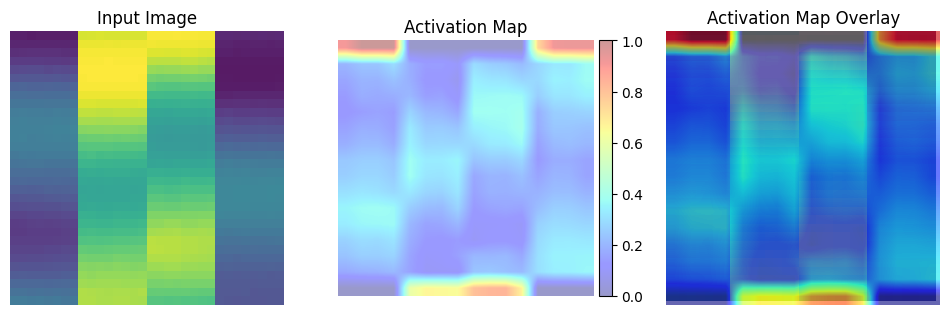

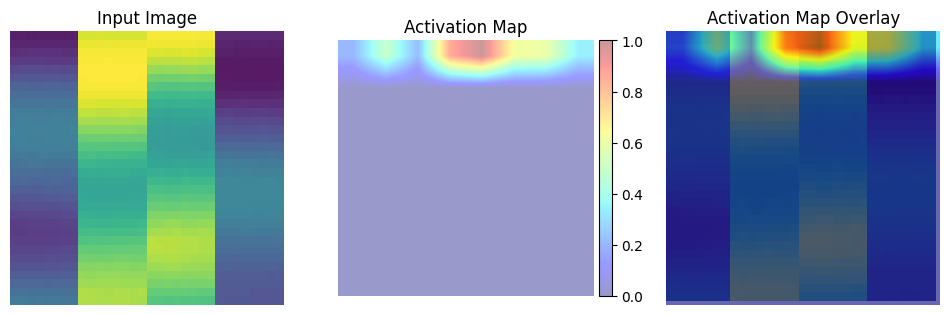

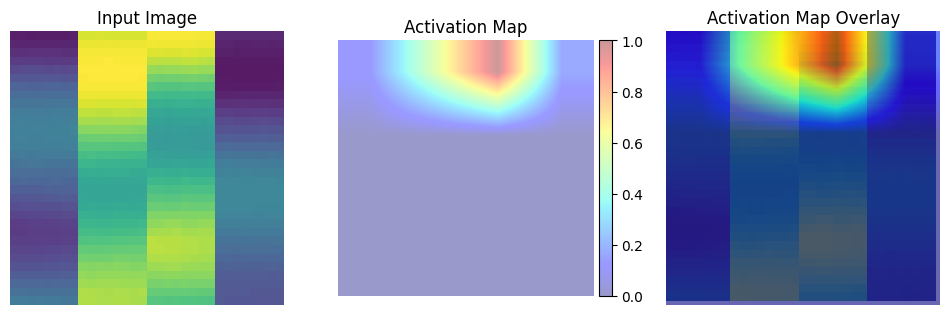

	MNSE Score: 0.004899961851714622
Batch [0/63] -  Critic loss:  -0.27093478043874103 - generator loss:  51.77640914916992
Batch [21/63] -  Critic loss:  -0.32594130188226705 - generator loss:  49.68412624705922
Batch [42/63] -  Critic loss:  -0.3325185051491095 - generator loss:  48.6086022133051
	Epoch 71 - critic loss: -0.33672807101534796 - generator loss: 48.5554331824893
	MNSE Score: 0.004887756255884019
Batch [0/63] -  Critic loss:  -0.3108879228432973 - generator loss:  44.299171447753906
Batch [21/63] -  Critic loss:  -0.33172439761234057 - generator loss:  48.14747463573109
Batch [42/63] -  Critic loss:  -0.3331935743028805 - generator loss:  48.758426577545876
	Epoch 72 - critic loss: -0.3344105833737309 - generator loss: 48.55326352800642
Batch [0/63] -  Critic loss:  -0.32154261072476703 - generator loss:  53.660865783691406
Batch [21/63] -  Critic loss:  -0.32883853916869016 - generator loss:  49.47647285461426
Batch [42/63] -  Critic loss:  -0.3337828754916672 - generator

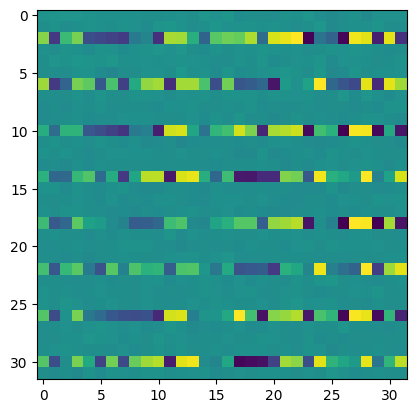

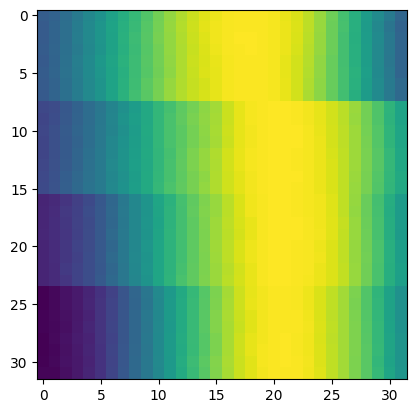

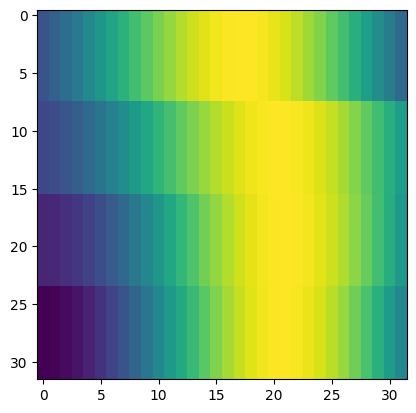

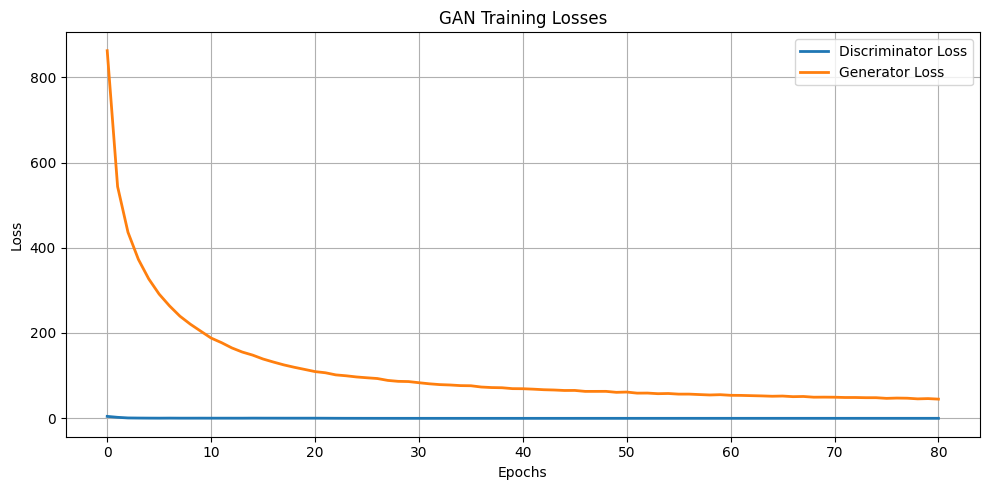

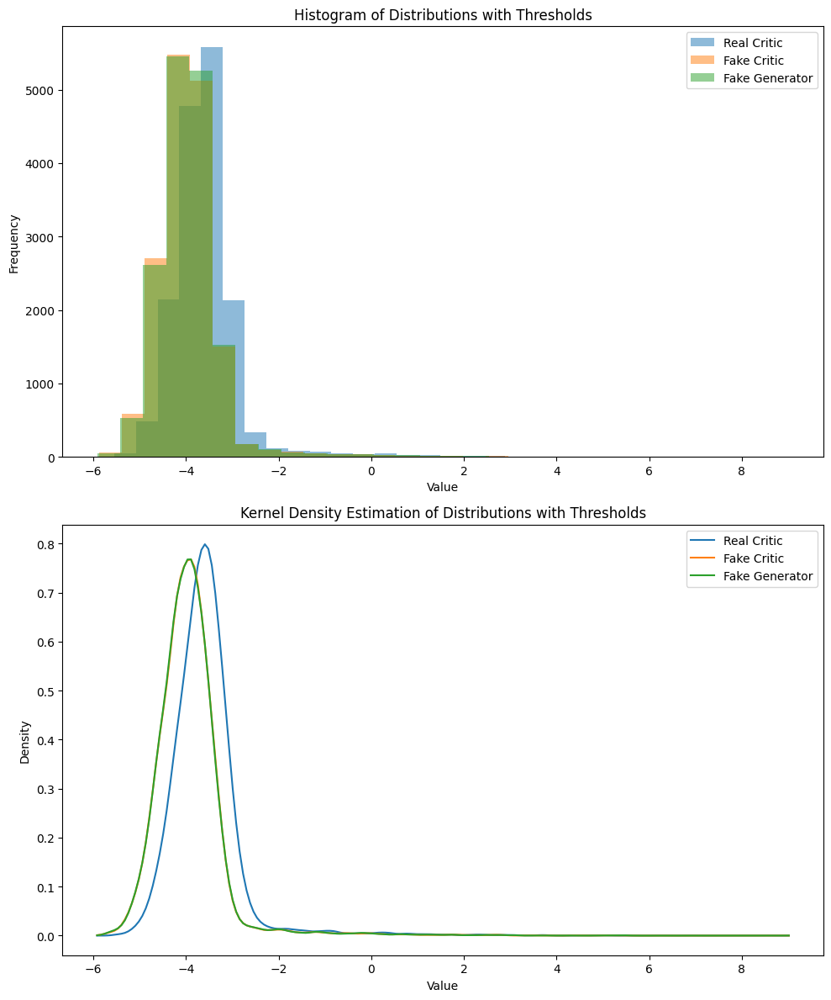

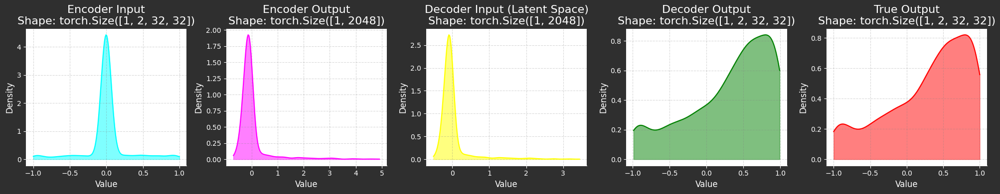

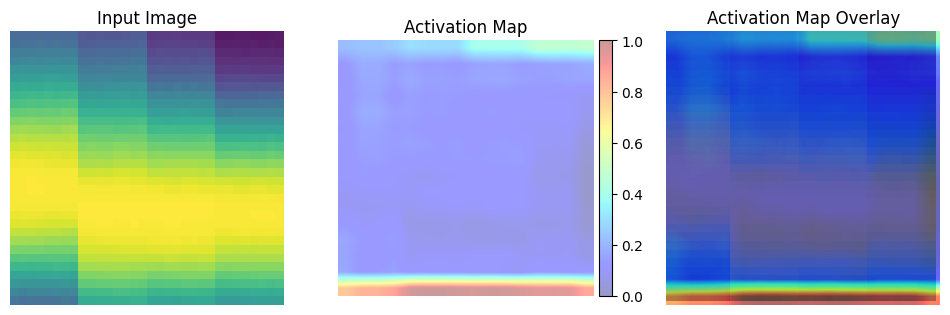

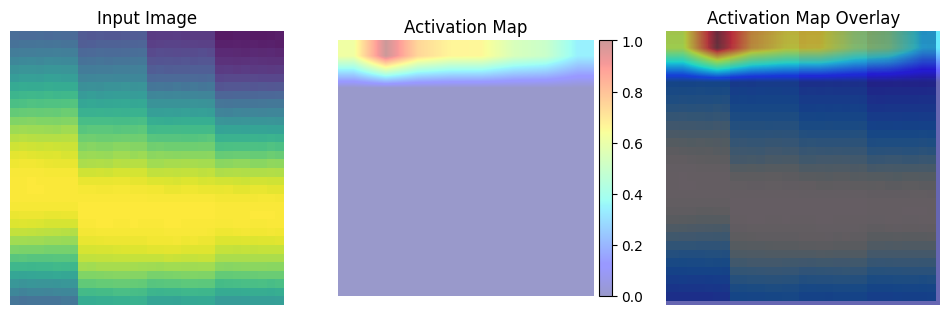

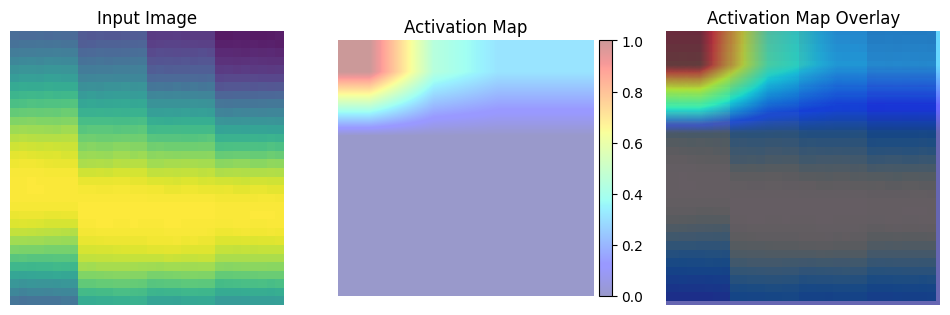

	MNSE Score: 0.004286179566637628
Batch [0/63] -  Critic loss:  -0.35106773177782696 - generator loss:  42.66054916381836
Batch [21/63] -  Critic loss:  -0.3241220789425301 - generator loss:  45.78599600358443
Batch [42/63] -  Critic loss:  -0.323649993238523 - generator loss:  45.806293842404386
	Epoch 81 - critic loss: -0.3231700063540191 - generator loss: 45.44599357483879
Batch [0/63] -  Critic loss:  -0.32883938153584796 - generator loss:  45.49885940551758
Batch [21/63] -  Critic loss:  -0.319885472230839 - generator loss:  44.87682429226962
Batch [42/63] -  Critic loss:  -0.3204957245625267 - generator loss:  45.32747889673987
	Epoch 82 - critic loss: -0.3208146428778058 - generator loss: 45.291936965215776
Batch [0/63] -  Critic loss:  -0.29555044571558636 - generator loss:  41.44395065307617
Batch [21/63] -  Critic loss:  -0.3214125734838572 - generator loss:  43.708402113481
Batch [42/63] -  Critic loss:  -0.32203334650790044 - generator loss:  43.81385519338209
	Epoch 83 - c

In [258]:
channel_est_wgan_gp_vae_threwness()

### Inference

#### Test set

In [259]:
def plot_vae_results(labels, reals, fakes, mses, num_samples=8):
    fig, axes = plt.subplots(num_samples, 3, figsize=(15, 4*num_samples))
    fig.suptitle("VAE Results: Label, Real, and Fake", fontsize=16)

    for i in range(num_samples):
        for j, (title, img) in enumerate(zip(['Label', 'Real', 'Fake'], [labels[i], reals[i], fakes[i]])):
            axes[i, j].imshow(img.squeeze().detach().cpu().numpy(), cmap='viridis')
            axes[i, j].set_title(f"{title} (Sample {i+1})")
            axes[i, j].axis('off')

        # Add MSE text to the right of the fake image
        axes[i, 2].text(1.05, 0.5, f'MSE: {mses[i]:.4f}',
                        transform=axes[i, 2].transAxes,
                        verticalalignment='center')

/tmp/ipykernel_29/4061246166.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(
/tmp/ipykernel_29/3193178299.py:57: UserWarning: std(): degrees of 

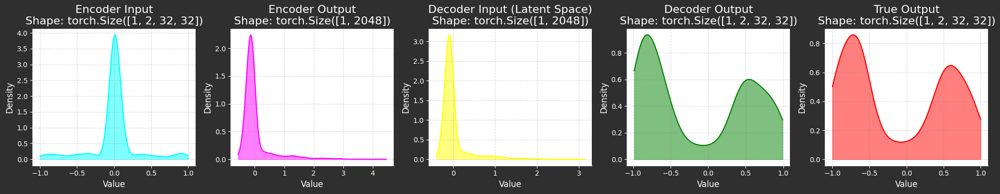

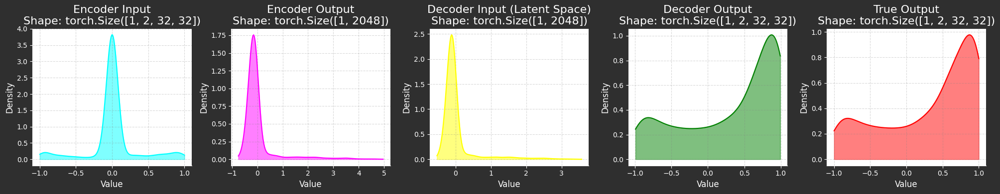

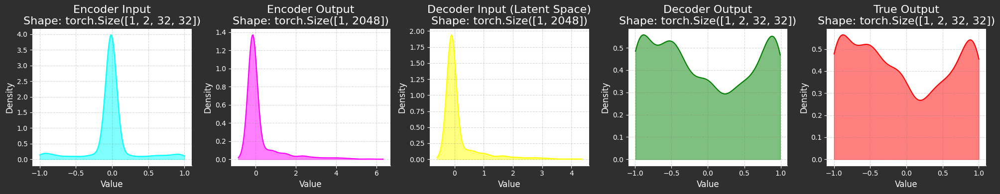

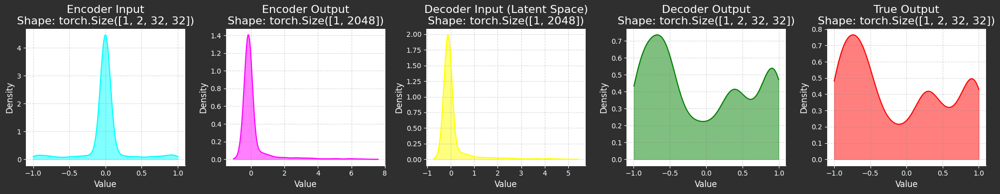

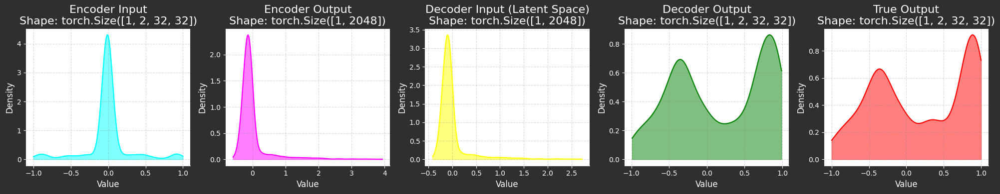

...

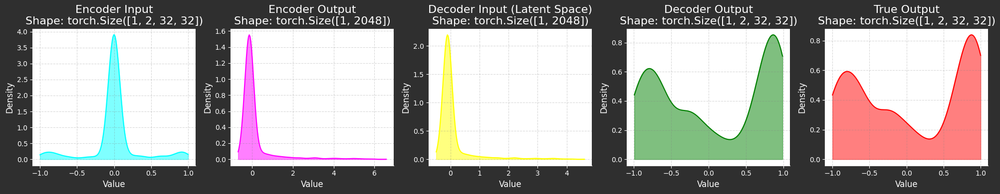

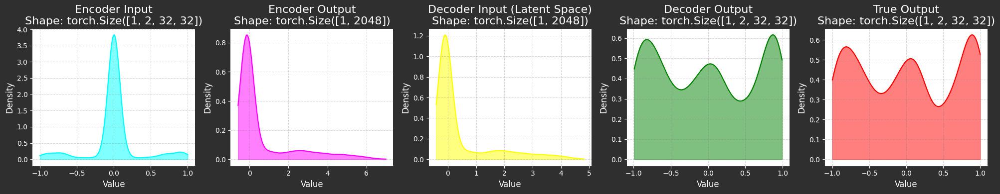

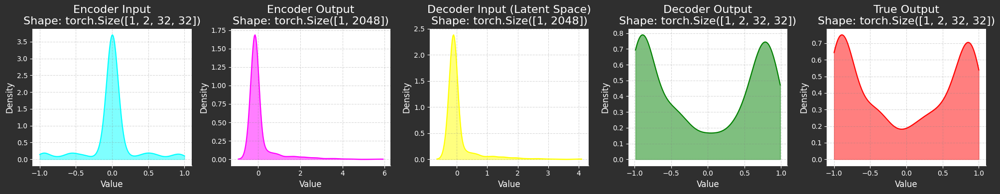

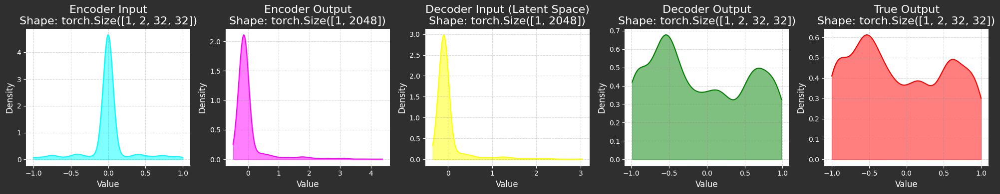

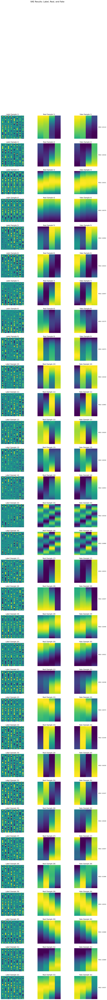

In [260]:
num_samples = 32
labels, reals, fakes, nmses = [], [], [], []

vae = VAE(z_dim=z_dim, mu_h=MU_H, std_h=STD_H).to(device)
checkpoint = torch.load(
    f"/kaggle/working/results/checkpoint/{save_results}/g_model.pt",
    map_location=device,
)
vae.load_state_dict(checkpoint["state_dict"])

vae = vae.to(device)
vae.eval()

dataloader = ChannelDataloader(
    y_res=responses, channels_res=channels, batch_size=1
)
test_dataset = dataloader.test_dataloader()

for i, (real, label) in enumerate(test_dataset):
    real = real.to(device)
    label = label.to(device)
    fake, *values = vae(label)
    _, _, (input_decoder, output_encoder) = values

    if i >= num_samples:
        break

    labels.append(label[0])
    reals.append(real[0])
    fakes.append(fake[0])
    nmses.append(nmse_func(fake, real))

    plot_vae_in_out(label, fake, input_decoder, output_encoder, real)


# Convert lists to tensors
labels = torch.cat(labels, dim=0)
reals = torch.cat(reals, dim=0)
fakes = torch.cat(fakes, dim=0)


plot_vae_results(labels, reals, fakes, nmses, num_samples)



#### Training sets

/tmp/ipykernel_29/1813131043.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(
/tmp/ipykernel_29/3193178299.py:57: UserWarning: std(): degrees of 

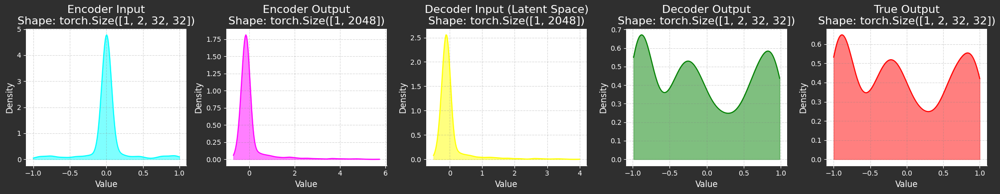

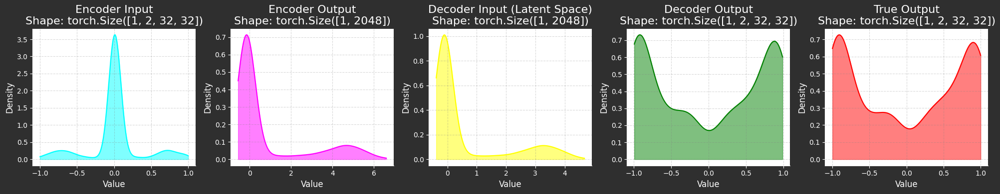

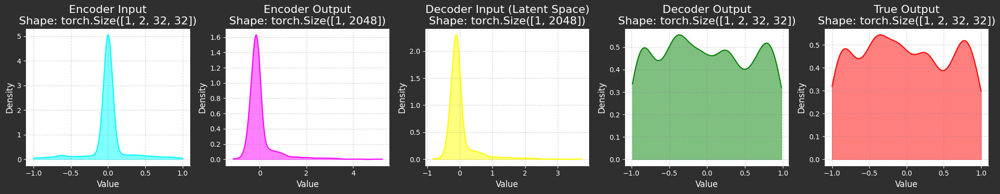

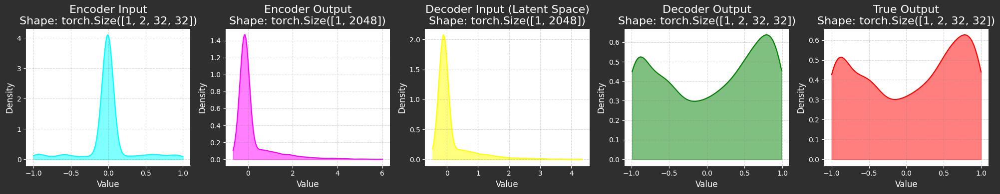

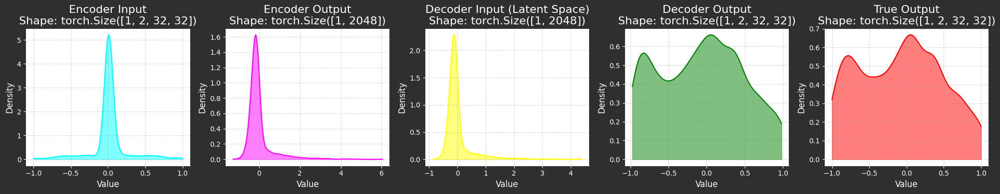

...

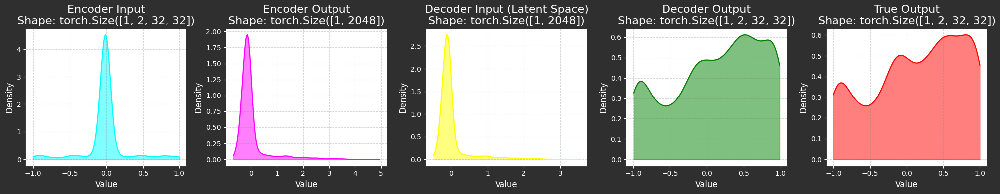

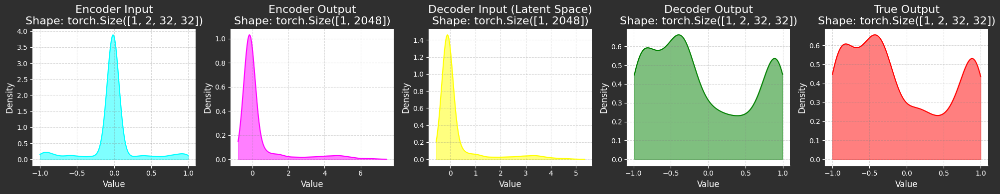

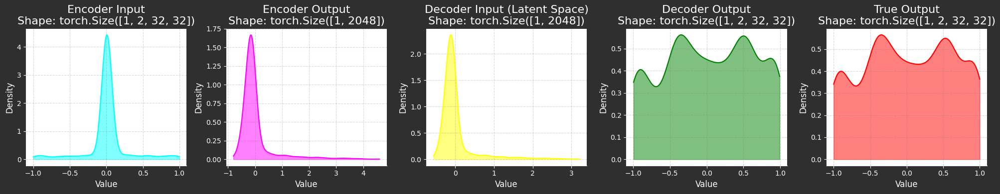

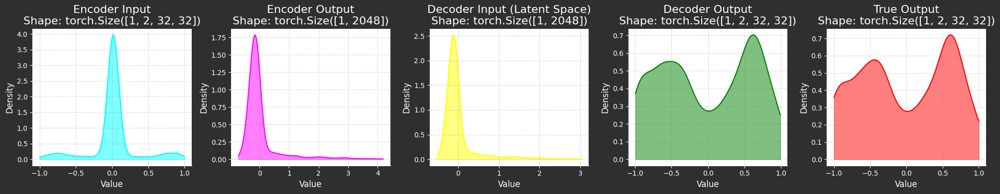

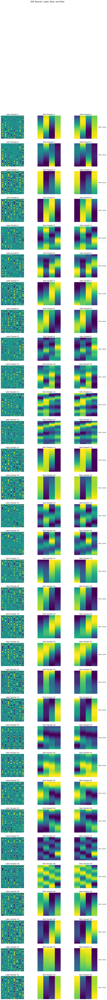

In [261]:
num_samples = 32
labels, reals, fakes, nmses = [], [], [], []

vae = VAE(z_dim=z_dim, mu_h=MU_H, std_h=STD_H).to(device)
checkpoint = torch.load(
    f"/kaggle/working/results/checkpoint/{save_results}/g_model.pt",
    map_location=device,
)
vae.load_state_dict(checkpoint["state_dict"])

vae = vae.to(device)
vae.eval()

dataloader = ChannelDataloader(
    y_res=responses, channels_res=channels, batch_size=1
)
train_dataset = dataloader.train_dataloader()

for i, (real, label) in enumerate(train_dataset):
    real = real.to(device)
    label = label.to(device)
    fake, *values = vae(label)
    _, _, (input_decoder, output_encoder) = values

    if i >= num_samples:
        break

    labels.append(label[0])
    reals.append(real[0])
    fakes.append(fake[0])
    nmses.append(nmse_func(fake, real))

    plot_vae_in_out(label, fake, input_decoder, output_encoder, real)

# Convert lists to tensors
labels = torch.cat(labels, dim=0)
reals = torch.cat(reals, dim=0)
fakes = torch.cat(fakes, dim=0)

plot_vae_results(labels, reals, fakes, nmses, num_samples)
